# GUC Clustering Project 

In [1]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs

#from plotnine import *   

# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.cluster import DBSCAN



from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture

from sklearn.metrics import silhouette_score

%matplotlib inline

import matplotlib.pyplot as plt
from sklearn.datasets import make_blobs

In [2]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = 'brgcmyk'  #List colors
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

# Multi Blob Data Set 

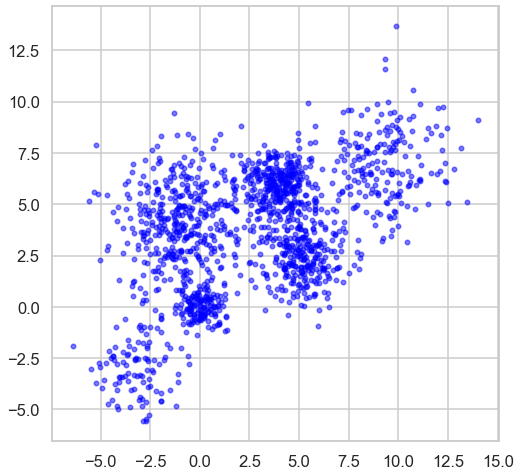

In [3]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

# Methods:

# K-means methods

In [25]:
#plot scatter
from scipy.spatial.distance import cdist
def draw_scatter(df, col_name1,col_name2, t):
    
    ax1 = plt.scatter(x=df[col_name1],y=df[col_name2], s= [15,25], c= 'red')
    plt.title(t)


In [6]:
#elbow method
def elbow_draw(x, title):
    distortions = []
    inertias = []
    mapping1 = {}
    mapping2 = {}
    k = range(1, 10)

    for i in k:
        kmeanModel = KMeans(n_clusters=i).fit(x)
        kmeanModel.fit(x)
        distortions.append(sum(np.min(cdist(x, kmeanModel.cluster_centers_,
                                            'euclidean'), axis=1)) / x.shape[0])
        inertias.append(kmeanModel.inertia_)

        mapping1[i] = sum(np.min(cdist(x, kmeanModel.cluster_centers_,
                                       'euclidean'), axis=1)) / x.shape[0]
        mapping2[i] = kmeanModel.inertia_
    plt.plot(k, distortions, 'bx-')
    plt.xlabel('Values of K')
    plt.ylabel('Distortion')
    plt.title(title)
    plt.show()

In [29]:
#kmeans drawing
k_variants = [4,5,6,7,8,9,10]
def draw_kmeans(K,array, t, t2):
    kmeans = KMeans(n_clusters= K)
    kmeans.fit(array)
    
    km = KMeans(n_clusters=K, random_state=42)
    km.fit_predict(array)
    score = silhouette_score(array, km.labels_, metric='euclidean')
    print(t2)
    print(score)
    
    #plt.scatter(data_array[:,0],data_array[:,1], c=kmeans.labels_, cmap='rainbow', s= [13,13])
    
    plt.scatter(array[:,0], array[:,1], c=kmeans.labels_, cmap='rainbow', s= [13,13])
    plt.scatter(kmeans.cluster_centers_[:,0] ,kmeans.cluster_centers_[:,1], color='black', s= [13,13])
    plt.title(t)
    plt.show()

# DB- Scan methods

In [31]:
# distances
from sklearn.neighbors import NearestNeighbors

def draw_dbscan_dist(data_array, title):
    

    nearest_neighbors = NearestNeighbors(n_neighbors=11)
    neighbors = nearest_neighbors.fit(data_array)
    global distances
    distances, indices = neighbors.kneighbors(data_array)
    distances = np.sort(distances[:,10], axis=0)

    fig = plt.figure(figsize=(5, 5))
    plt.plot(distances)
    plt.xlabel("Points")
    plt.ylabel("Distance")
    plt.title(title)

In [9]:
# optimal eps
from kneed import KneeLocator

def db_optimal_eps(d, t):
    
    i = np.arange(len(distances))
    knee = KneeLocator(i, d, S=1, curve='convex', direction='increasing', interp_method='polynomial')

    fig = plt.figure(figsize=(5, 5))
    knee.plot_knee()
    plt.xlabel("Points")
    plt.ylabel("Distance")
    plt.title(t)

    print("optimal eps: {}".format(distances[knee.knee]))

In [35]:
# drawing db scan
def draw_dbscan(data_array, t , epss, min_pt):
    dbscan_cluster1 = DBSCAN(eps=epss, min_samples=min_pt)
    dbscan_cluster1.fit(data_array)

    # Visualizing DBSCAN
    plt.scatter(data_array[:, 0], 
                data_array[:, 1], 
                c=dbscan_cluster1.labels_, 
                label=y)
    plt.xlabel("$x_1$")
    plt.ylabel("$x_2$")
    plt.title(t)

    # Number of Clusters
    labels=dbscan_cluster1.labels_
    N_clus=len(set(labels))-(1 if -1 in labels else 0)
    print('Estimated no. of clusters {}: '.format(N_clus) )

    # Identify Noise
    n_noise = list(dbscan_cluster1.labels_).count(-1)
    print('Estimated no. of noise points: {}'.format(n_noise))
    print("total number of points: {} ".format(data_array.size))
    print("effeciency : {}". format((data_array.size-n_noise)/(data_array.size)*100))

# Heirarcial clustering

In [174]:
arr_aff = ["l1", "l2", "manhattan", "cosine"]
arr_link = [ "single", "average"]
clust = []
def draw_linkage_affinity(m,n, df_sepal, t):
    
    print(" Affinity = " + m + " , against linkage = " + n)
    ac2 = AgglomerativeClustering(affinity = m, linkage =n,  n_clusters = None, compute_full_tree=True, 
                                  distance_threshold = 0.5).fit(df_sepal)
    plt.figure(figsize =(10,10))
    plt.scatter(df_sepal[0], df_sepal[1], c = ac2.fit_predict(df_sepal), cmap ='rainbow')
    plt.title( t +  " ,number of clusters = {} ".format(ac2.n_clusters_))

    plt.show()

In [12]:
# drawing sh. bars
def draw_sh (k,data_frame):
    
    ac = AgglomerativeClustering(n_clusters = k)
    silhouette_scores.append(
    silhouette_score(data_frame, ac.fit_predict(data_frame)))

# Gaussian mixture

In [150]:
# drawing gaussian
k = ["full", "tied", "diag", "spherical"]
def draw_gaussian (k, data_frame, t):
    gmm = GaussianMixture(n_components = 6, covariance_type= k)
    gmm.fit(data_frame)
    labels = gmm.predict(data_frame)
    data_frame['labels']= labels
    d0 = data_frame[data_frame['labels']== 0]
    d1 = data_frame[data_frame['labels']== 1]
    d2 = data_frame[data_frame['labels']== 2]

    print("lower bound: {}".format(gmm.lower_bound_))
    print(i)
    # plot three clusters in same plot
    plt.scatter(d0[0], d0[1], c ='r', s=[15,15])
    plt.scatter(d1[0], d1[1], c ='yellow', s=[15,15])
    plt.scatter(d2[0], d2[1], c ='g', s=[15,15])
    plt.title(t + k + " ,lower bound= " + str(gmm.lower_bound_))
    plt.show()


In [179]:
from sklearn.mixture import GaussianMixture
import seaborn as sns
import plotly.express as px
k = ["full", "tied", "diag", "spherical"]
def draw3 (k, data_frame):
    gmm = GaussianMixture(n_components = 3, covariance_type= k)
    gmm.fit(data_frame)
    #todo
    probs = gmm.predict_proba(data_frame)
    #global probs_df 
    probs_df = pd.DataFrame(probs)
        
    
    labels = gmm.predict(data_frame)
    data_frame['labels']= labels
    d0 = data_frame[data_frame['labels']== 0]
    d1 = data_frame[data_frame['labels']== 1]
    d2 = data_frame[data_frame['labels']== 2]
    

    

    print("lower bound: {}".format(gmm.lower_bound_))
    print(i)
    # plot three clusters in same plot
    plt.scatter(d0[0], d0[1], c ='r', s=[15,15])
    plt.scatter(d1[0], d1[1], c ='yellow', s=[15,15])
    plt.scatter(d2[0], d2[1], c ='g', s=[15,15])
    plt.show()
    
        
    #s
    # Visualizing Resultant Distributions
    sns.kdeplot(data=probs_df).set(title=' Desnsity plot')
    plt.show()
    
    # 2D Contour plot of resultant Resultant Distributions
    fig = px.density_contour(probs_df)
    fig.update_traces(contours_coloring="fill",contours_showlabels = True) 
    fig.update_layout(title_text='2D Contour Plot ', title_x=0.5)
    fig.show()
    

# Multi-bob-data

# K-means clustering for multi blob data

In [13]:
blob_array = np.array(Multi_blob_Data)
blob_array

array([[-2.3542716 , -3.17974359],
       [-2.1580049 , -1.02006119],
       [-3.30439939, -3.30437804],
       ...,
       [ 9.86405669, 13.6746041 ],
       [ 5.457008  ,  9.9319843 ],
       [ 8.51133922,  7.48845914]])

In [19]:
blob_df = pd.DataFrame(blob_array)
blob_df.head()

,0,1
0,-2.354272,-3.179744
1,-2.158005,-1.020061
2,-3.304399,-3.304378
3,-0.947023,-2.002335
4,-3.610317,-2.294672


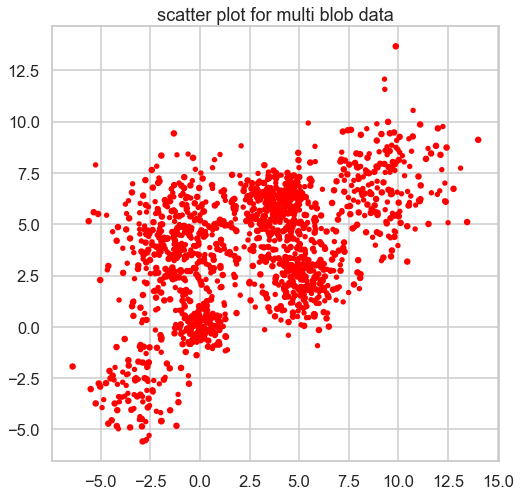

In [26]:
draw_scatter(blob_df, 0,1, "scatter plot for multi blob data")

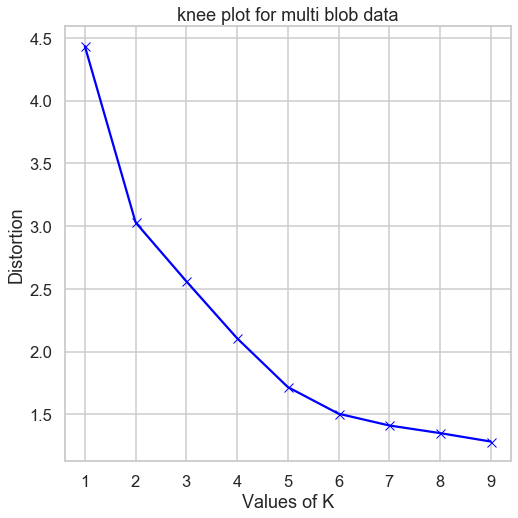

In [28]:
elbow_draw(blob_array, "knee plot for multi blob data")


silhouette score with clusters = 4
0.4628725400351352


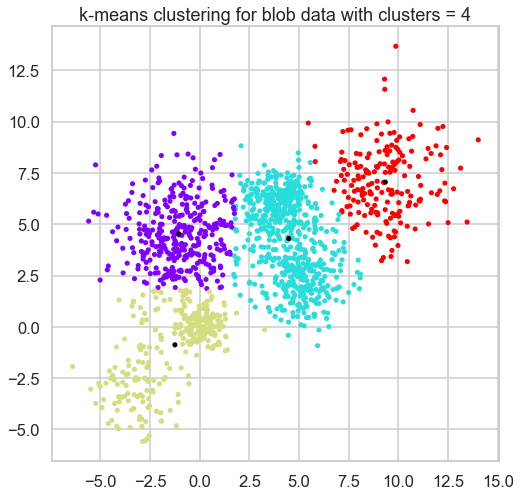

silhouette score with clusters = 5
0.48100602217073096


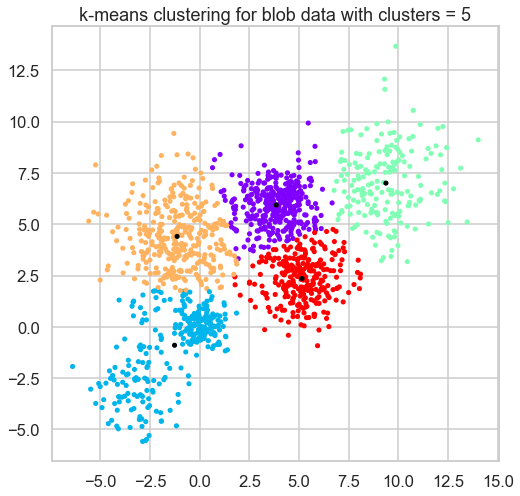

silhouette score with clusters = 6
0.48614459735646176


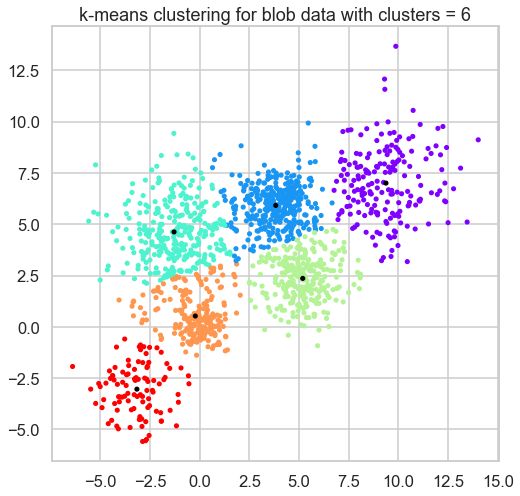

silhouette score with clusters = 7
0.4635574784262779


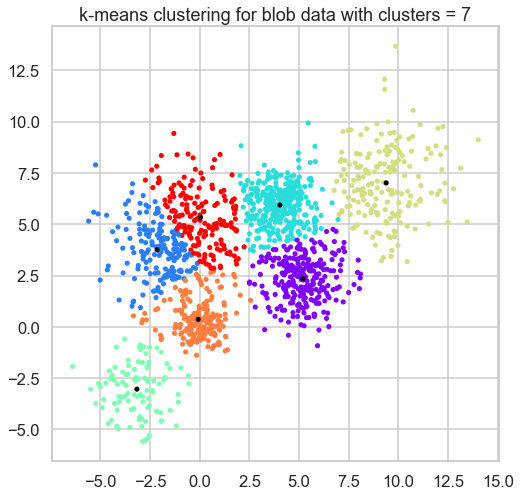

silhouette score with clusters = 8
0.44342826922624695


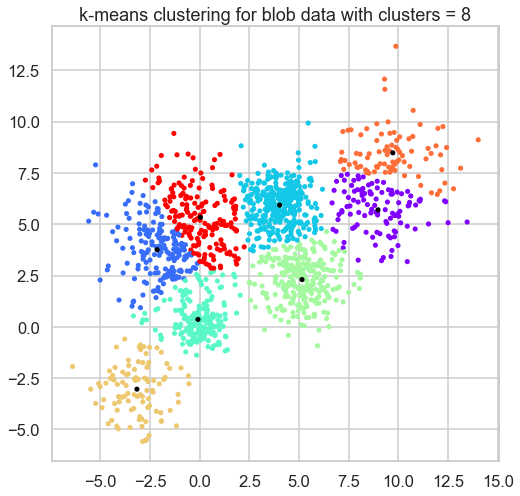

silhouette score with clusters = 9
0.44072492110350264


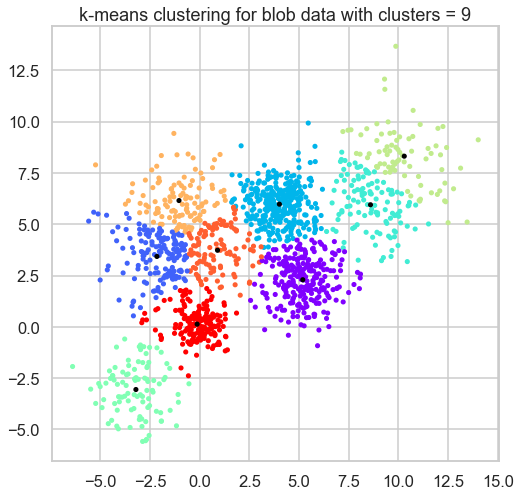

silhouette score with clusters = 10
0.3959155820588724


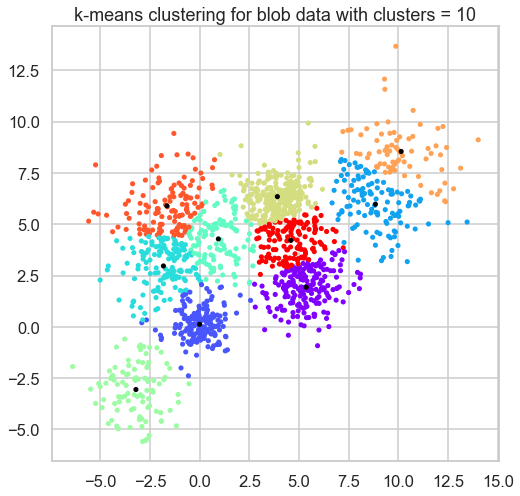

In [30]:
for i in k_variants:
    
    draw_kmeans(i, blob_array, "k-means clustering for blob data with clusters = {}".format(i),
                "silhouette score with clusters = {}".format(i))

# DB sacn for multi blob data

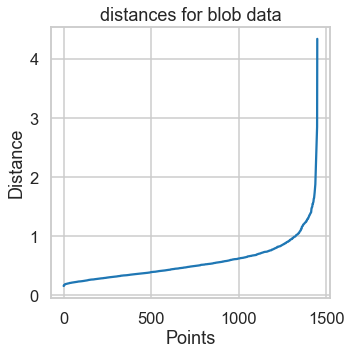

In [32]:
# distances gragh
draw_dbscan_dist(blob_array, "distances for blob data")
distances_df= distances

optimal eps: 0.8795662680174702


<Figure size 360x360 with 0 Axes>

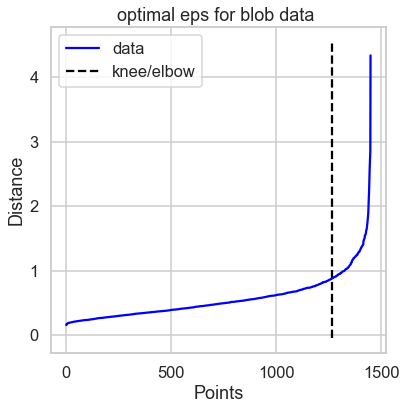

In [33]:
db_optimal_eps(distances_df, "optimal eps for blob data ")

Estimated no. of clusters 4: 
Estimated no. of noise points: 260
total number of points: 2900 
effeciency : 91.0344827586207


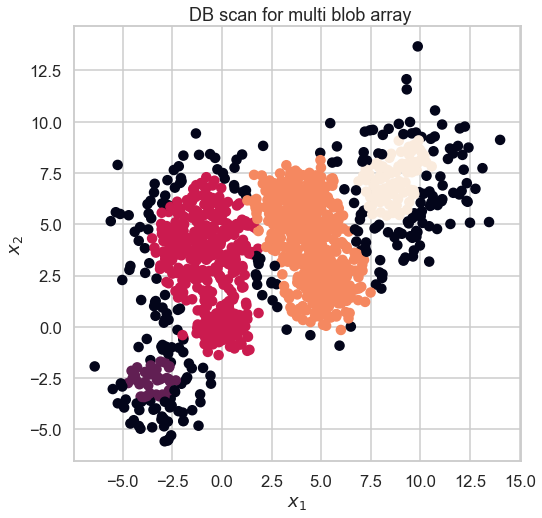

In [36]:
# drawing db scan
draw_dbscan(blob_array, " DB scan for multi blob array", 0.8795662680174702, 25)


# Hierarchal Clustering for multi blob data

In [54]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.metrics import silhouette_score
import scipy.cluster.hierarchy as shc
from scipy.cluster import hierarchy


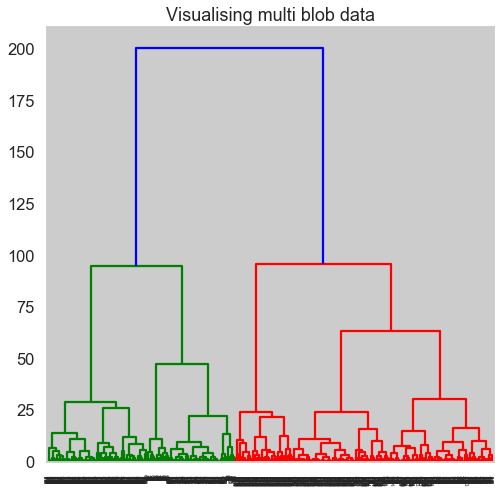

In [57]:
plt.figure(figsize =(8, 8))
plt.title('Visualising multi blob data')
Dendrogram = shc.dendrogram((shc.linkage(blob_df, method ='ward')))
#Z = hierarchy.linkage(blob_array, method='single')
plt.axhline(y=2000, color='b', linestyle='-')
plt.show()

 Affinity = l1 , against linkage = single


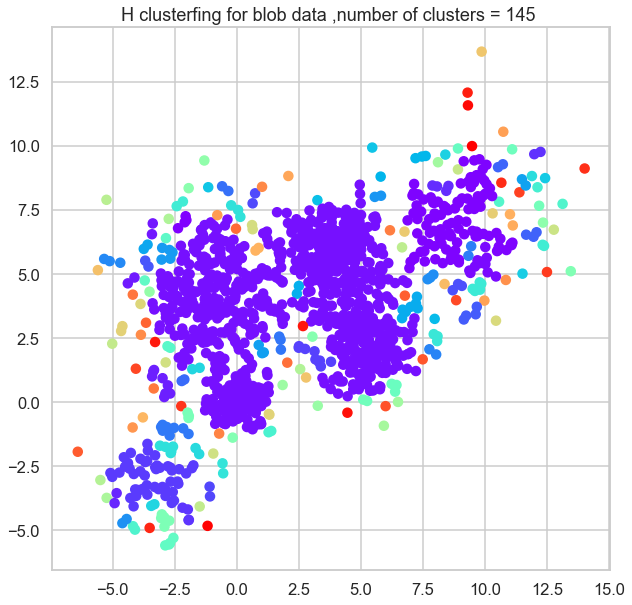

 Affinity = l1 , against linkage = average


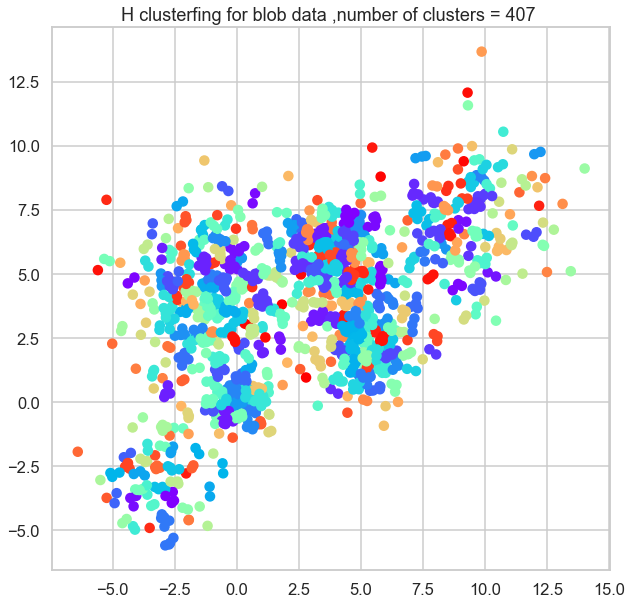

 Affinity = l2 , against linkage = single


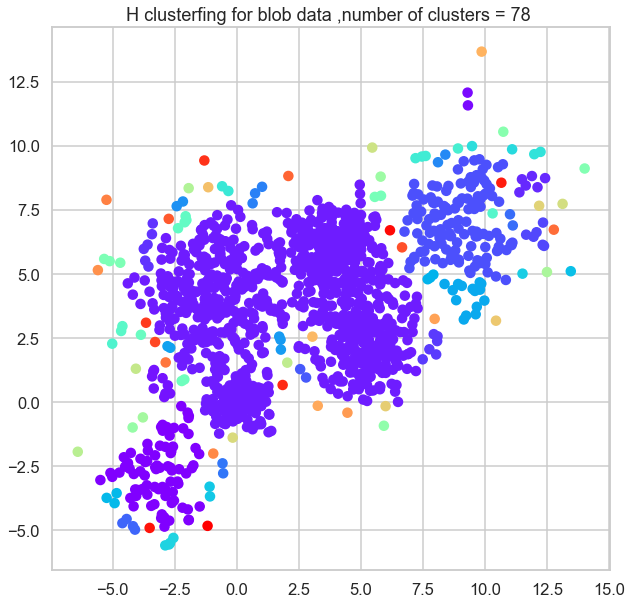

 Affinity = l2 , against linkage = average


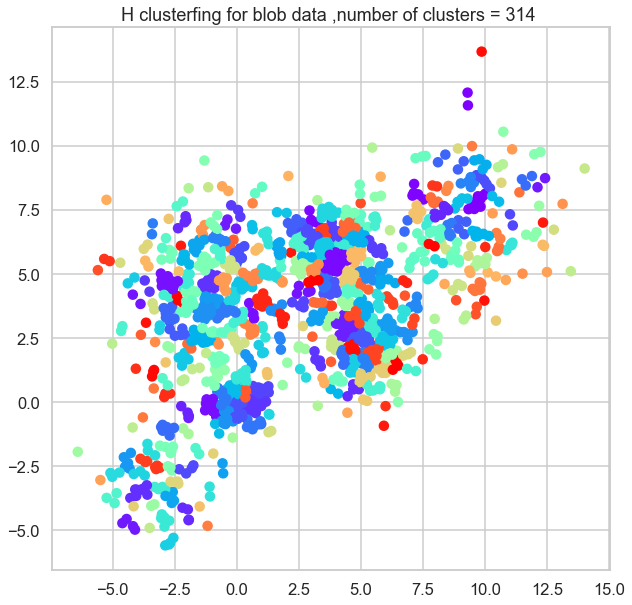

 Affinity = manhattan , against linkage = single


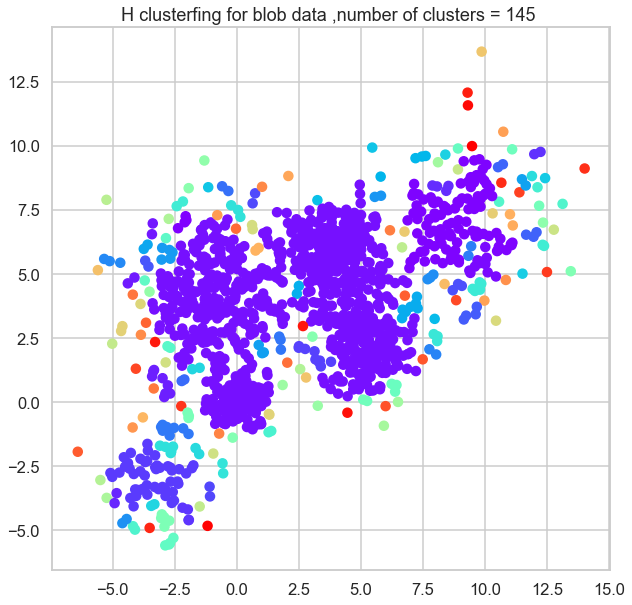

 Affinity = manhattan , against linkage = average


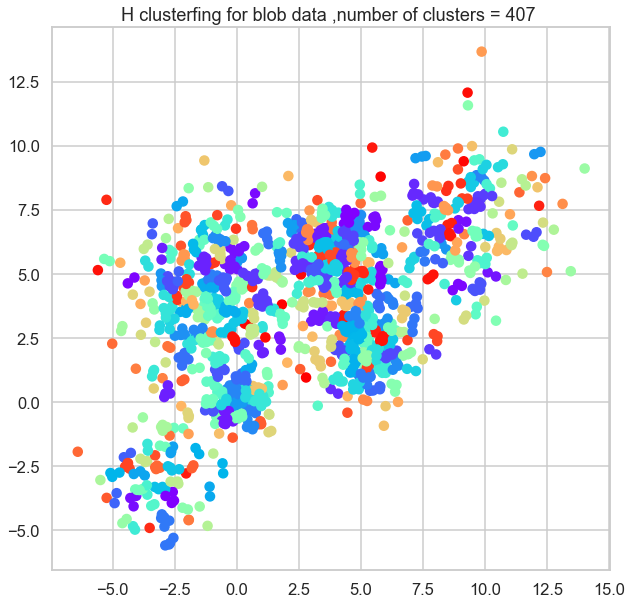

 Affinity = cosine , against linkage = single


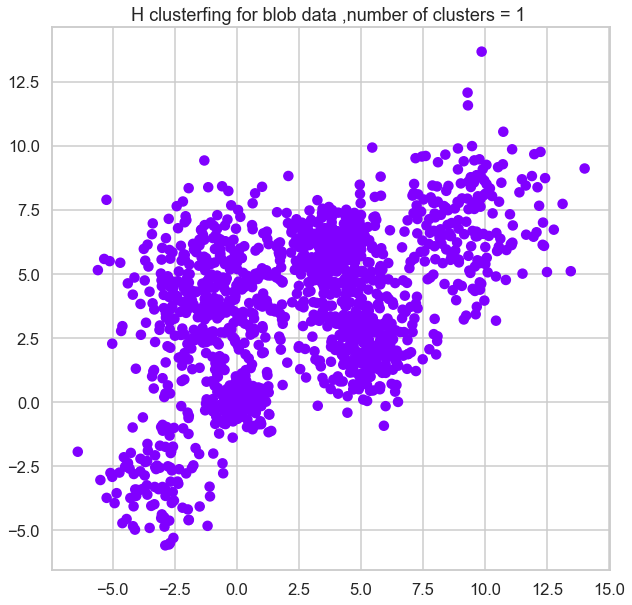

 Affinity = cosine , against linkage = average


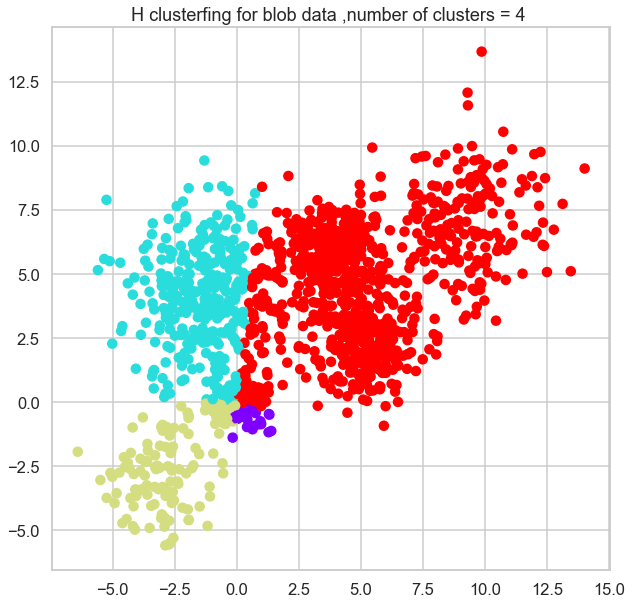

In [43]:
for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, blob_df, "H clusterfing for blob data" )
        

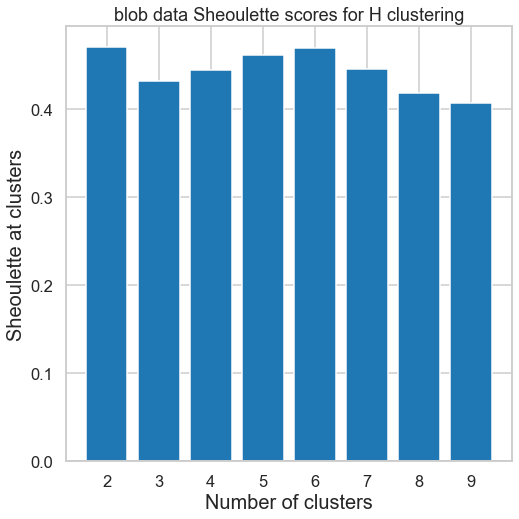

In [46]:
# calling
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, blob_df)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("blob data Sheoulette scores for H clustering")
plt.show()

# Gaussian mixture for blob data

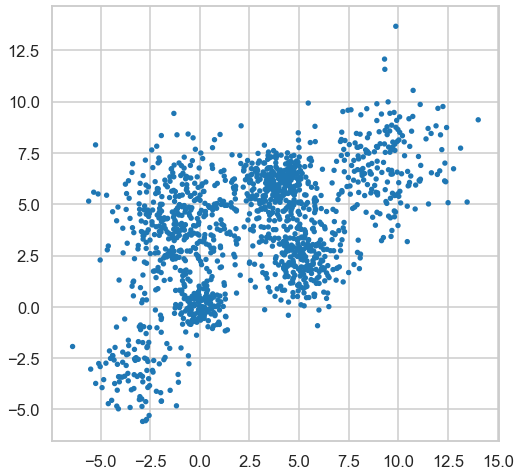

In [58]:
plt.scatter(blob_df[0], blob_df[1], s=[15,15])


lower bound: -5.031242316806638
full


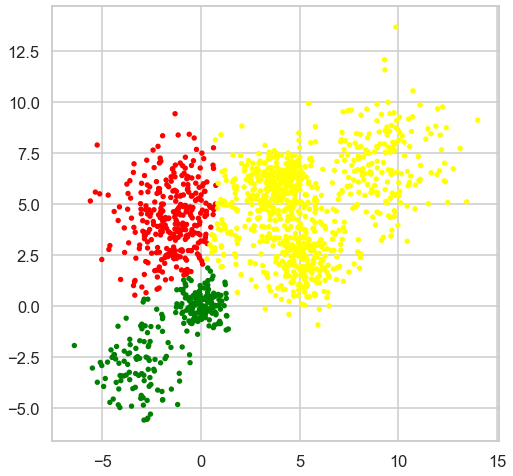

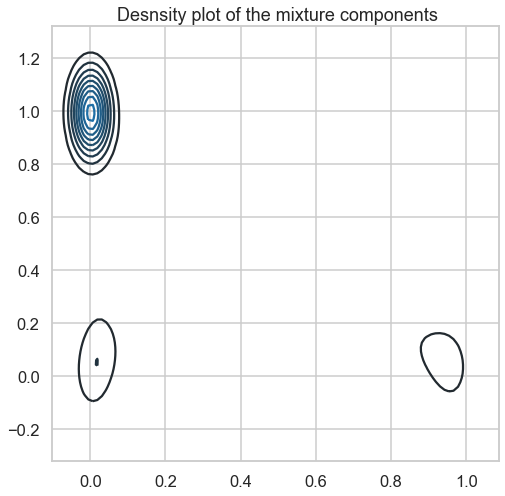

lower bound: 0.7531798483559244
tied


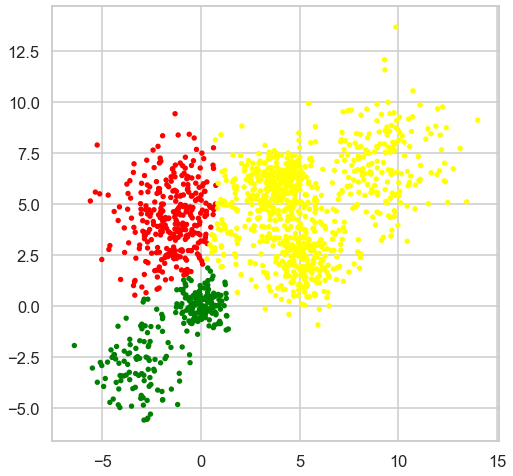

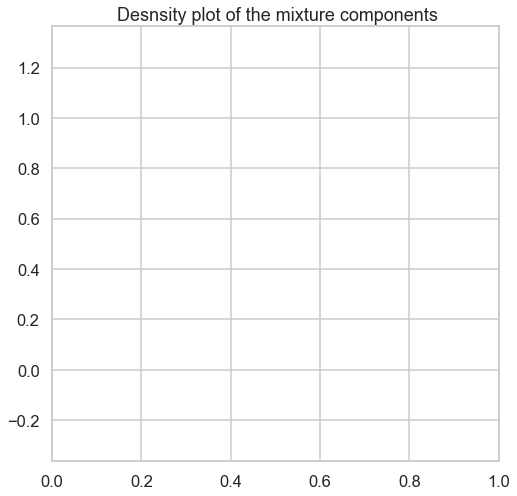

lower bound: 0.7872599602319629
diag


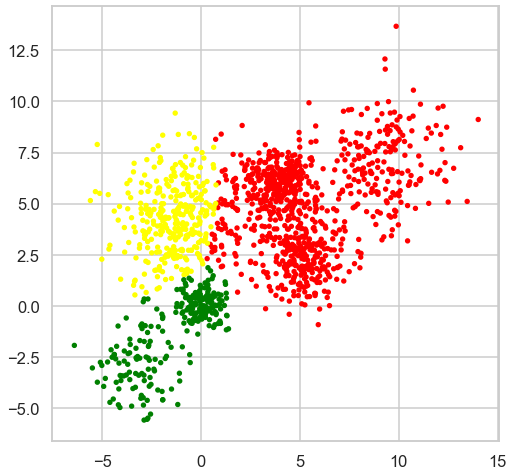

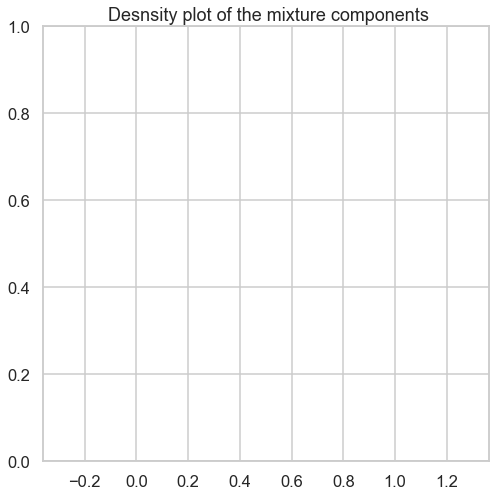

lower bound: -6.673926510839269
spherical


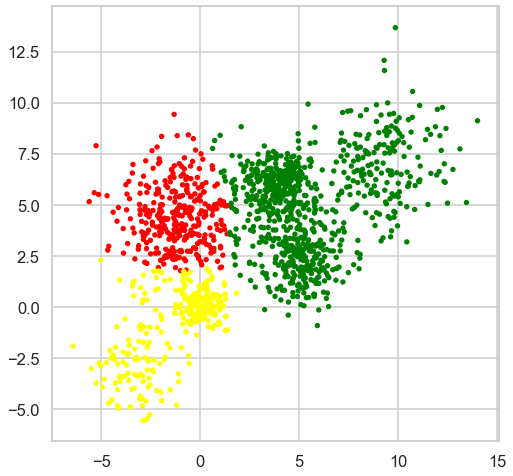

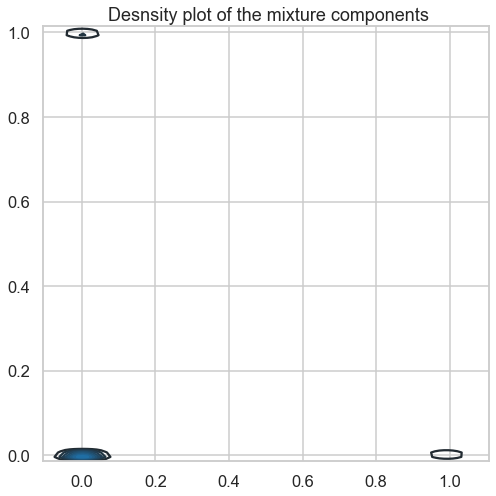

In [49]:
for i in k:
    draw3(i, blob_df)

# iris data set

# iris data set preparation

In [59]:
from sklearn.datasets import load_iris

iris_data = load_iris()
df_iris = pd.DataFrame(data= np.c_[iris_data['data'], iris_data['target']],
                     columns= iris_data['feature_names'] + ['target'])

In [60]:
df_iris.head()


,sepal length (cm),sepal width (cm),petal length (cm),petal width (cm),target
0,5.1,3.5,1.4,0.2,0.0
1,4.9,3.0,1.4,0.2,0.0
2,4.7,3.2,1.3,0.2,0.0
3,4.6,3.1,1.5,0.2,0.0
4,5.0,3.6,1.4,0.2,0.0


In [61]:
df_sepal = df_iris.filter(['sepal length (cm)','sepal width (cm)'], axis=1)
df_sepal.head()

,sepal length (cm),sepal width (cm)
0,5.1,3.5
1,4.9,3.0
2,4.7,3.2
3,4.6,3.1
4,5.0,3.6


In [62]:
df_petal = df_iris.filter(['petal length (cm)','petal width (cm)'], axis=1)
df_petal.head()

,petal length (cm),petal width (cm)
0,1.4,0.2
1,1.4,0.2
2,1.3,0.2
3,1.5,0.2
4,1.4,0.2


In [63]:
df_sepal_array = np.array(df_sepal)

df_petal_array = np.array(df_petal)

# kmeans clustering for iris data

In [64]:
kmeans_sepal = KMeans(n_clusters= 6)
kmeans_sepal.fit(df_sepal_array)
print(kmeans_sepal.fit(df_sepal_array))
kmeans_petal = KMeans(n_clusters= 6)
kmeans_petal.fit(df_petal_array)
print(kmeans_petal.fit(df_petal_array))

KMeans(n_clusters=6)
KMeans(n_clusters=6)


Text(0.5, 1.0, 'sepal scatter plot')

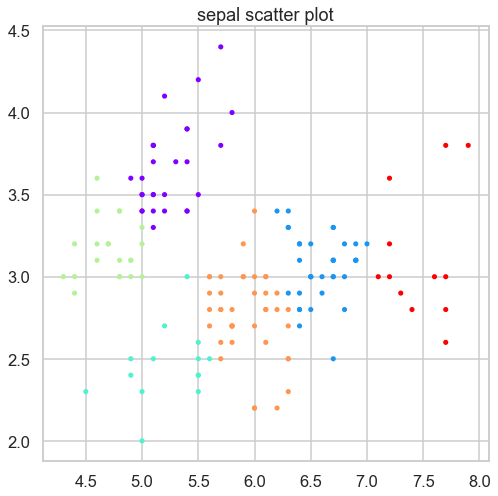

In [65]:
plt.scatter(df_sepal_array[:,0],df_sepal_array[:,1], c=kmeans_sepal.labels_, cmap='rainbow', s= [13,13])
plt.title("sepal scatter plot with clusters = 6")

Text(0.5, 1.0, 'petal scatter plot with clusters = 6')

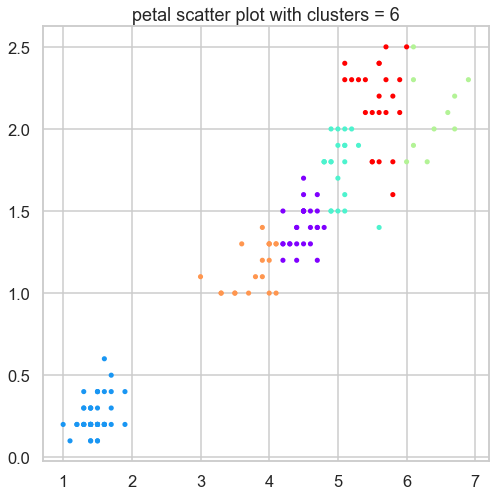

In [67]:
plt.scatter(df_petal_array[:,0],df_petal_array[:,1], c=kmeans_petal.labels_, cmap='rainbow', s= [13,13])
plt.title("petal scatter plot with clusters = 6")

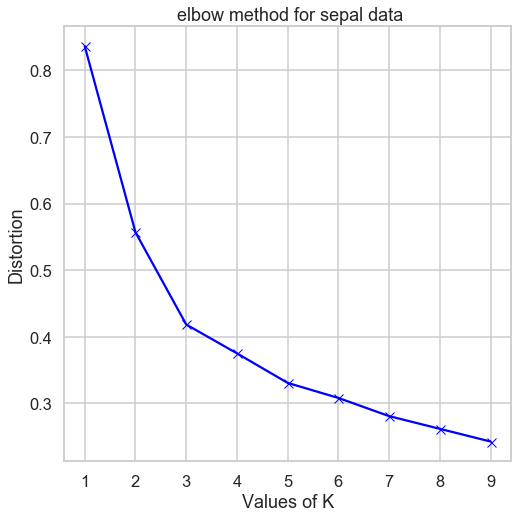

In [68]:
elbow_draw(df_sepal_array, " elbow method for sepal data")


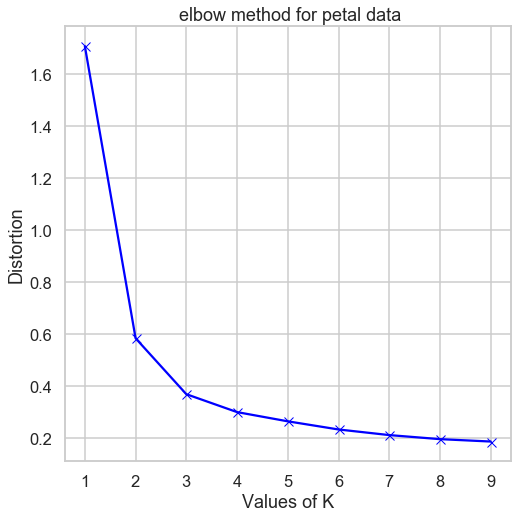

In [70]:
elbow_draw(df_petal_array, " elbow method for petal data")


silhouette score for sepal with clusters = 4
0.4206583419478651


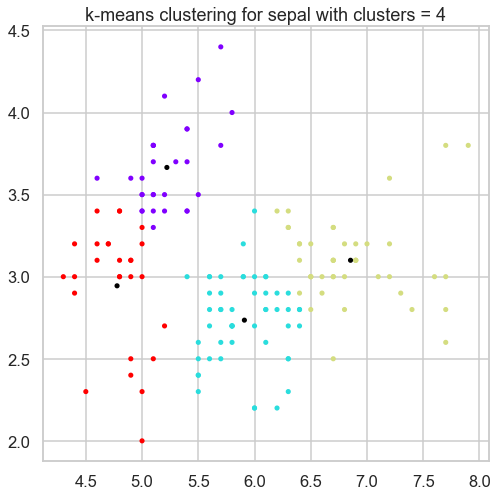

silhouette score for sepal with clusters = 5
0.41181523011737703


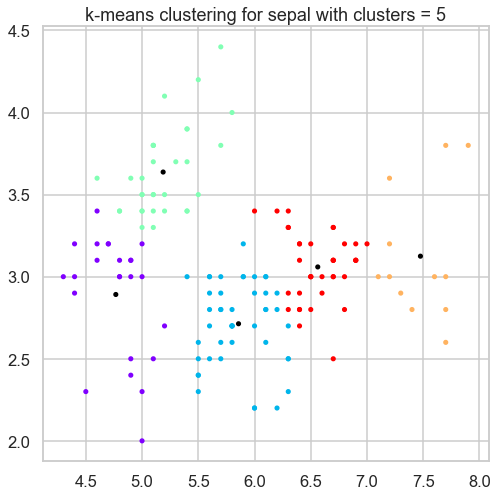

silhouette score for sepal with clusters = 6
0.3940131398141253


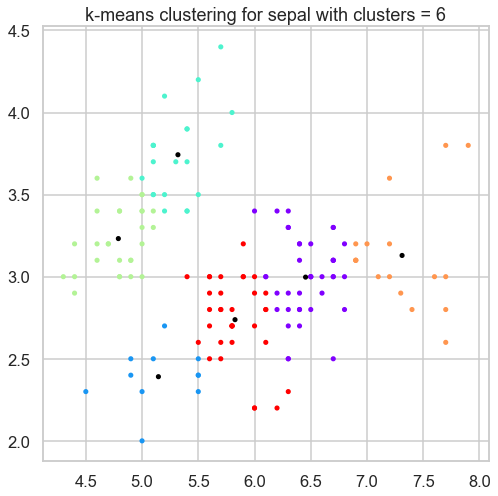

silhouette score for sepal with clusters = 7
0.3721654418203221


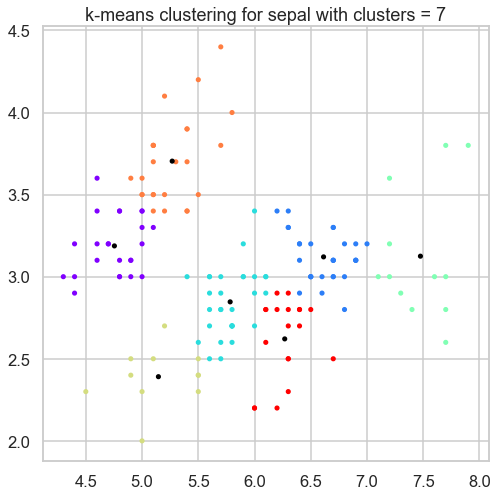

silhouette score for sepal with clusters = 8
0.3825506599589951


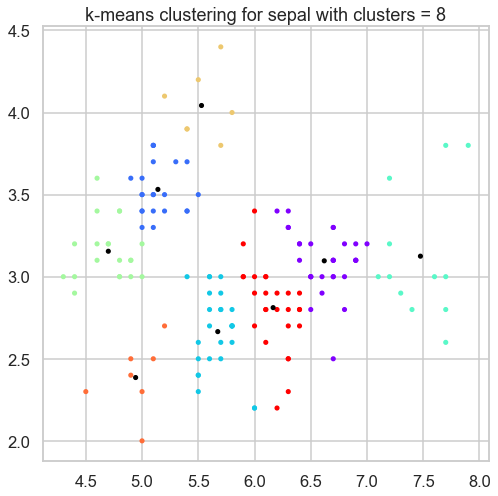

silhouette score for sepal with clusters = 9
0.3934201505779464


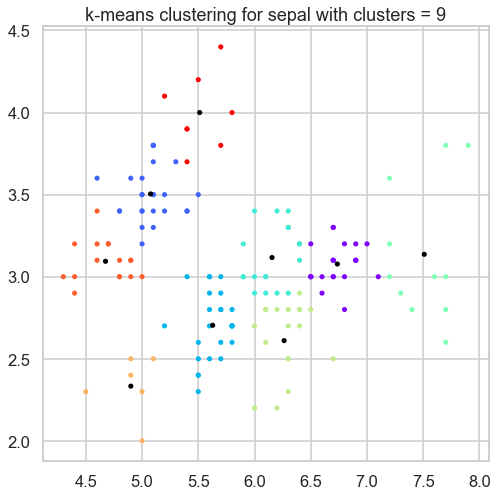

silhouette score for sepal with clusters = 10
0.40259824410360334


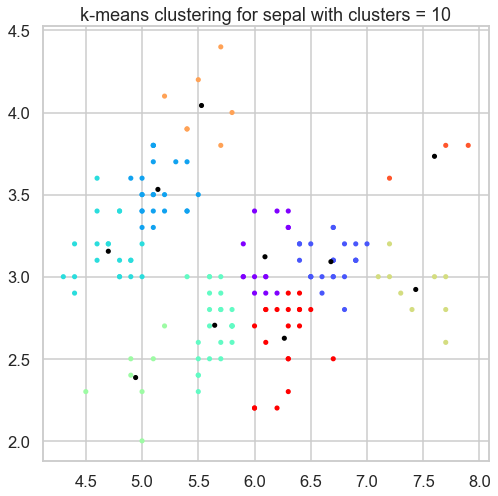

In [71]:
    
for i in k_variants:
    
    draw_kmeans(i, df_sepal_array, "k-means clustering for sepal with clusters = {}".format(i),
                "silhouette score for sepal with clusters = {}".format(i))

silhouette score for petal with clusters = 4
0.6127580794464402


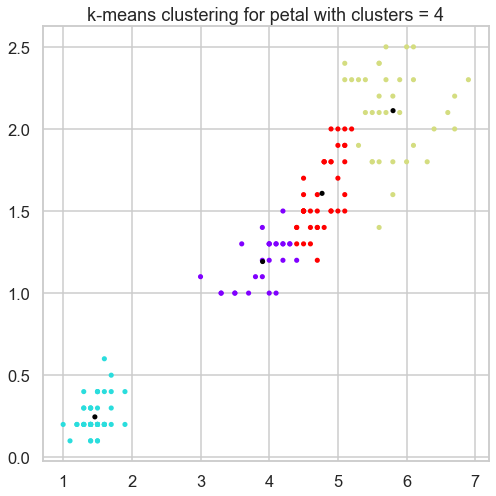

silhouette score for petal with clusters = 5
0.5883732712110276


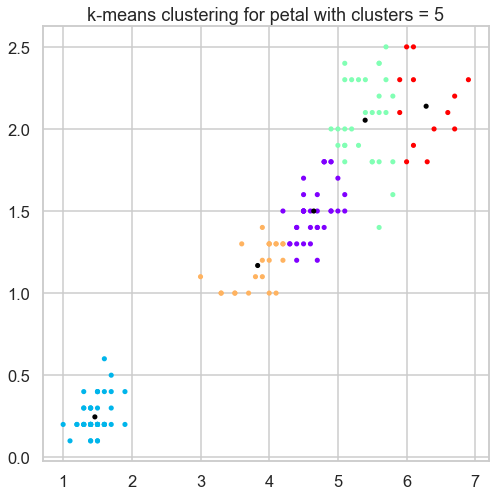

silhouette score for petal with clusters = 6
0.576292818723561


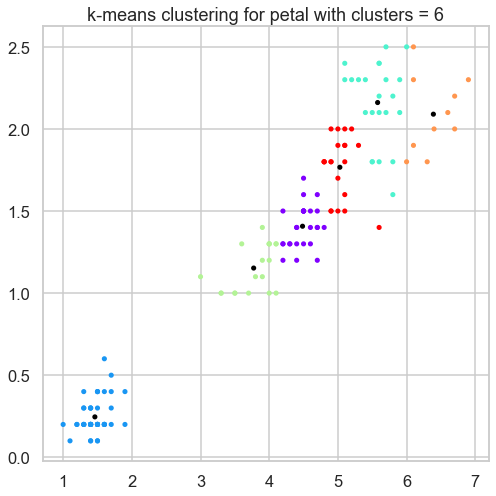

silhouette score for petal with clusters = 7
0.5640984340524553


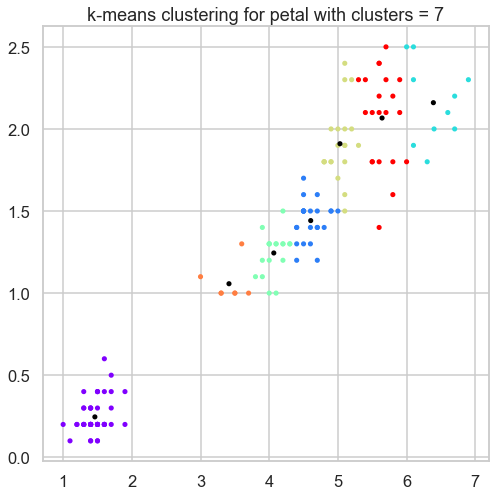

silhouette score for petal with clusters = 8
0.5902255624998716


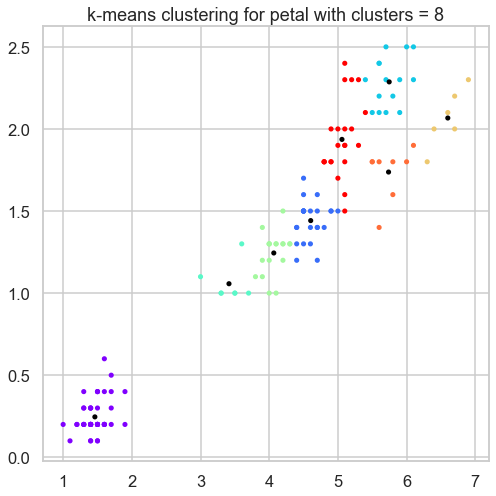

silhouette score for petal with clusters = 9
0.570862058656529


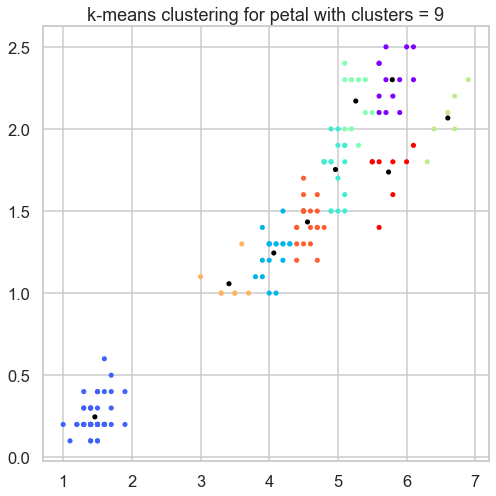

silhouette score for petal with clusters = 10
0.4212493802664013


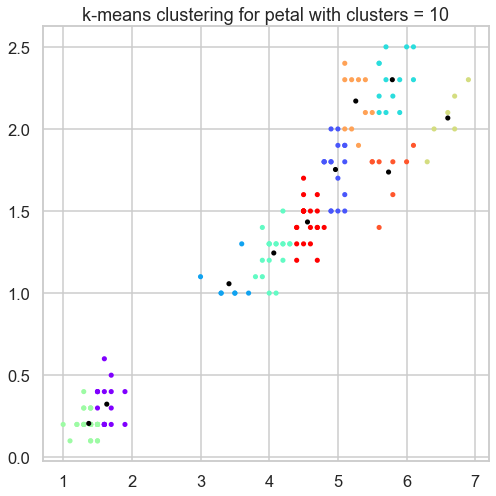

In [72]:
for i in k_variants:
    
    draw_kmeans(i, df_petal_array, "k-means clustering for petal with clusters = {}".format(i),
                "silhouette score for petal with clusters = {}".format(i))

# DB Scan for iris data

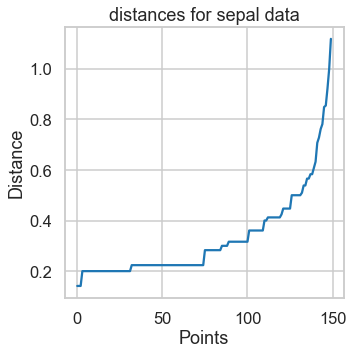

In [74]:
draw_dbscan_dist(df_sepal_array, "distances for sepal data")
distances_df= distances

optimal eps: 0.49999999999999983


<Figure size 360x360 with 0 Axes>

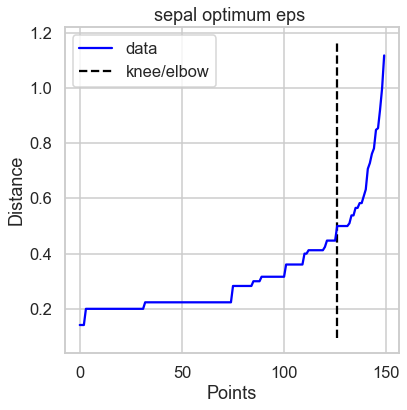

In [75]:
db_optimal_eps(distances_df, "sepal optimum eps ")

Estimated no. of clusters 2: 
Estimated no. of noise points: 15
total number of points: 300 
effeciency : 95.0


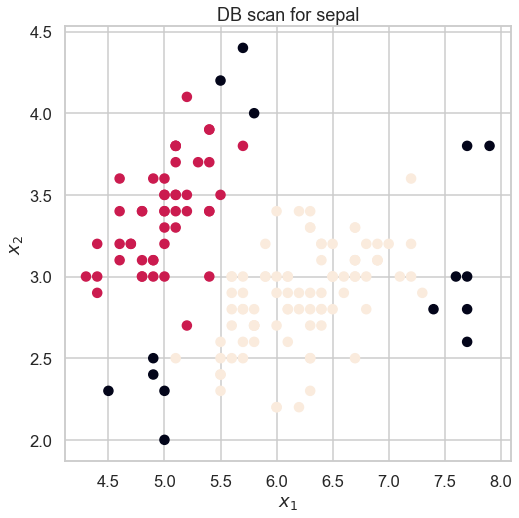

In [76]:
draw_dbscan(df_sepal_array, " DB scan for sepal ", 0.49999999999999983, 25)


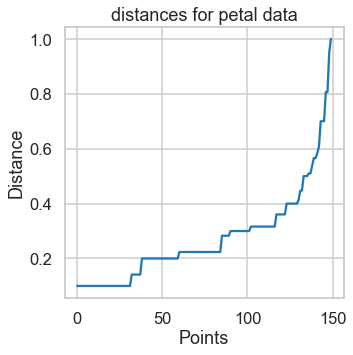

In [77]:
draw_dbscan_dist(df_petal_array, "distances for petal data")
distances_df= distances

optimal eps: 0.3999999999999999


<Figure size 360x360 with 0 Axes>

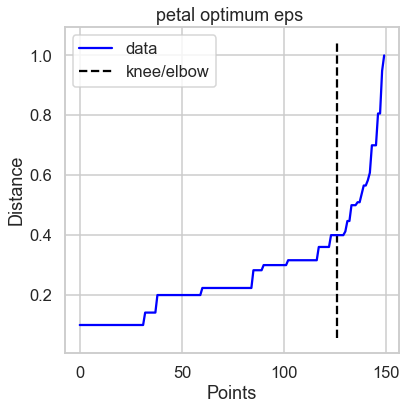

In [78]:
db_optimal_eps(distances_df, "petal optimum eps ")

Estimated no. of clusters 2: 
Estimated no. of noise points: 51
total number of points: 300 
effeciency : 83.0


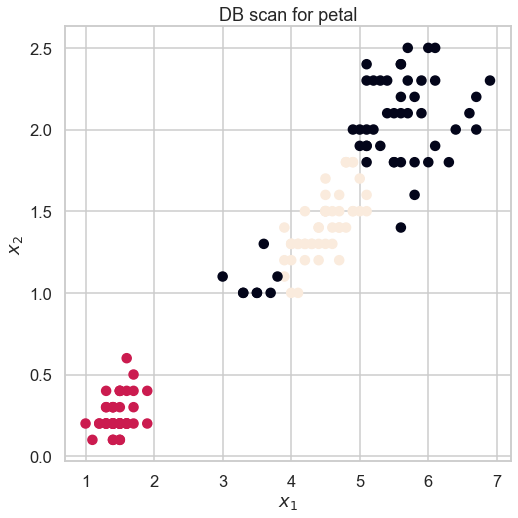

In [79]:
draw_dbscan(df_petal_array, " DB scan for petal ", 0.3999999999999999, 25)


# Hierarchal Clustering for iris data

 Affinity = l1 , against linkage = single


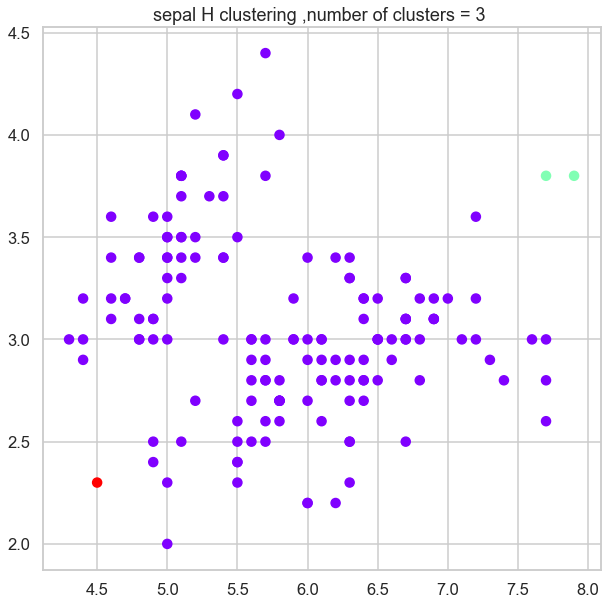

 Affinity = l1 , against linkage = average


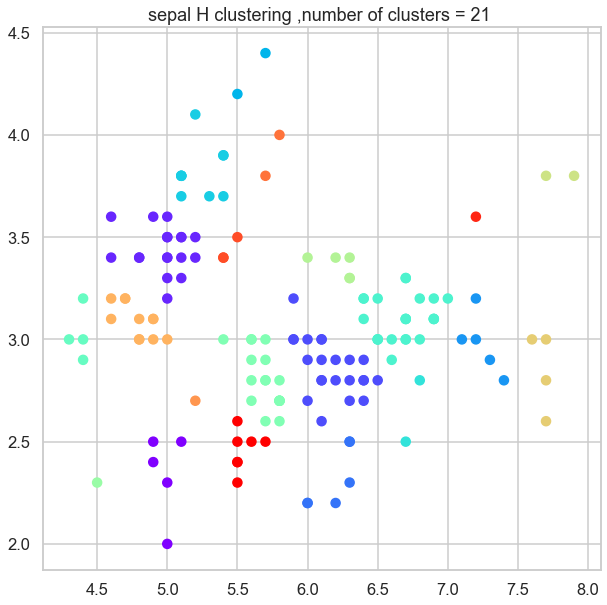

 Affinity = l2 , against linkage = single


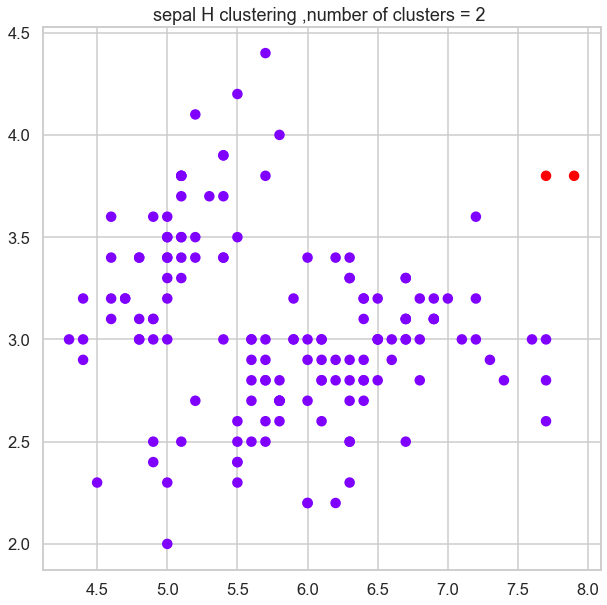

 Affinity = l2 , against linkage = average


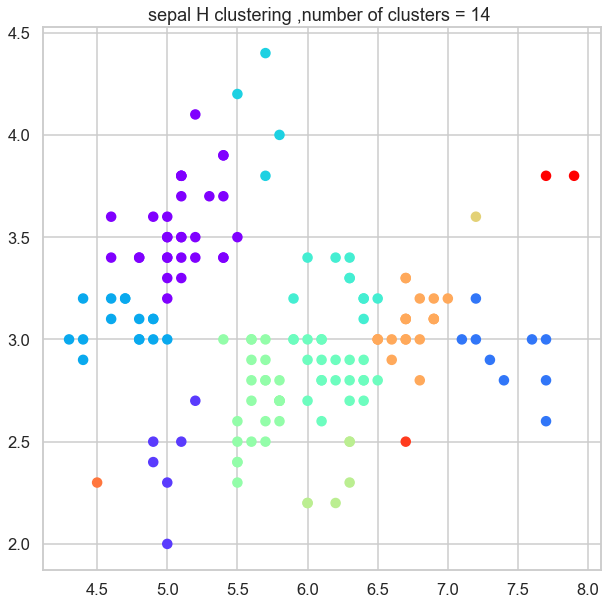

 Affinity = manhattan , against linkage = single


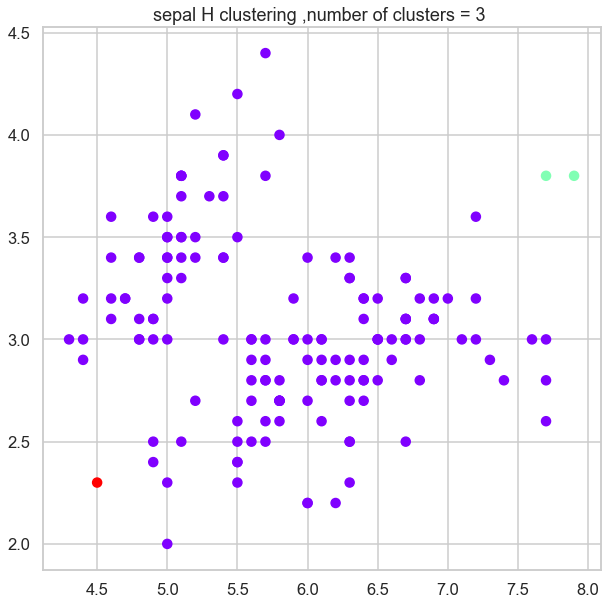

 Affinity = manhattan , against linkage = average


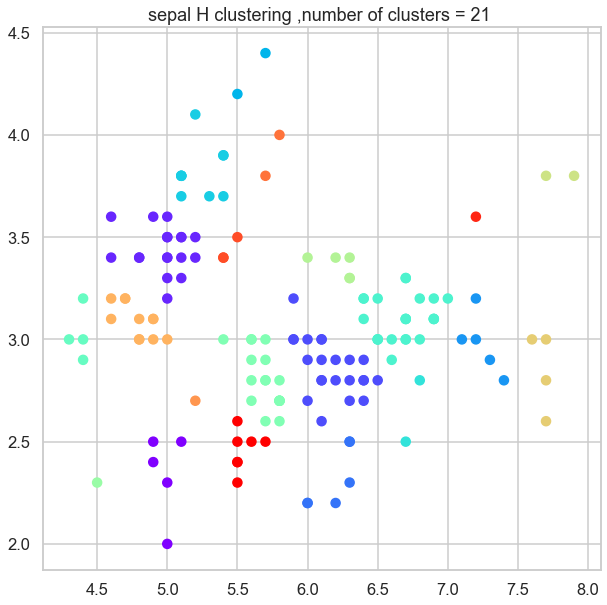

 Affinity = cosine , against linkage = single


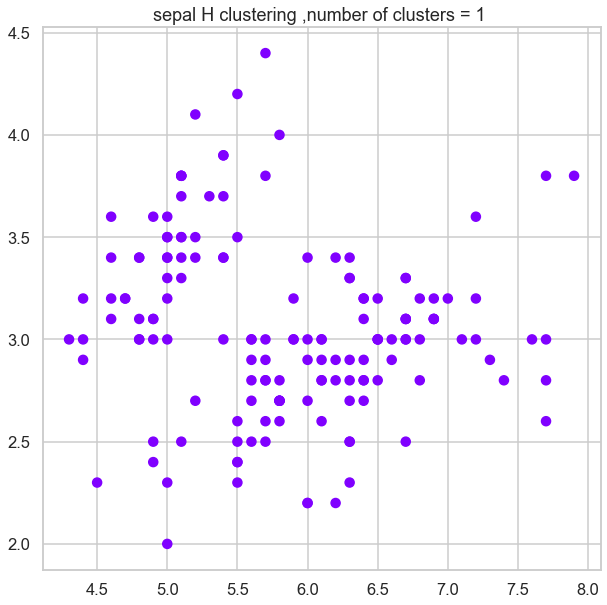

 Affinity = cosine , against linkage = average


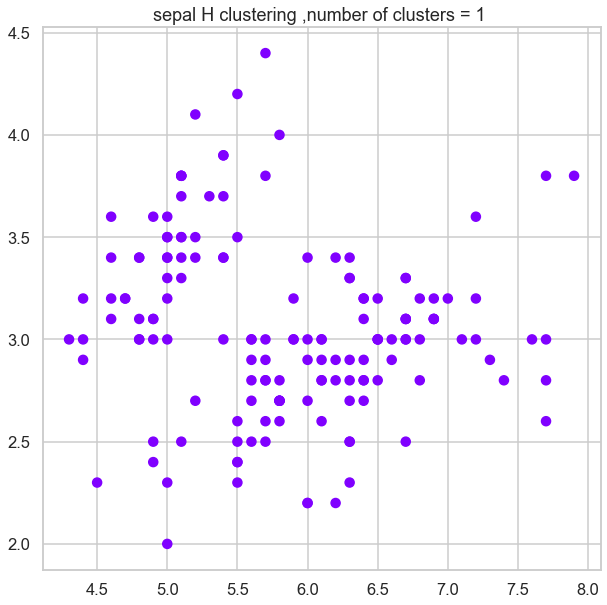

In [86]:
# call
df_sepal = df_sepal.rename(columns={"sepal length (cm)":0, "sepal width (cm)":1})
df_petal = df_petal.rename(columns={"petal length (cm)":0, "petal width (cm)":1})
for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df_sepal, "sepal H clustering" )

 Affinity = l1 , against linkage = single


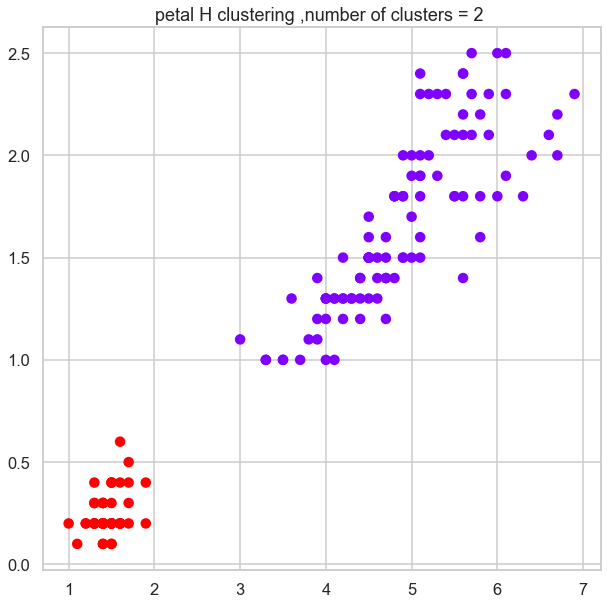

 Affinity = l1 , against linkage = average


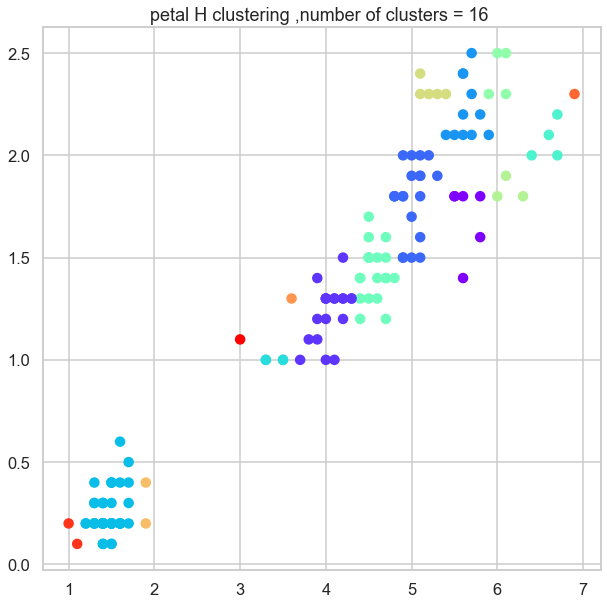

 Affinity = l2 , against linkage = single


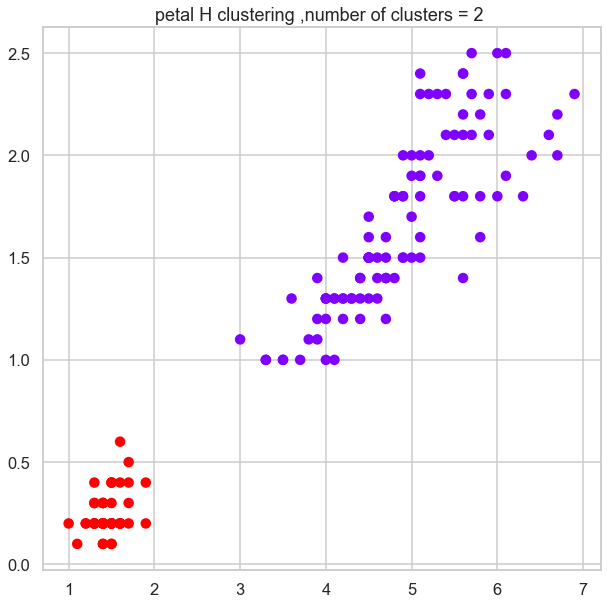

 Affinity = l2 , against linkage = average


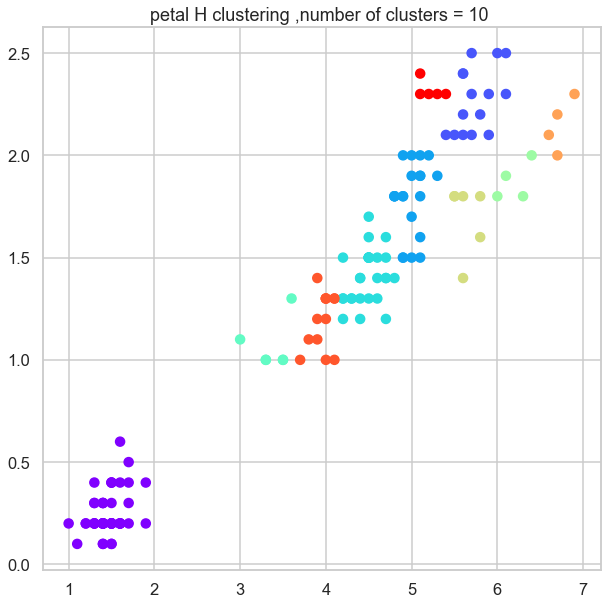

 Affinity = manhattan , against linkage = single


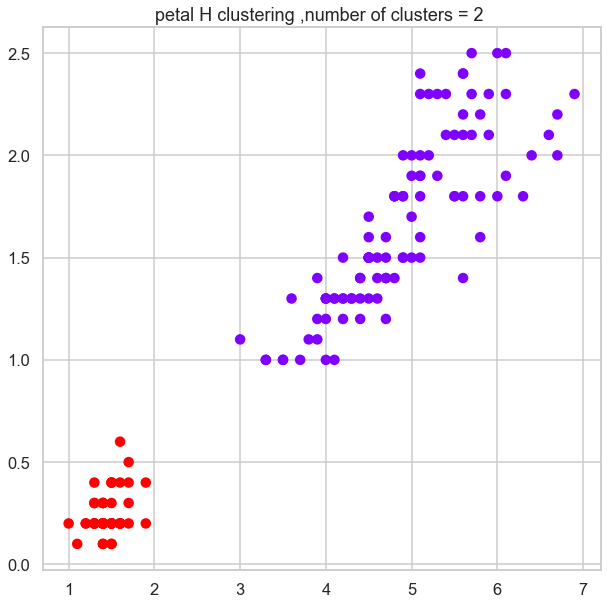

 Affinity = manhattan , against linkage = average


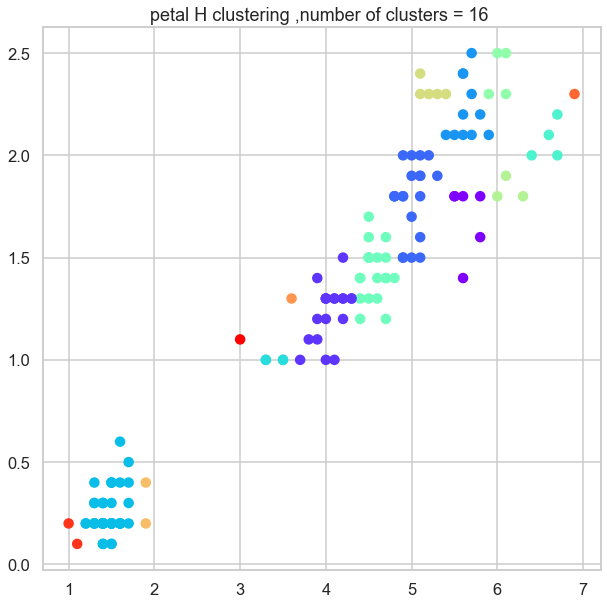

 Affinity = cosine , against linkage = single


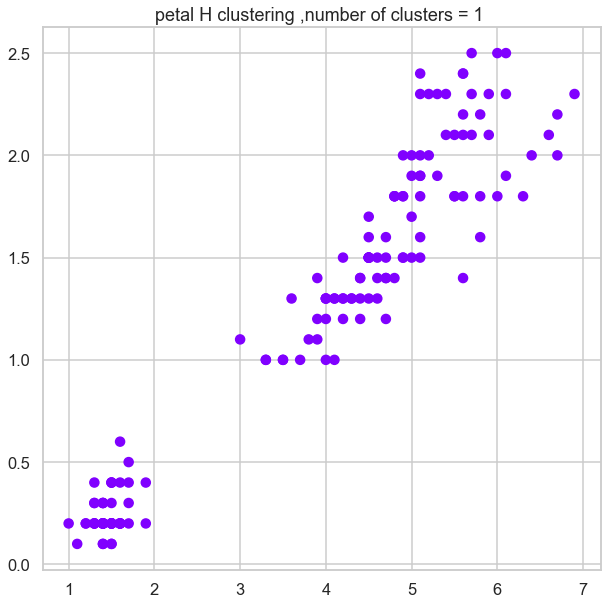

 Affinity = cosine , against linkage = average


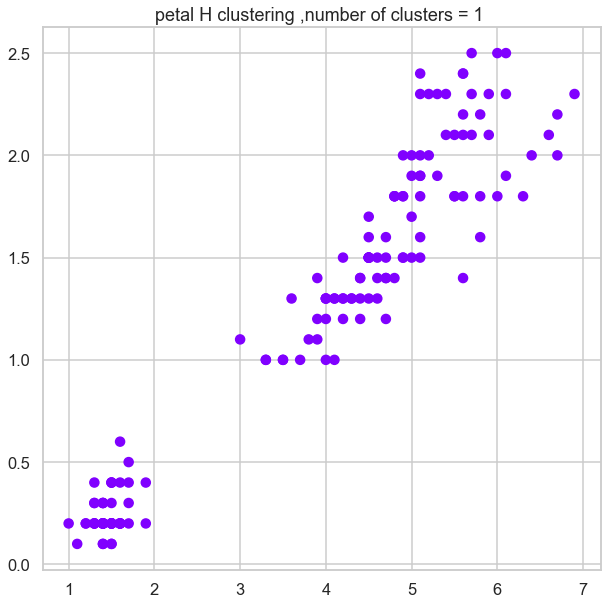

In [87]:
for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df_petal, "petal H clustering" )

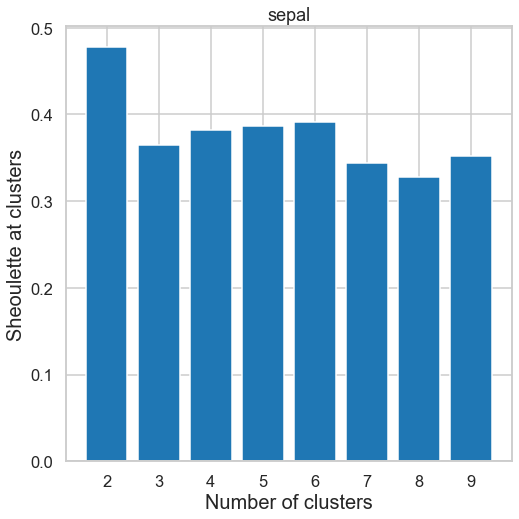

In [88]:
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df_sepal_array)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("sepal Sheoulette scores")
plt.show()

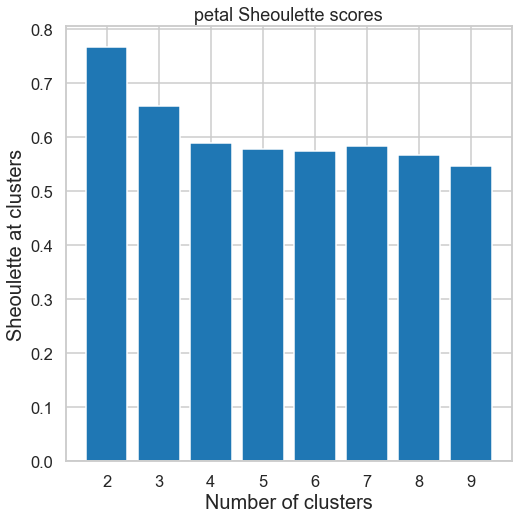

In [89]:
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df_petal_array)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("petal Sheoulette scores")
plt.show()

# Gaussian mixture for iris data

Text(0.5, 1.0, 'sepal scatter plot')

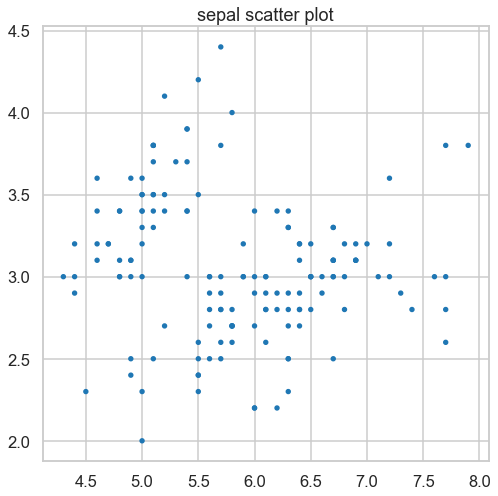

In [91]:
plt.scatter(df_sepal[0], df_sepal[1], s=[15,15])
plt.title("sepal scatter plot")


lower bound: 4.372457879667469
full


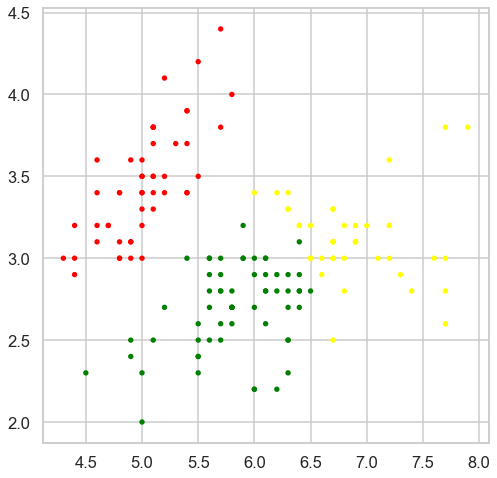

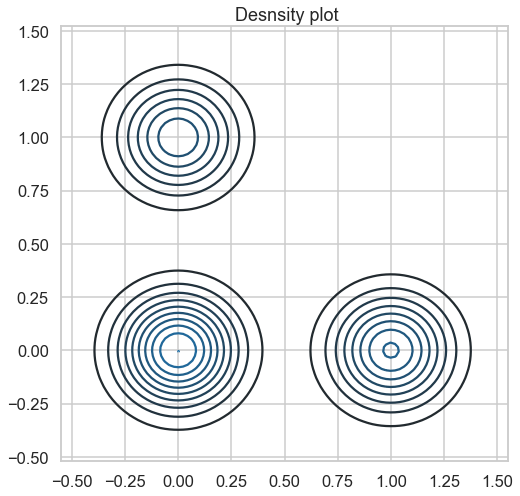

lower bound: 4.250108071815114
tied


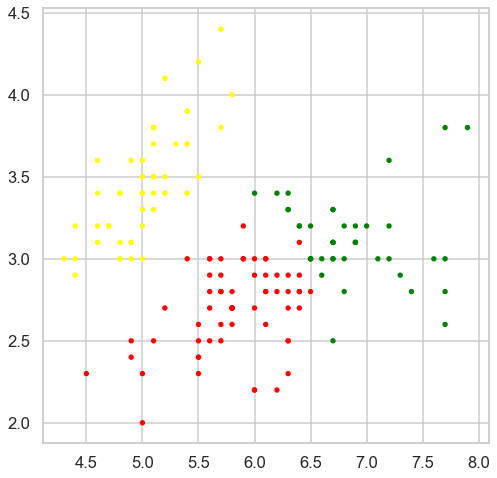

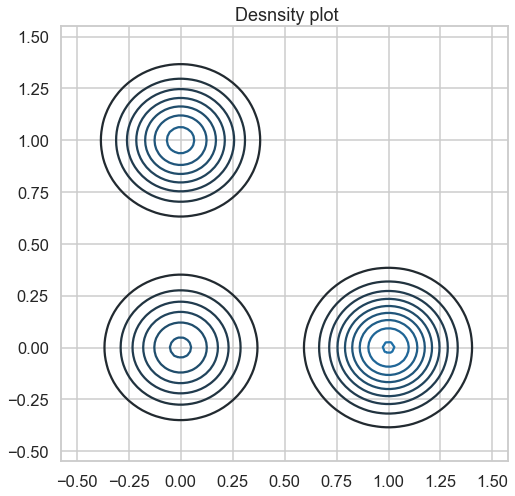

lower bound: 4.211239991352206
diag


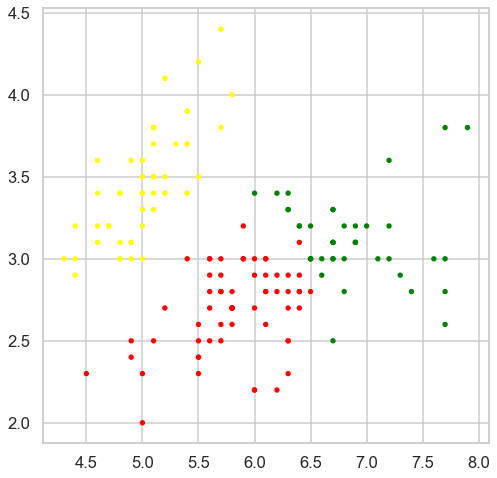

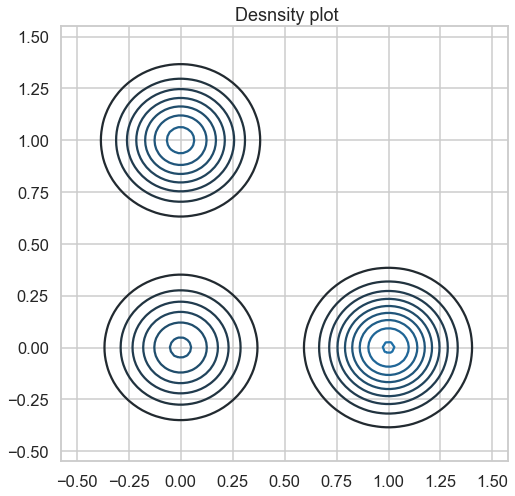

lower bound: -1.6545218264679464
spherical


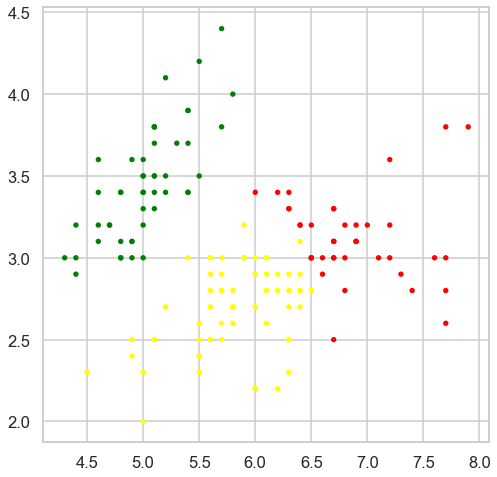

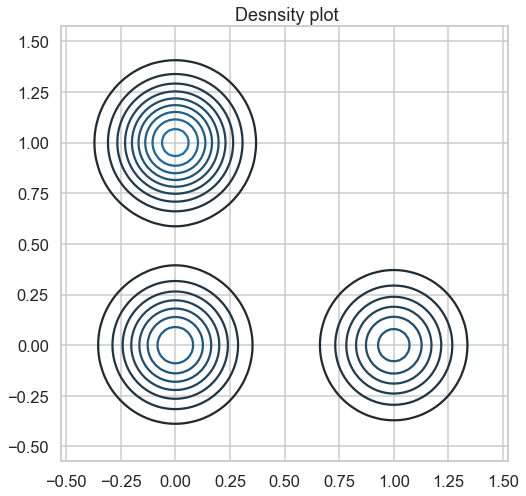

In [96]:
k = ["full", "tied", "diag", "spherical"]

for i in k:
    draw3(i, df_sepal)

Text(0.5, 1.0, 'petal scatter plot')

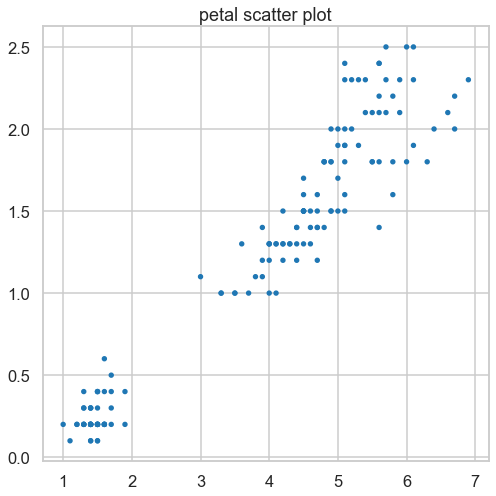

In [98]:
plt.scatter(df_petal[0], df_petal[1], s=[15,15])
plt.title("petal scatter plot")

lower bound: -0.9029910753072272
full


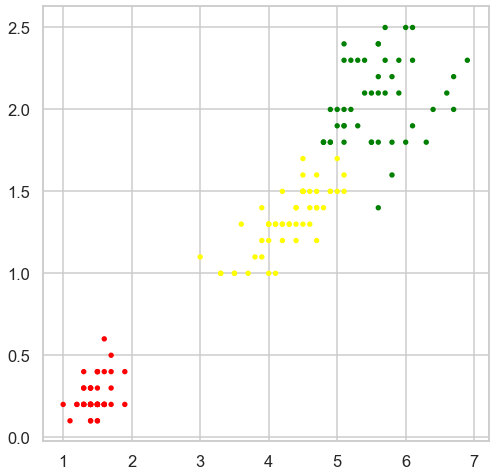

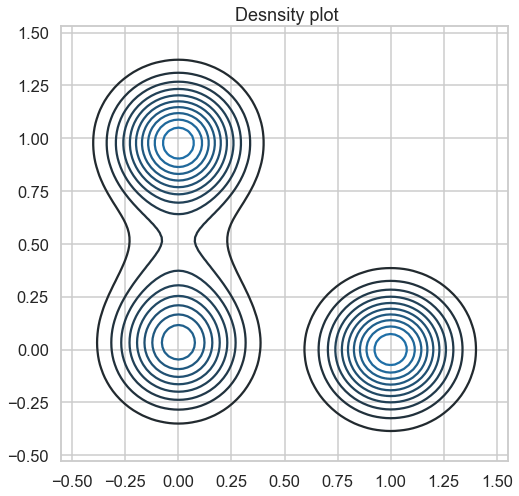

lower bound: 4.6814834312125
tied


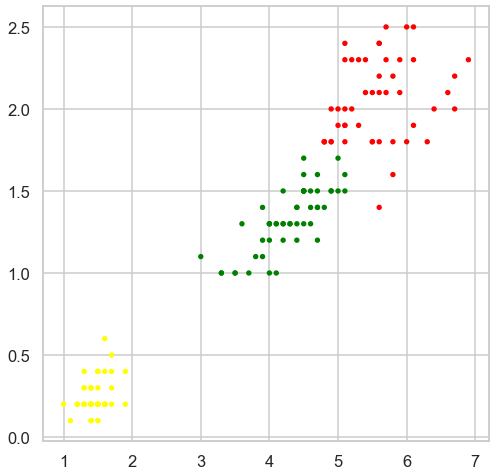

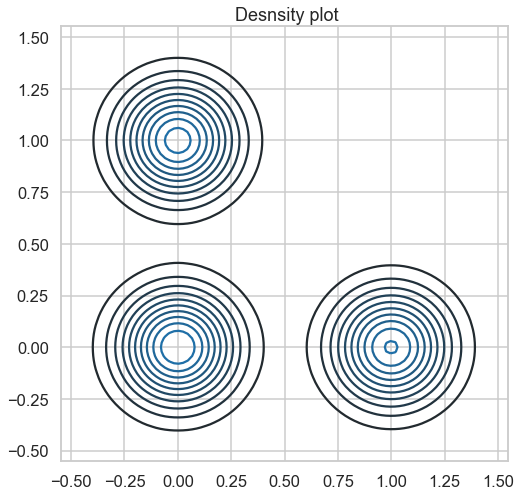

lower bound: 4.8640571226581715
diag


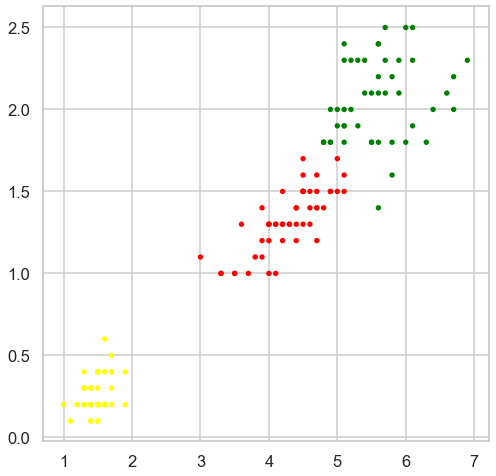

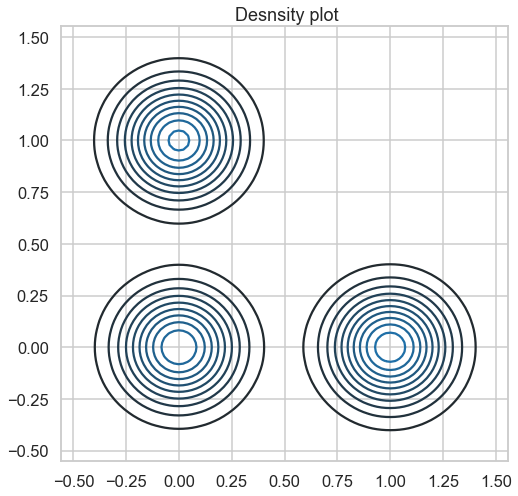

lower bound: -0.9082591208700724
spherical


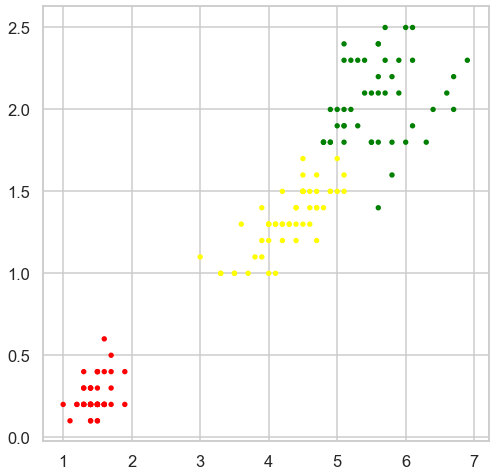

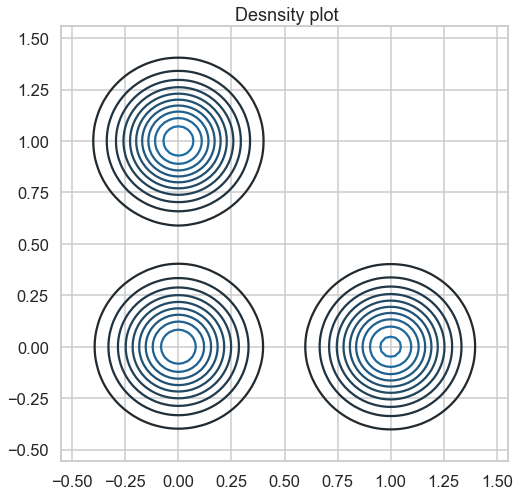

In [99]:
k = ["full", "tied", "diag", "spherical"]

for i in k:
    draw3(i, df_petal)

# Normalizing iris data

# Transorming data usnig min max and standard scaler

In [100]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
# transform dataframes to min mac scaler and then turning it to array
df_sepal_mms = scaler.fit_transform(df_sepal)
df_petal_mms = scaler.fit_transform(df_petal)
# mms = min mac scaler 
sepal_mms = np.array(df_sepal_mms)
petal_mms = np.array(df_petal_mms)

In [101]:
from sklearn.preprocessing import StandardScaler
scaler2 = StandardScaler()
# transform data using standard scaler, ss = standard scaler
df_sepal_ss = scaler2.fit_transform(df_sepal)
df_petal_ss = scaler2.fit_transform(df_petal)

sepal_ss = np.array(df_sepal_ss)
petal_ss = np.array(df_petal_ss)

# K-means after normalizing iris data


Text(0.5, 1.0, 'sepal scatter plot with min max scaler')

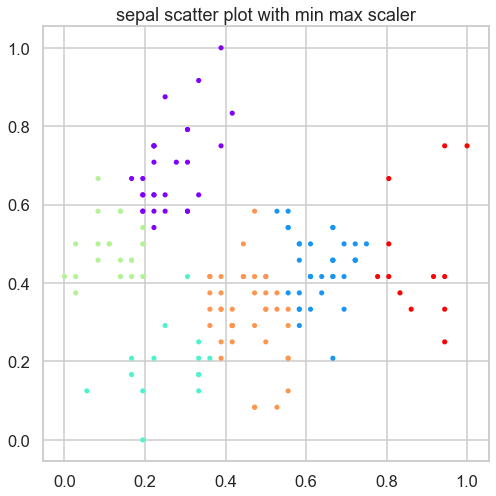

In [102]:
plt.scatter(sepal_mms[:,0],sepal_mms[:,1], c=kmeans_sepal.labels_, cmap='rainbow', s= [13,13])
plt.title("sepal scatter plot with min max scaler")

Text(0.5, 1.0, 'sepal scatter plot with standard scaller')

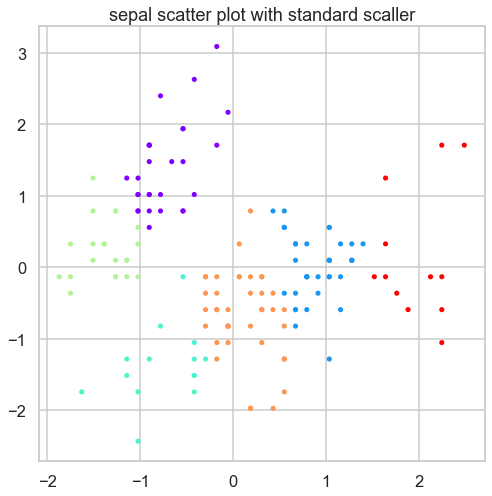

In [103]:
plt.scatter(sepal_ss[:,0],sepal_ss[:,1], c=kmeans_sepal.labels_, cmap='rainbow', s= [13,13])
plt.title("sepal scatter plot with standard scaller")

Text(0.5, 1.0, 'petal scatter plot with min max scaler')

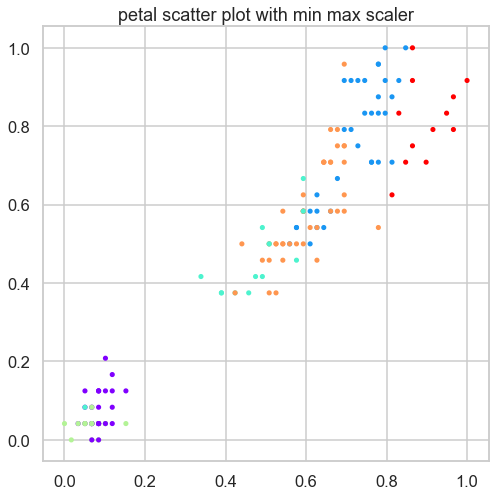

In [104]:
plt.scatter(petal_mms[:,0],petal_mms[:,1], c=kmeans_sepal.labels_, cmap='rainbow', s= [13,13])
plt.title("petal scatter plot with min max scaler")

Text(0.5, 1.0, 'petal scatter plot with standard scaler')

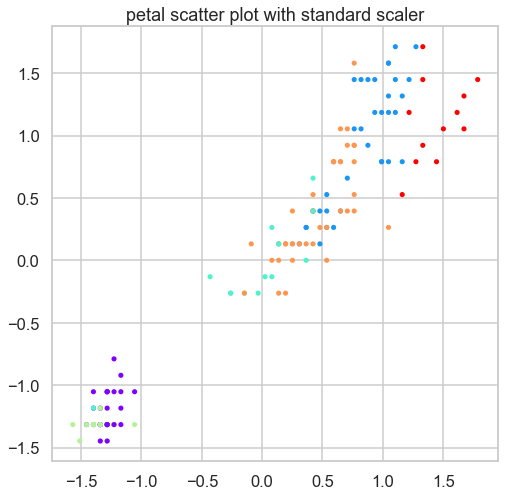

In [105]:
plt.scatter(petal_ss[:,0],petal_ss[:,1], c=kmeans_sepal.labels_, cmap='rainbow', s= [13,13])
plt.title("petal scatter plot with standard scaler")

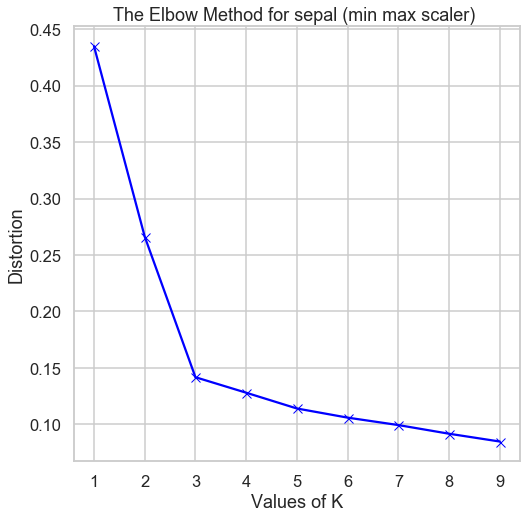

In [106]:
elbow_draw(sepal_mms, 'The Elbow Method for sepal (min max scaler) ' )

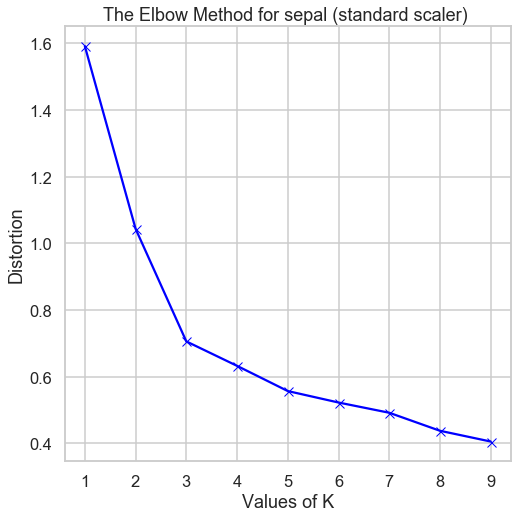

In [107]:
elbow_draw(sepal_ss, 'The Elbow Method for sepal (standard scaler) ' )

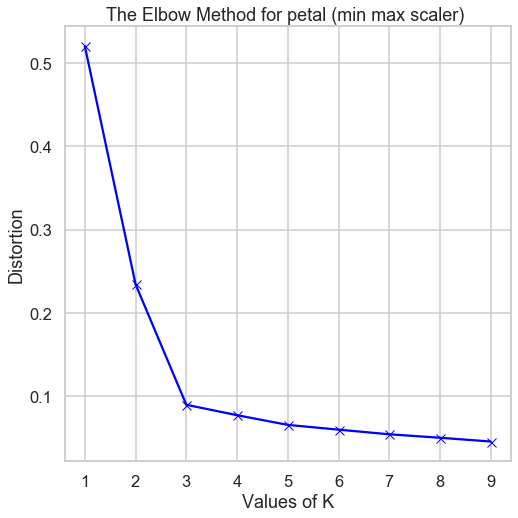

In [108]:
elbow_draw(petal_mms, 'The Elbow Method for petal (min max scaler) ' )

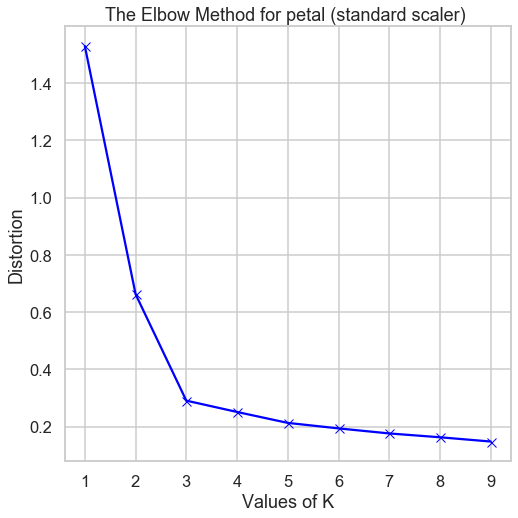

In [109]:
elbow_draw(petal_ss, 'The Elbow Method for petal (standard scaler) ' )

silhouette score for sepal with clusters = 4
0.6110197335356276


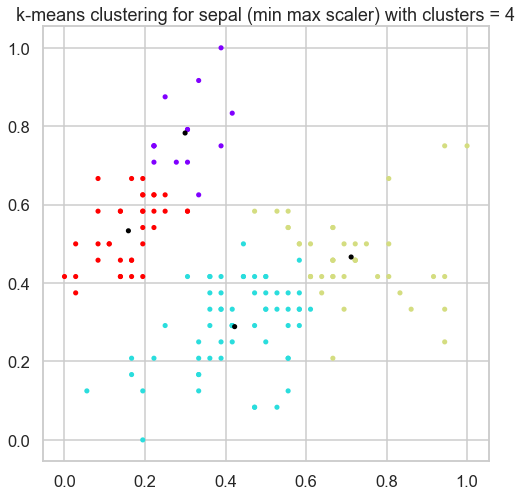

silhouette score for sepal with clusters = 5
0.5143902593795968


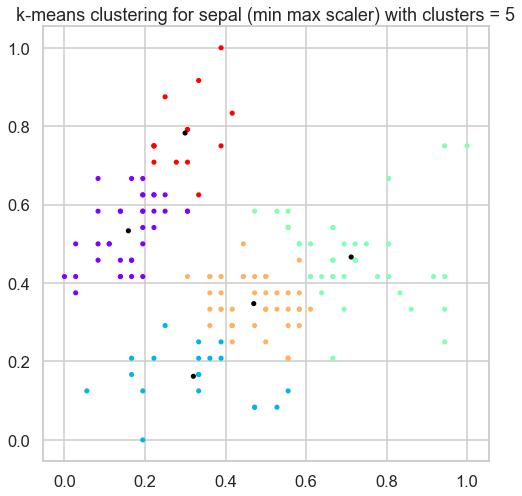

silhouette score for sepal with clusters = 6
0.4437916139012676


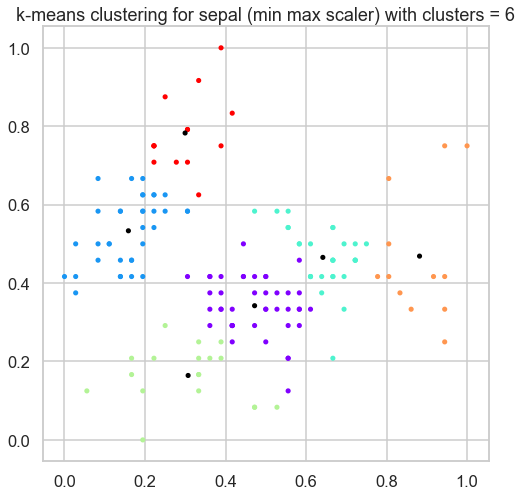

silhouette score for sepal with clusters = 7
0.44866495271216555


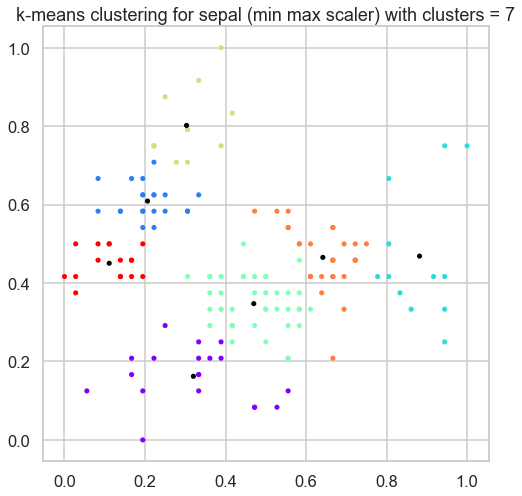

silhouette score for sepal with clusters = 8
0.45391020555993256


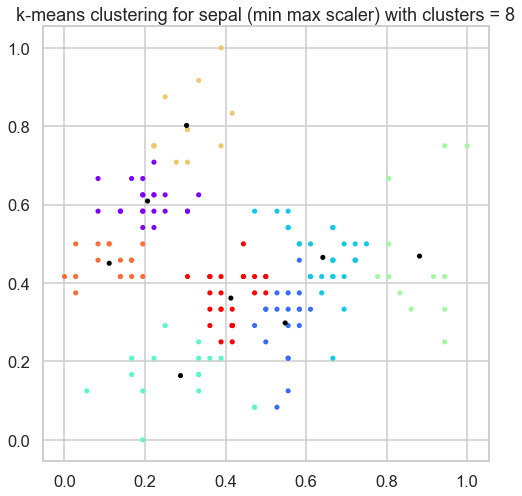

silhouette score for sepal with clusters = 9
0.4224397202968474


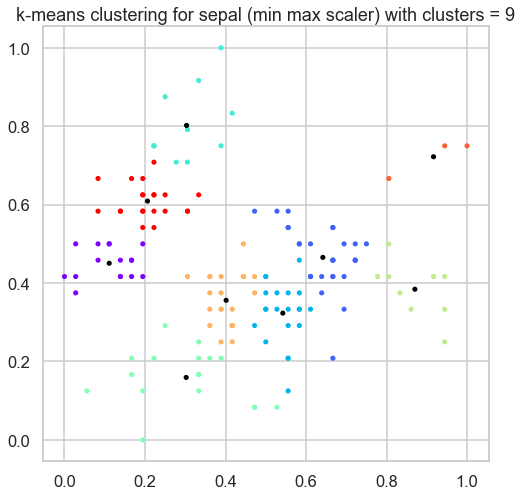

silhouette score for sepal with clusters = 10
0.43641619173835616


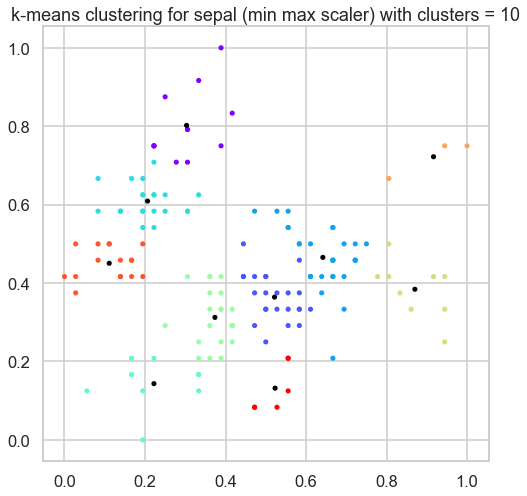

In [110]:
k_variants = [4,5,6,7,8,9,10]
for i in k_variants:
    
    draw_kmeans(i, sepal_mms, "k-means clustering for sepal (min max scaler) with clusters = {}".format(i),
                "silhouette score for sepal with clusters = {}".format(i))

silhouette score for sepal with clusters = 4
0.5289340693359185


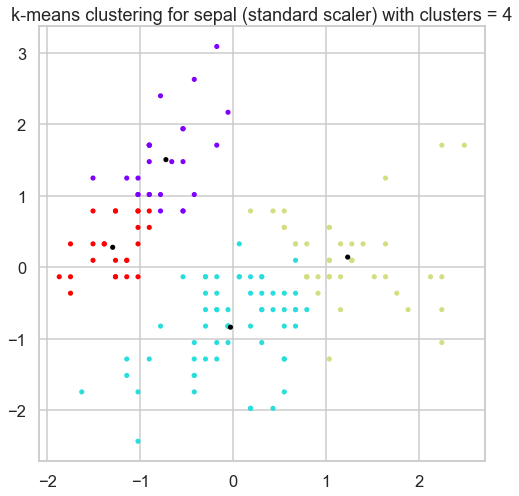

silhouette score for sepal with clusters = 5
0.4839714075933607


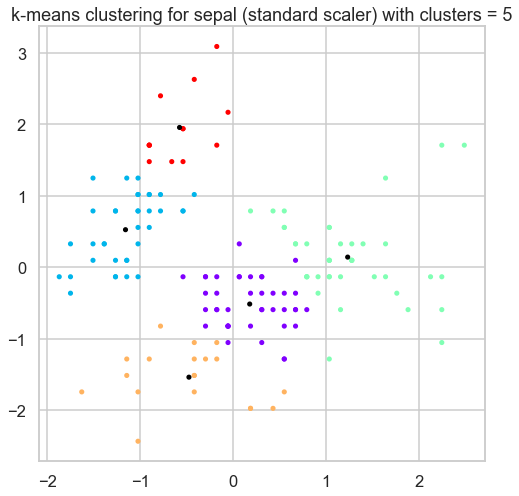

silhouette score for sepal with clusters = 6
0.4407424870818145


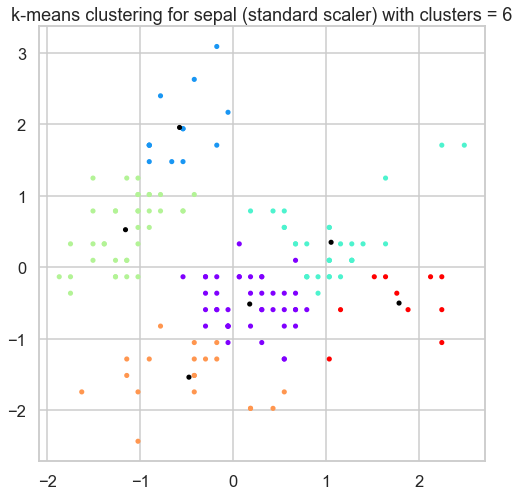

silhouette score for sepal with clusters = 7
0.4589084586663523


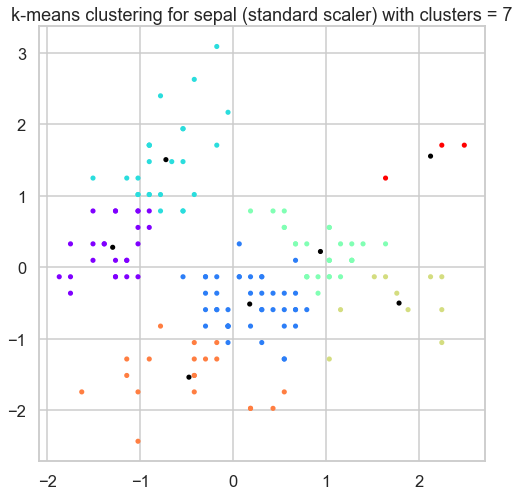

silhouette score for sepal with clusters = 8
0.4700627312582111


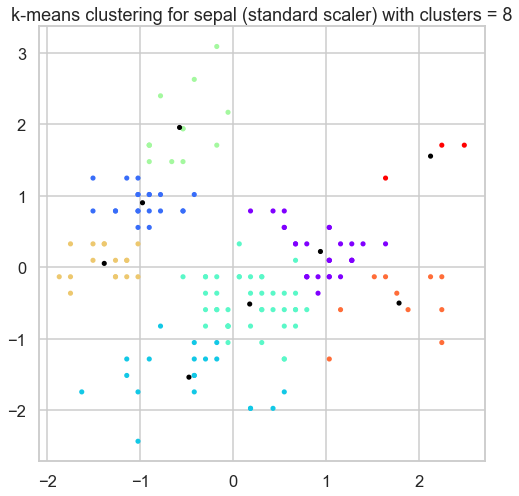

silhouette score for sepal with clusters = 9
0.4271001321548199


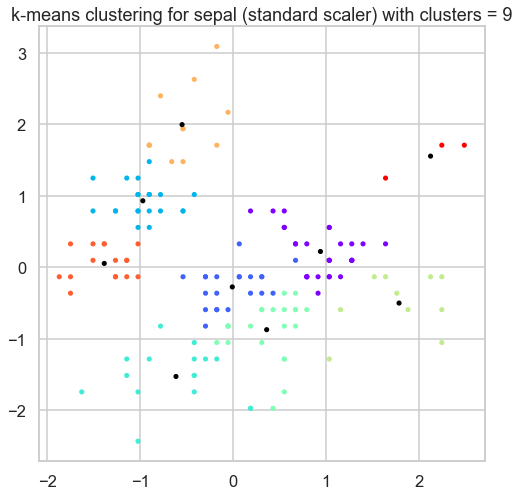

silhouette score for sepal with clusters = 10
0.4408717827953378


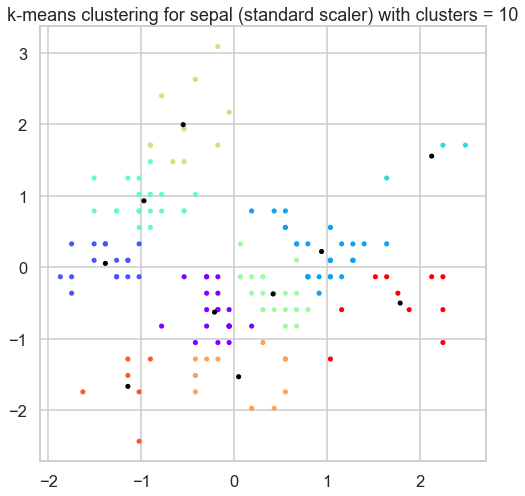

In [111]:
k_variants = [4,5,6,7,8,9,10]

for i in k_variants:
    
    draw_kmeans(i, sepal_ss, "k-means clustering for sepal (standard scaler) with clusters = {}".format(i),
                "silhouette score for sepal with clusters = {}".format(i))

silhouette score for petal with clusters = 4
0.7120147040452856


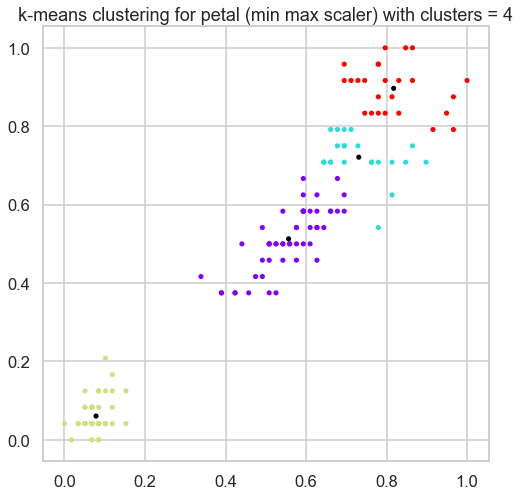

silhouette score for petal with clusters = 5
0.6125336573259572


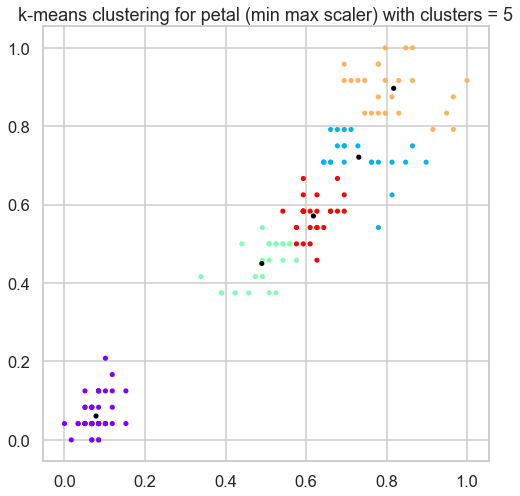

silhouette score for petal with clusters = 6
0.6222512005865568


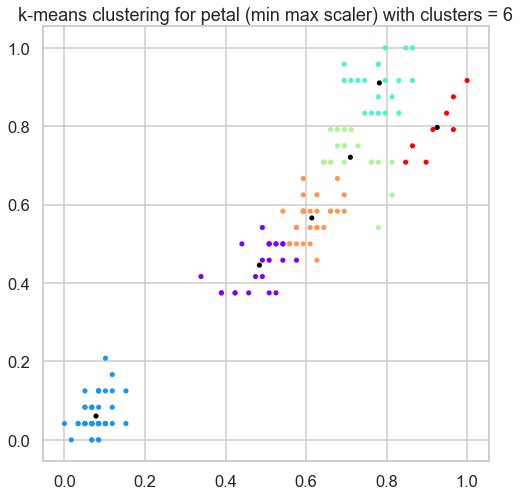

silhouette score for petal with clusters = 7
0.60847233917345


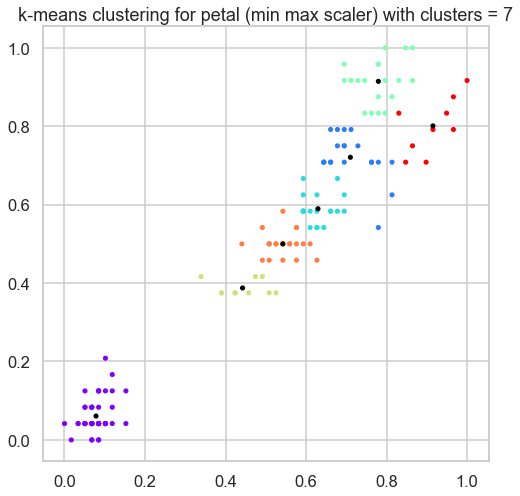

silhouette score for petal with clusters = 8
0.6170817776786773


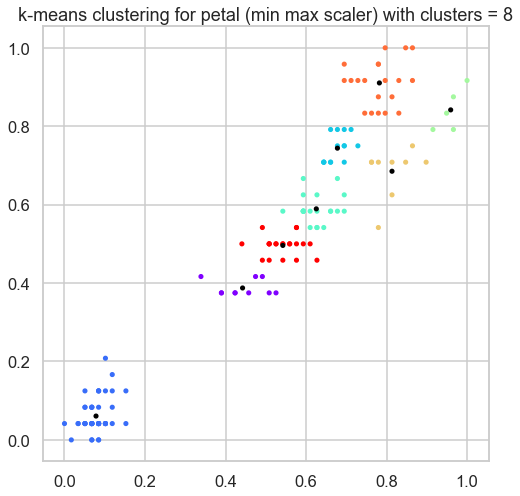

silhouette score for petal with clusters = 9
0.4951699432534474


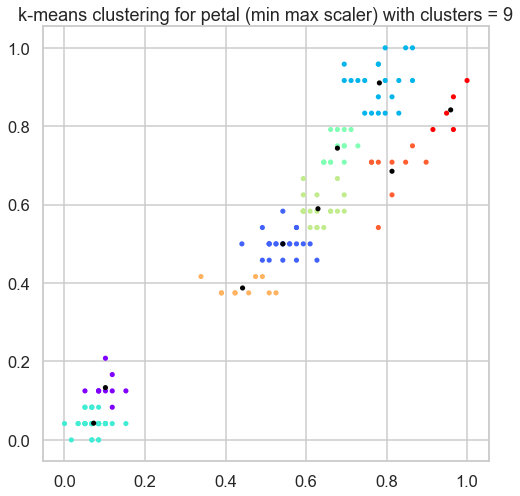

silhouette score for petal with clusters = 10
0.46511922606062683


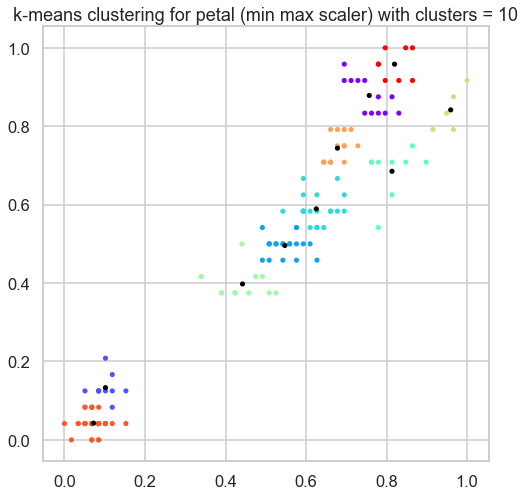

In [112]:
k_variants = [4,5,6,7,8,9,10]

for i in k_variants:
    
    draw_kmeans(i, petal_mms, "k-means clustering for petal (min max scaler) with clusters = {}".format(i),
                "silhouette score for petal with clusters = {}".format(i))

silhouette score for petal with clusters = 4
0.6893944347521515


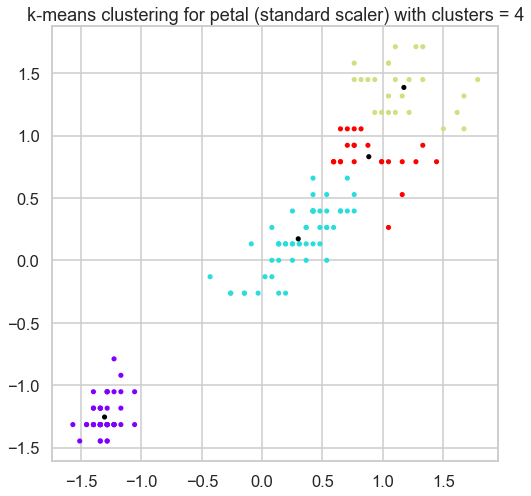

silhouette score for petal with clusters = 5
0.6074993427882871


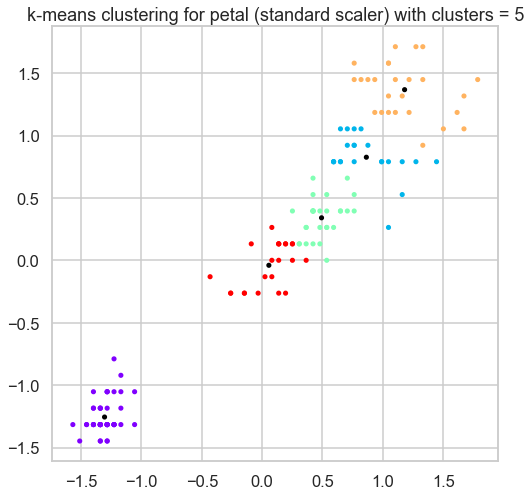

silhouette score for petal with clusters = 6
0.6199407974285055


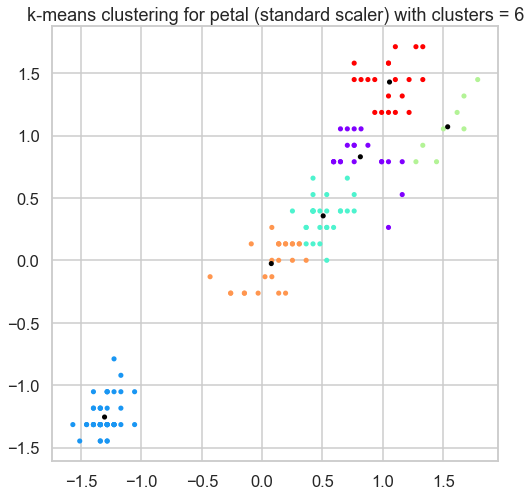

silhouette score for petal with clusters = 7
0.6084754031770088


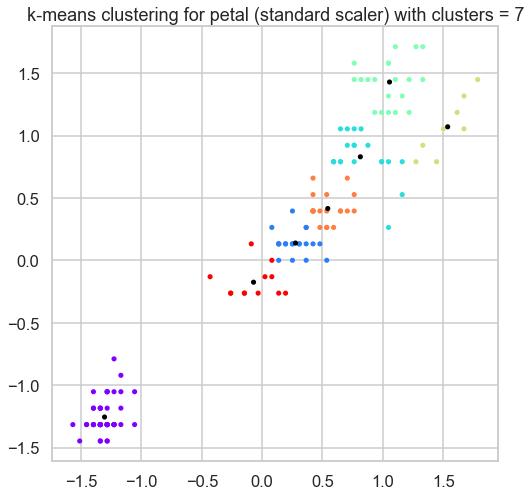

silhouette score for petal with clusters = 8
0.6104684483395283


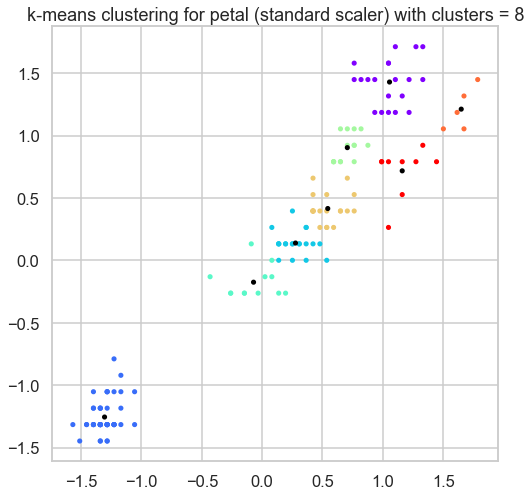

silhouette score for petal with clusters = 9
0.48934634903907864


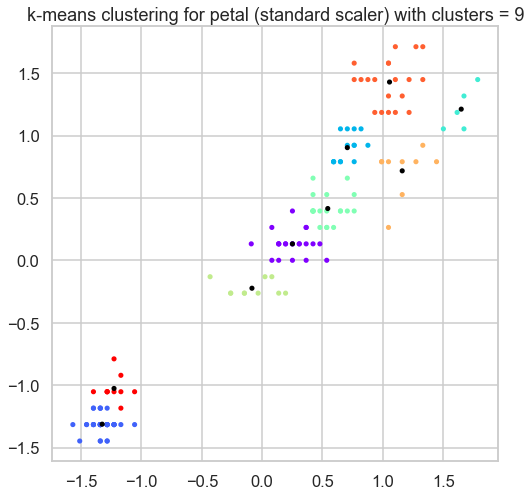

silhouette score for petal with clusters = 10
0.46364673562831316


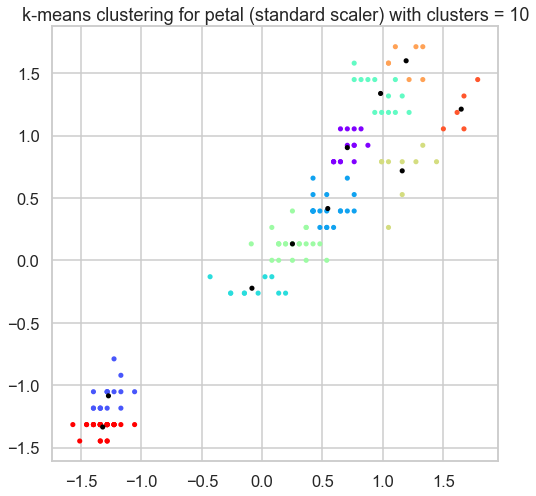

In [113]:
k_variants = [4,5,6,7,8,9,10]

for i in k_variants:
    
    draw_kmeans(i, petal_ss, "k-means clustering for petal (standard scaler) with clusters = {}".format(i),
                "silhouette score for petal with clusters = {}".format(i))

# DB Scan for normalized iris data

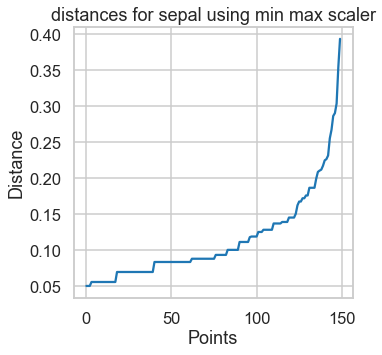

In [114]:
draw_dbscan_dist(sepal_mms, "distances for sepal using min max scaler")
distances_sepal_mms= distances

optimal eps: 0.1672443691498931


<Figure size 360x360 with 0 Axes>

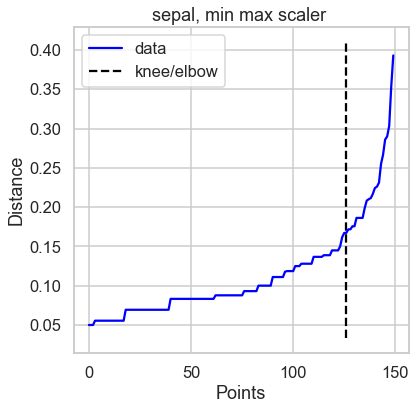

In [115]:
db_optimal_eps(distances_sepal_mms, "sepal, min max scaler ")

Estimated no. of clusters 3: 
Estimated no. of noise points: 17
total number of points: 450 
effeciency : 96.22222222222221
DBSCAN Sepal min max


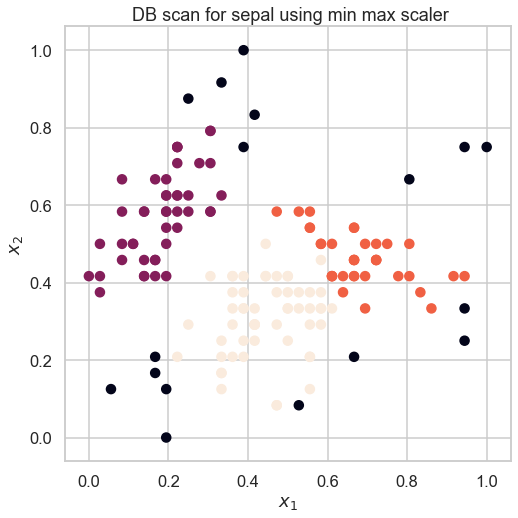

In [125]:
draw_dbscan(sepal_mms, " DB scan for sepal using min max scaler", 0.1672443691498931, 25)
print("DBSCAN Sepal min max")

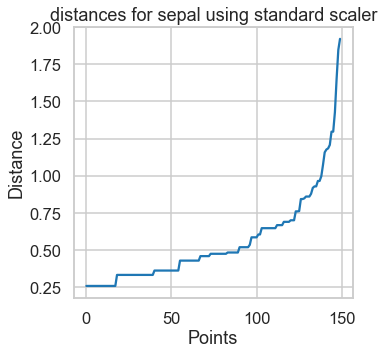

In [116]:
draw_dbscan_dist(sepal_ss, "distances for sepal using standard scaler")
distances_sepal_ss= distances

optimal eps: 0.843695090663109


<Figure size 360x360 with 0 Axes>

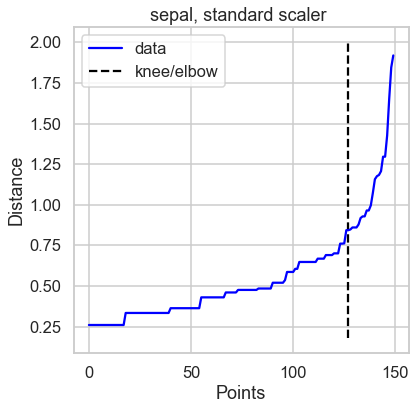

In [117]:
db_optimal_eps(distances_sepal_ss, "sepal, standard scaler ")

Estimated no. of clusters 3: 
Estimated no. of noise points: 5
total number of points: 450 
effeciency : 98.88888888888889
DBSCAN Sepal


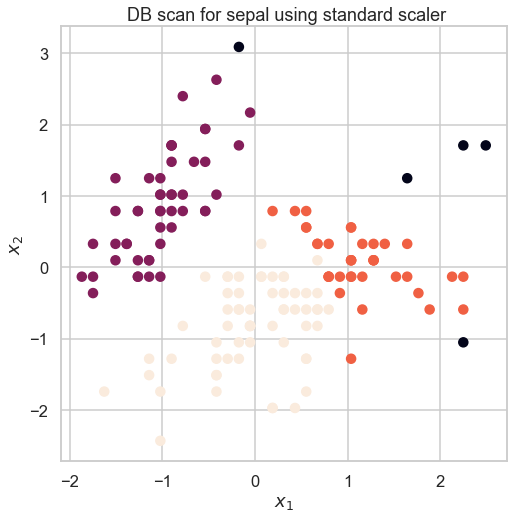

In [126]:
draw_dbscan(sepal_ss, " DB scan for sepal using standard scaler", 0.843695090663109, 10)
print("DBSCAN Sepal")

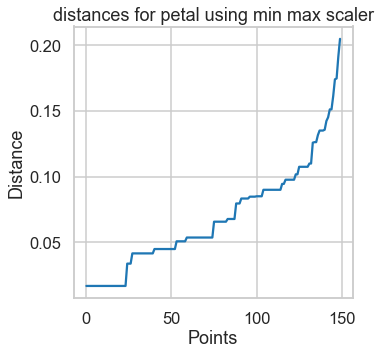

In [118]:
draw_dbscan_dist(petal_mms, "distances for petal using min max scaler")
distances_petal_mms= distances

optimal eps: 0.3478448178925333


<Figure size 360x360 with 0 Axes>

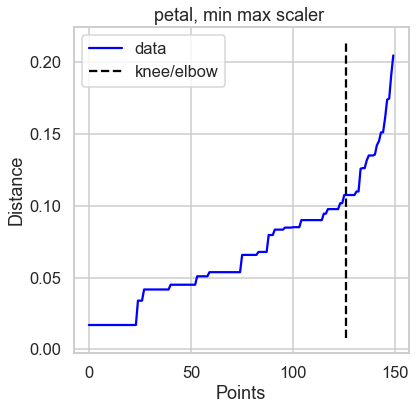

In [120]:
db_optimal_eps(distances_petal_mms, "petal, min max scaler ")

Estimated no. of clusters 3: 
Estimated no. of noise points: 0
total number of points: 450 
effeciency : 100.0


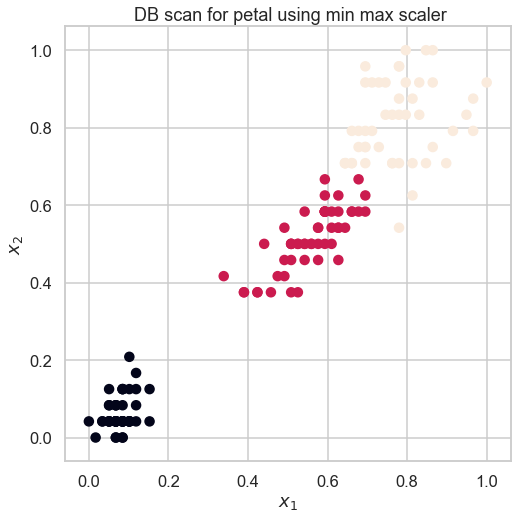

In [127]:
draw_dbscan(petal_mms, " DB scan for petal using min max scaler", 0.3478448178925333, 10)


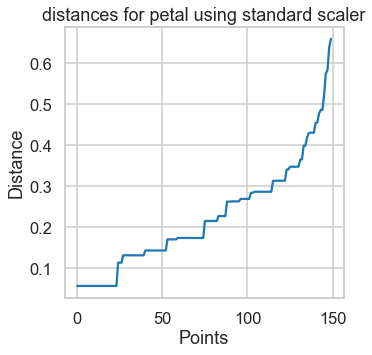

In [121]:
draw_dbscan_dist(petal_ss, "distances for petal using standard scaler")
distances_petal_ss= distances

optimal eps: 0.3478448178925333


<Figure size 360x360 with 0 Axes>

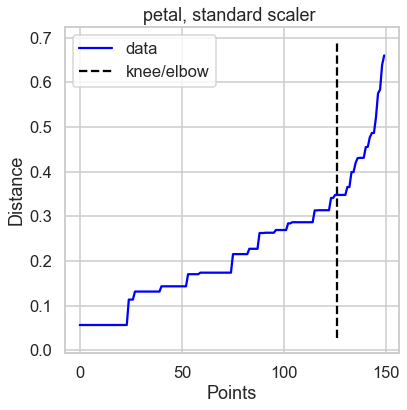

In [122]:
db_optimal_eps(distances_petal_ss, "petal, standard scaler ")

Estimated no. of clusters 3: 
Estimated no. of noise points: 6
total number of points: 450 
effeciency : 98.66666666666667


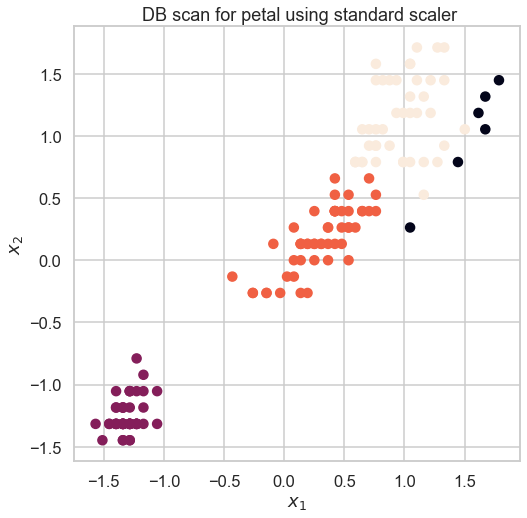

In [128]:
draw_dbscan(petal_ss, " DB scan for petal using standard scaler", 0.3478448178925333, 10)


# Hierarchal Clustering for normalized iris data

In [129]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.metrics import silhouette_score
import scipy.cluster.hierarchy as shc


In [130]:
#to data frames min max scaler
df_sepal_mms = scaler.fit_transform(df_sepal)
df_sepal_mms = pd.DataFrame(df_sepal_mms)

df_petal_mms = scaler.fit_transform(df_petal)
df_petal_mms = pd.DataFrame(df_petal_mms)
#data frames standard scaler

df_sepal_ss = scaler2.fit_transform(df_sepal)
df_sepal_ss = pd.DataFrame(df_sepal_ss)

df_petal_ss = scaler2.fit_transform(df_petal)
df_petal_ss = pd.DataFrame(df_petal_ss)

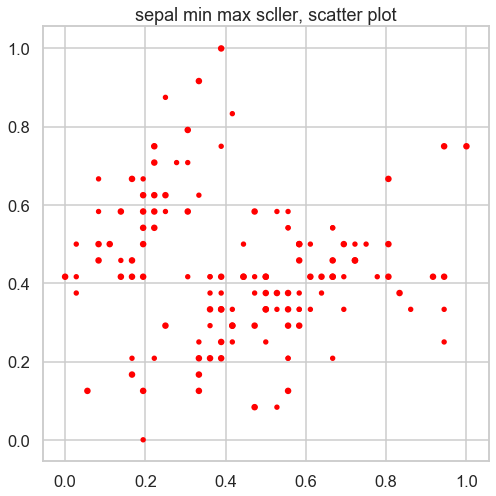

In [142]:
draw_scatter(df_sepal_mms, 0, 1, "sepal min max scller, scatter plot")

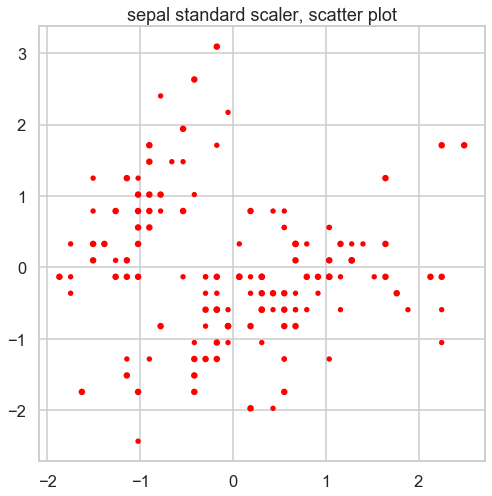

In [143]:
draw_scatter(df_sepal_ss, 0, 1, "sepal standard scaler, scatter plot")

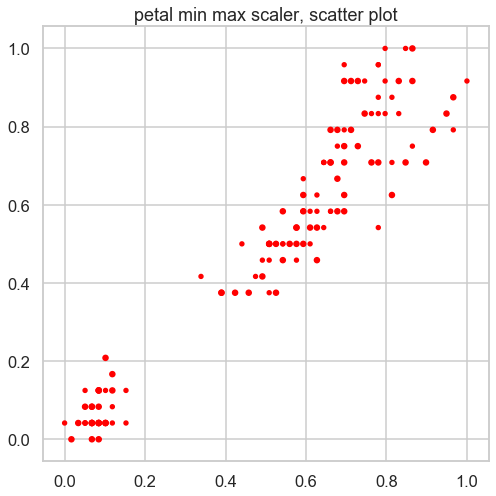

In [144]:
draw_scatter(df_petal_mms, 0, 1, "petal min max scaler, scatter plot")

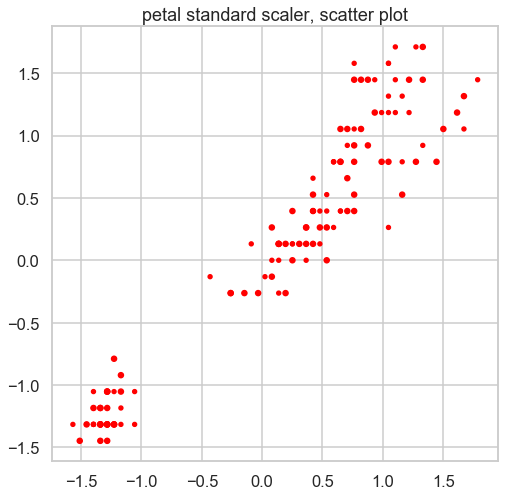

In [145]:
draw_scatter(df_petal_ss, 0, 1, "petal standard scaler, scatter plot")

In [131]:


arr_aff = ["l1", "l2", "manhattan", "cosine"]
arr_link = [ "single", "average"]

df_sepal_mms = df_sepal_mms.rename(columns={"sepal length (cm)":0, "sepal width (cm)":1})
df_petal_mms = df_petal_mms.rename(columns={"petal length (cm)":0, "petal width (cm)":1})
clust = []


 Affinity = l1 , against linkage = single


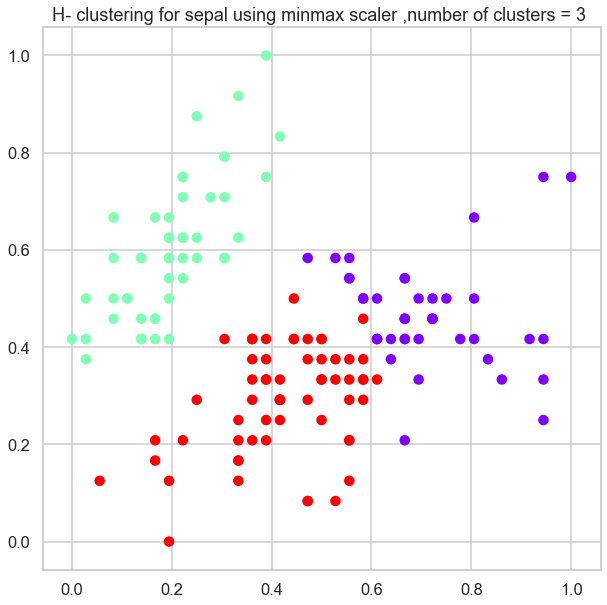

 Affinity = l1 , against linkage = average


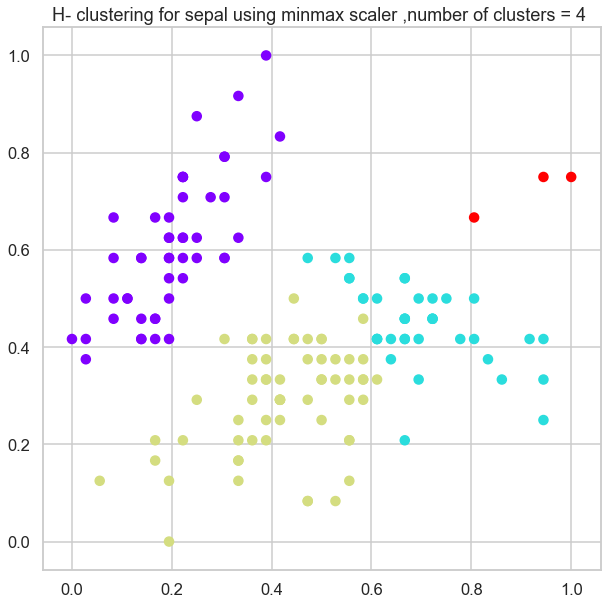

 Affinity = l2 , against linkage = single


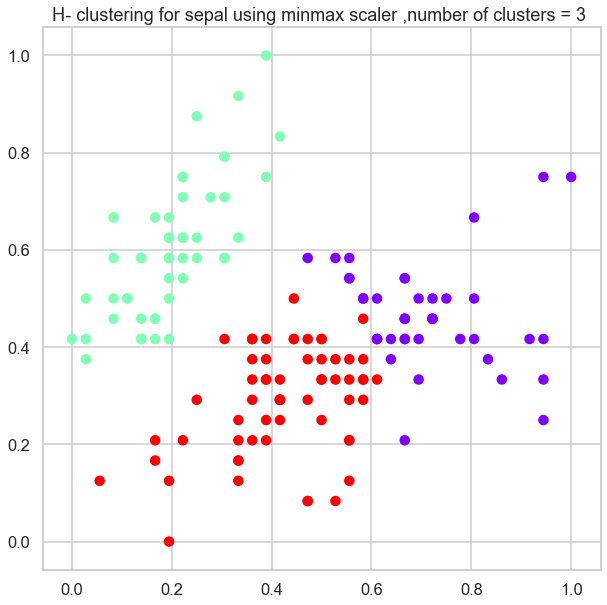

 Affinity = l2 , against linkage = average


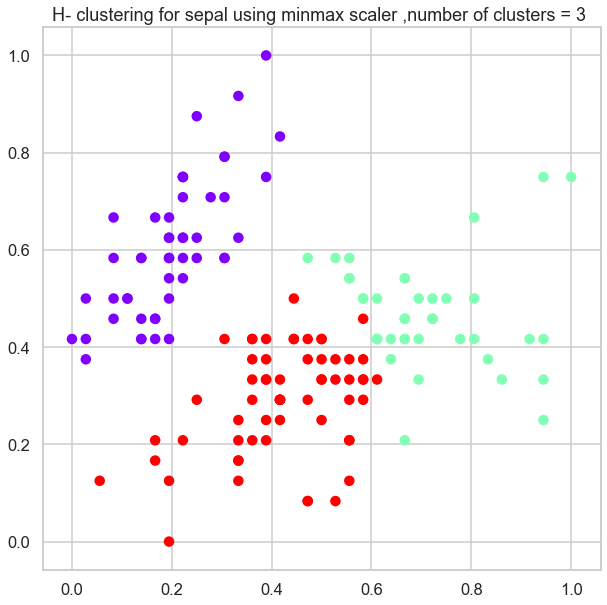

 Affinity = manhattan , against linkage = single


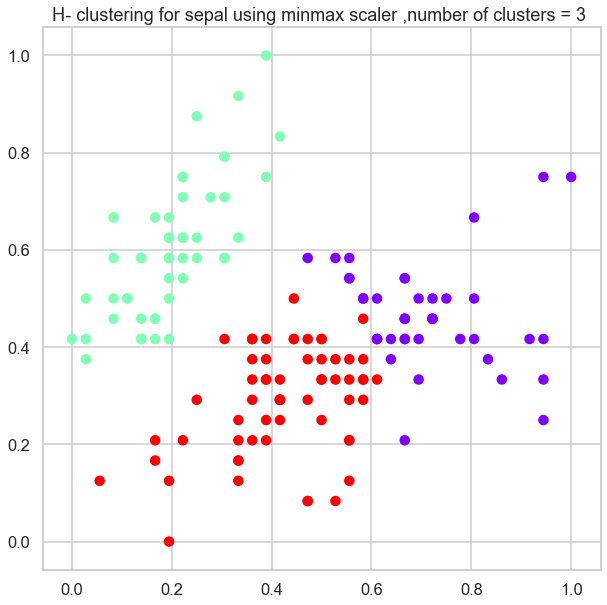

 Affinity = manhattan , against linkage = average


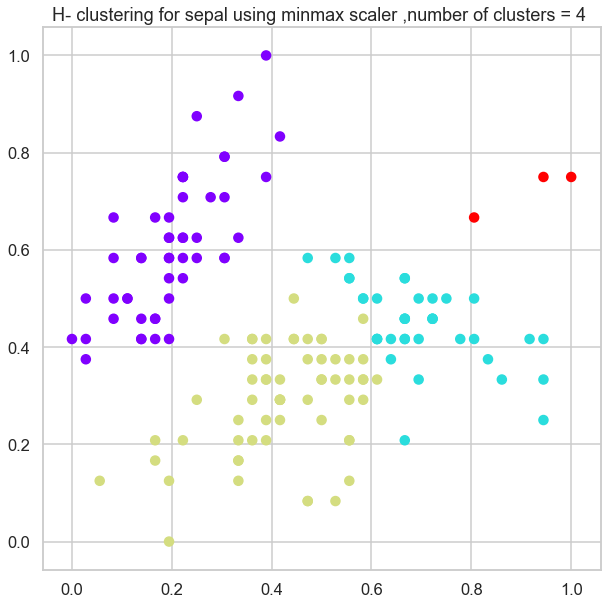

 Affinity = cosine , against linkage = single


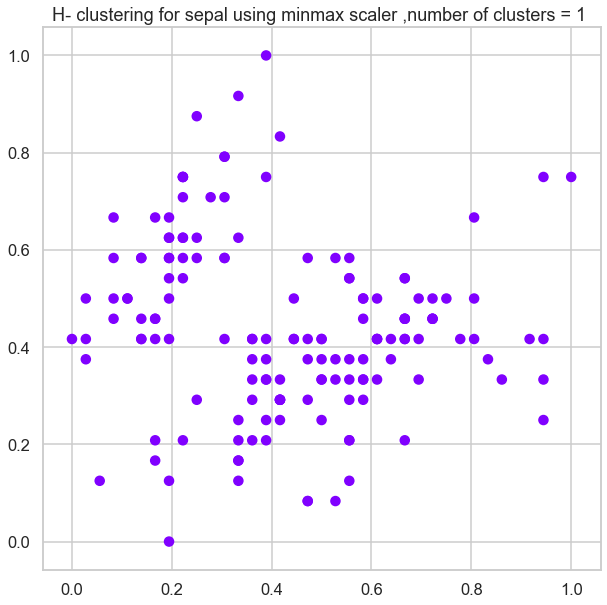

 Affinity = cosine , against linkage = average


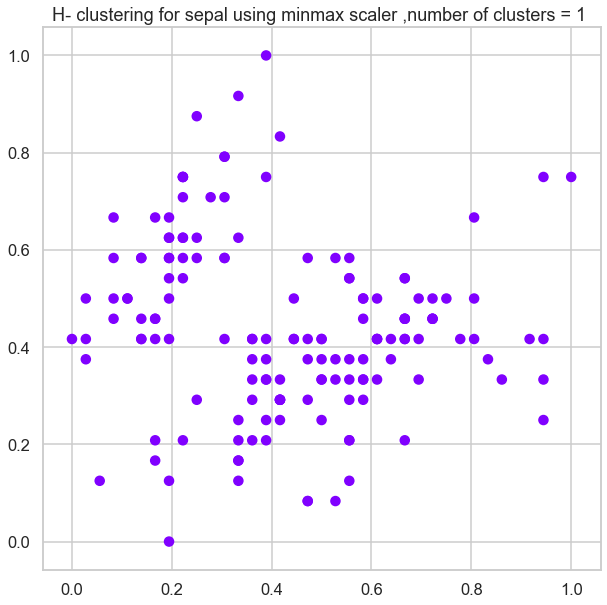

In [134]:
for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df_sepal_mms, "H- clustering for sepal using minmax scaler" )

 Affinity = l1 , against linkage = single


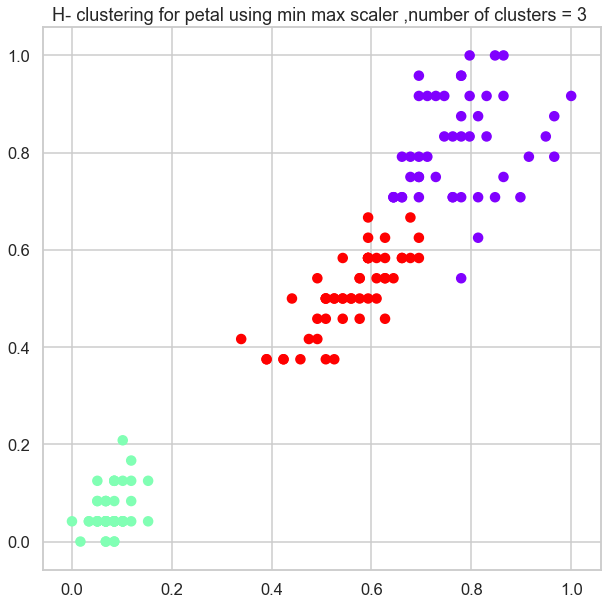

 Affinity = l1 , against linkage = average


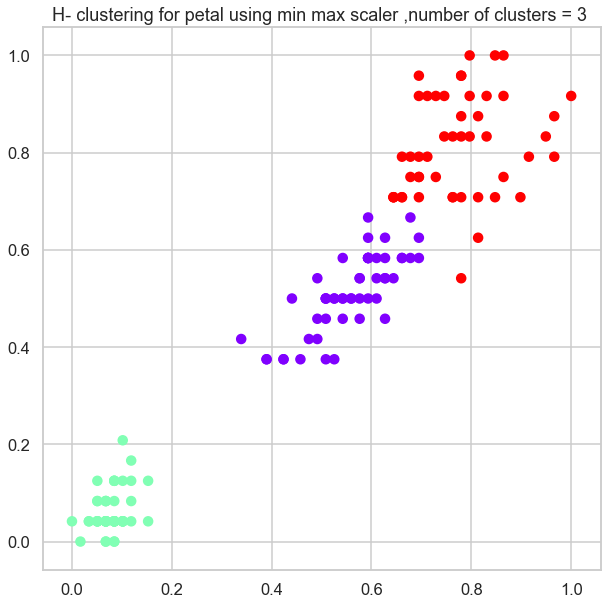

 Affinity = l2 , against linkage = single


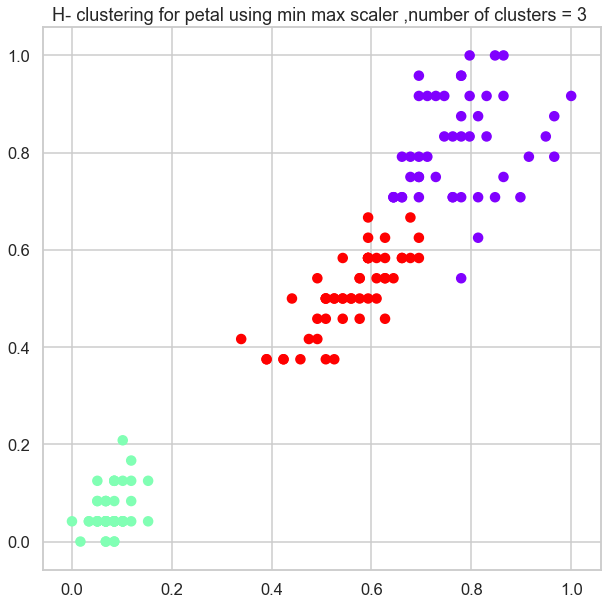

 Affinity = l2 , against linkage = average


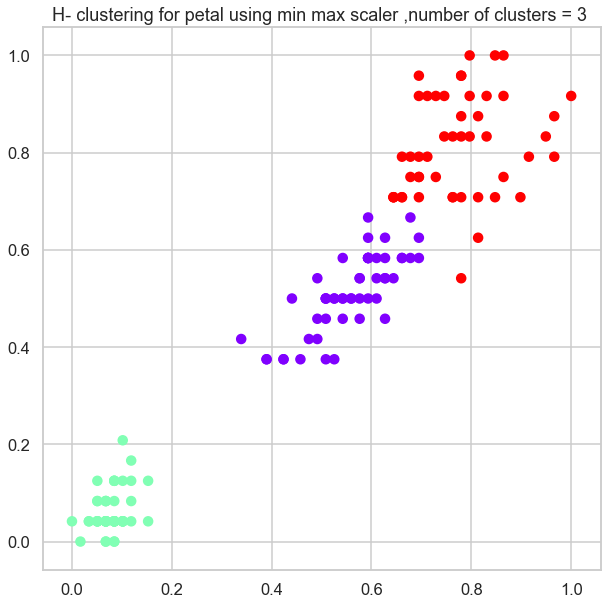

 Affinity = manhattan , against linkage = single


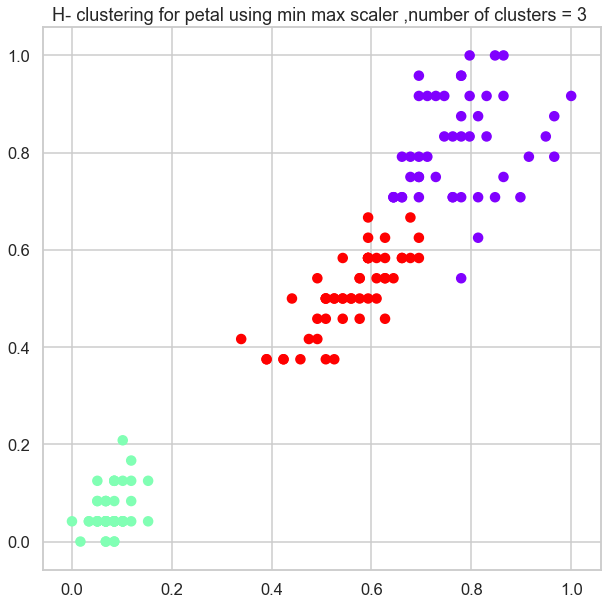

 Affinity = manhattan , against linkage = average


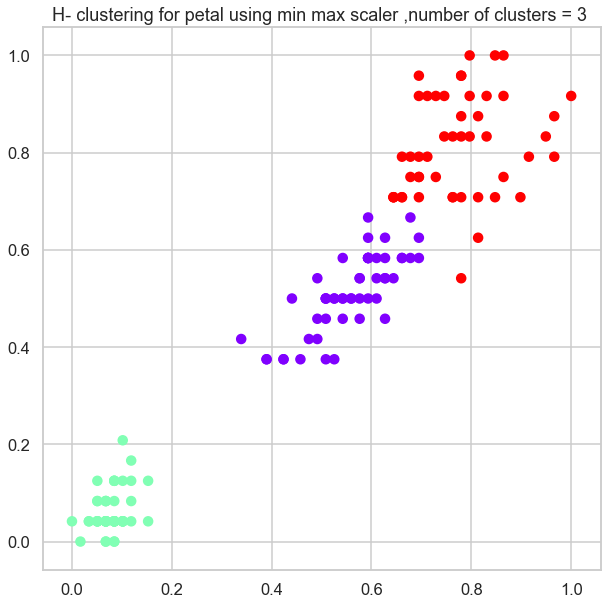

 Affinity = cosine , against linkage = single


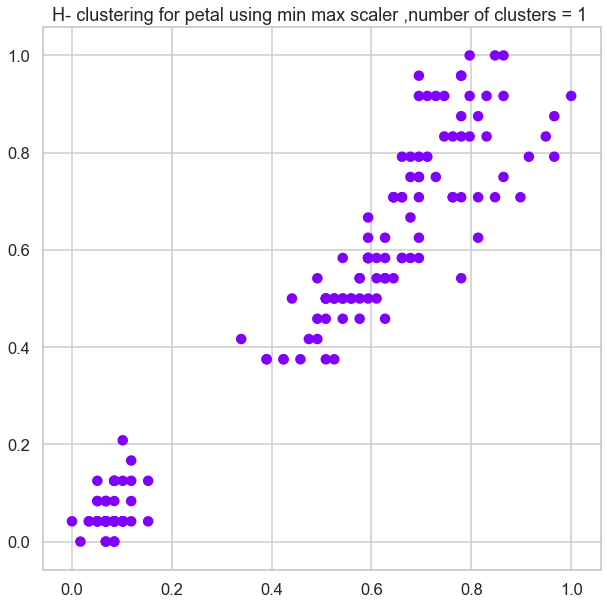

 Affinity = cosine , against linkage = average


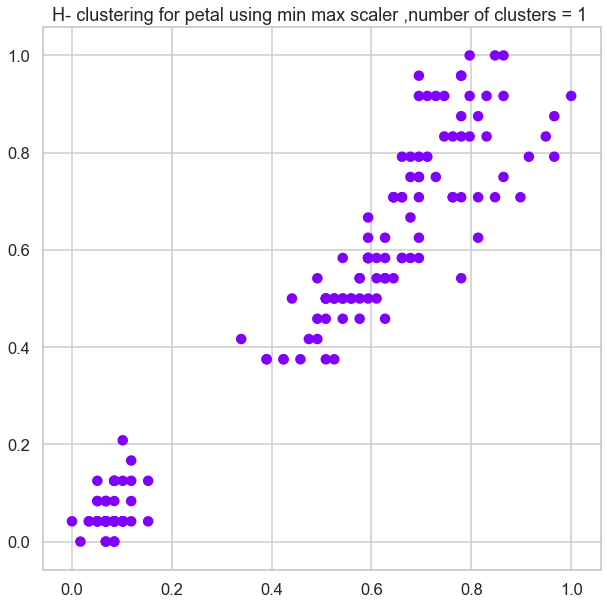

In [133]:
for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df_petal_mms, "H- clustering for petal using min max scaler" )

 Affinity = l1 , against linkage = single


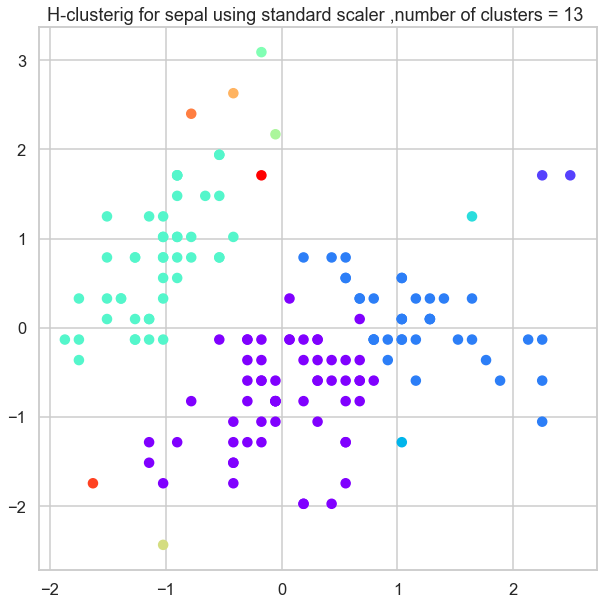

 Affinity = l1 , against linkage = average


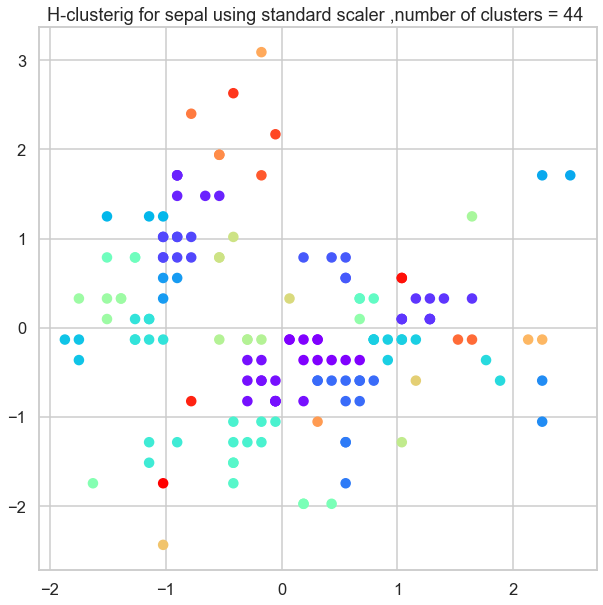

 Affinity = l2 , against linkage = single


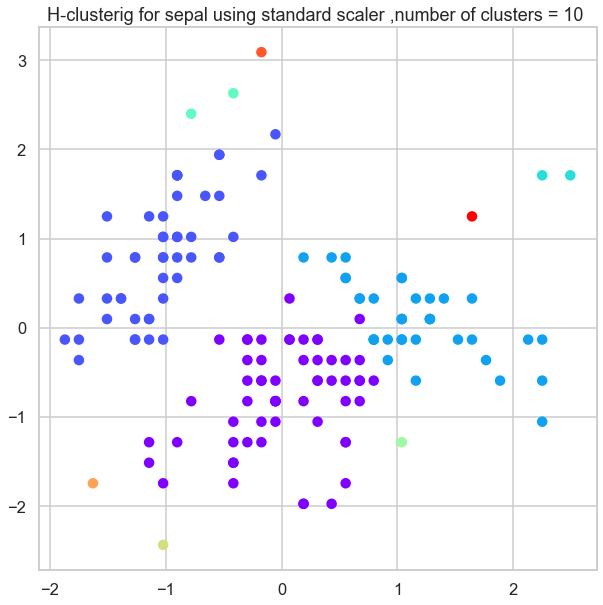

 Affinity = l2 , against linkage = average


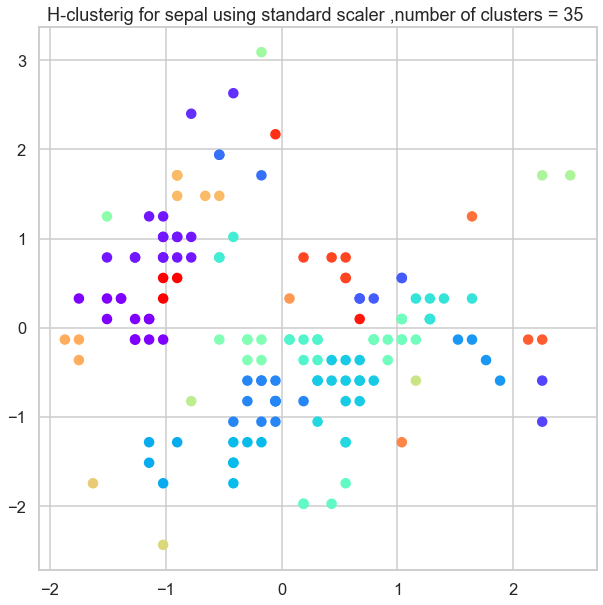

 Affinity = manhattan , against linkage = single


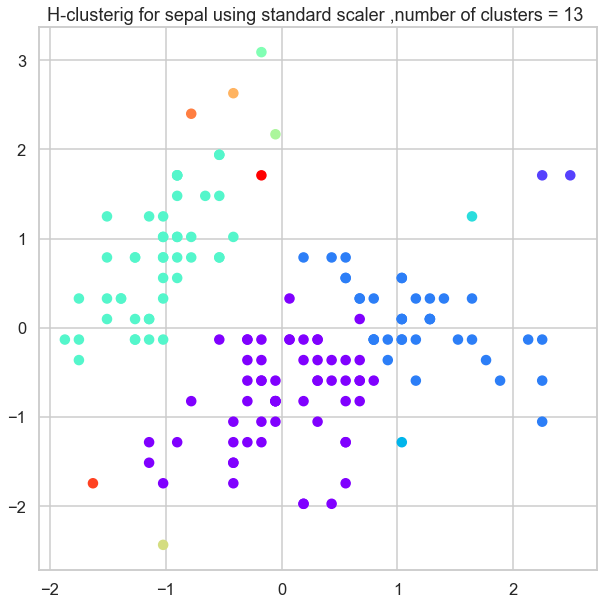

 Affinity = manhattan , against linkage = average


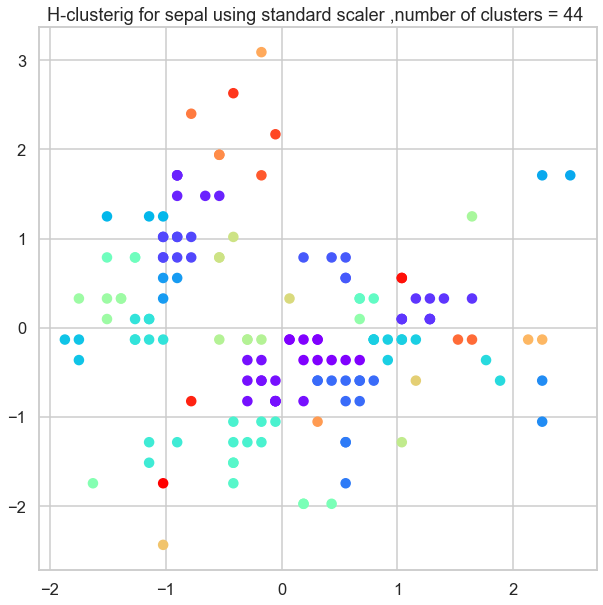

 Affinity = cosine , against linkage = single


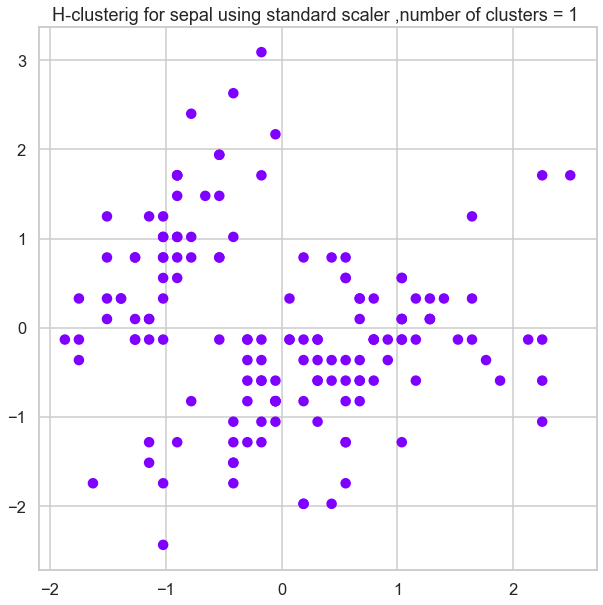

 Affinity = cosine , against linkage = average


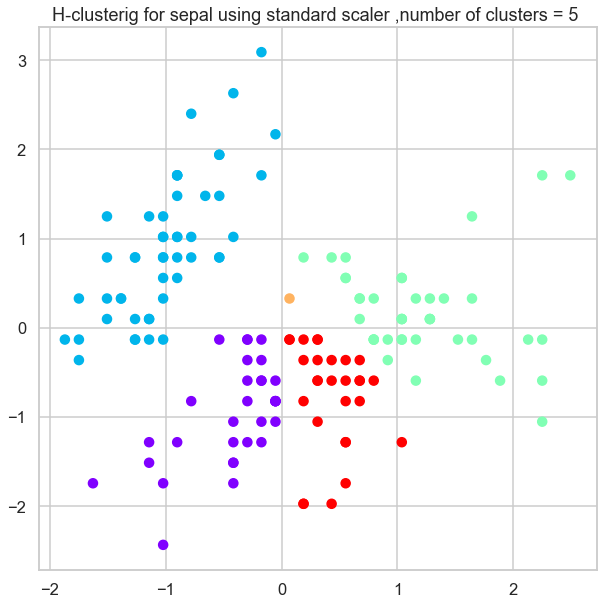

In [135]:
for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df_sepal_ss, "H-clusterig for sepal using standard scaler" )

 Affinity = l1 , against linkage = single


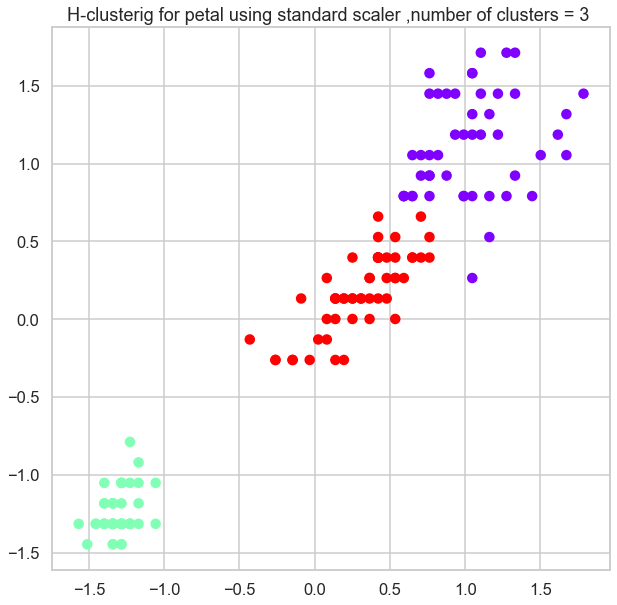

 Affinity = l1 , against linkage = average


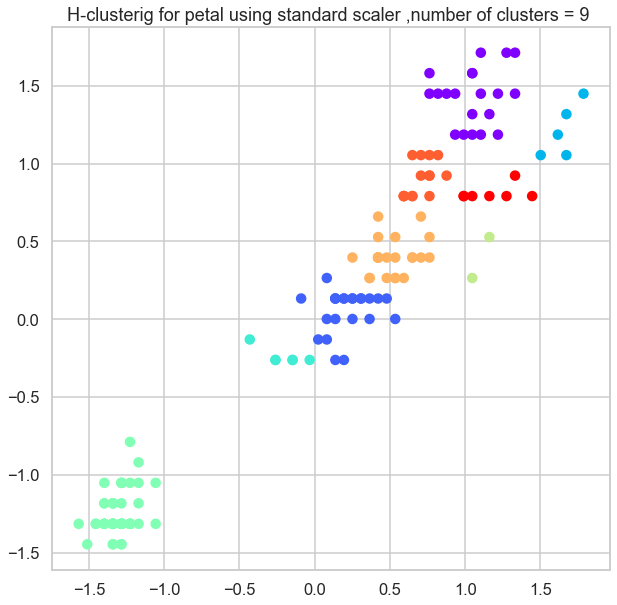

 Affinity = l2 , against linkage = single


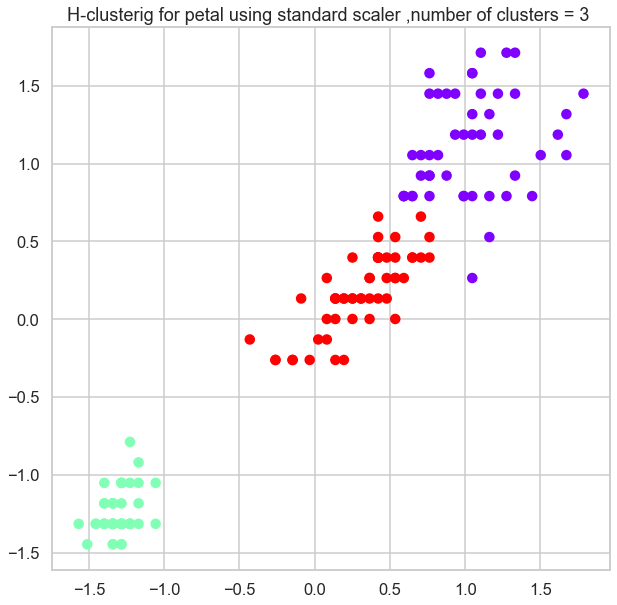

 Affinity = l2 , against linkage = average


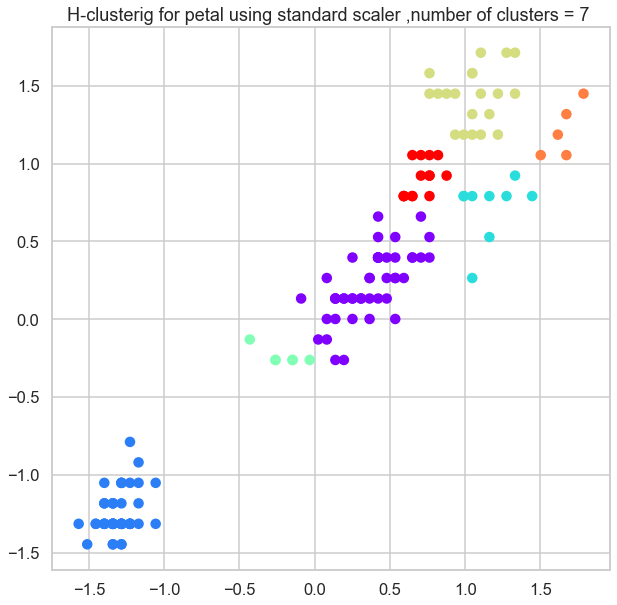

 Affinity = manhattan , against linkage = single


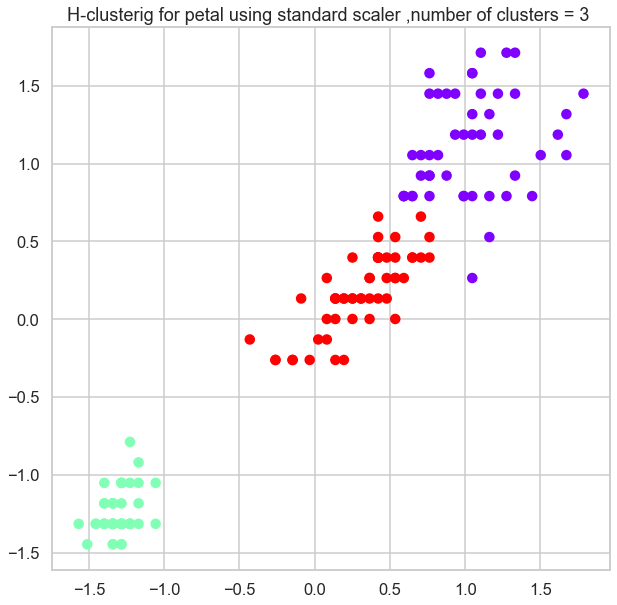

 Affinity = manhattan , against linkage = average


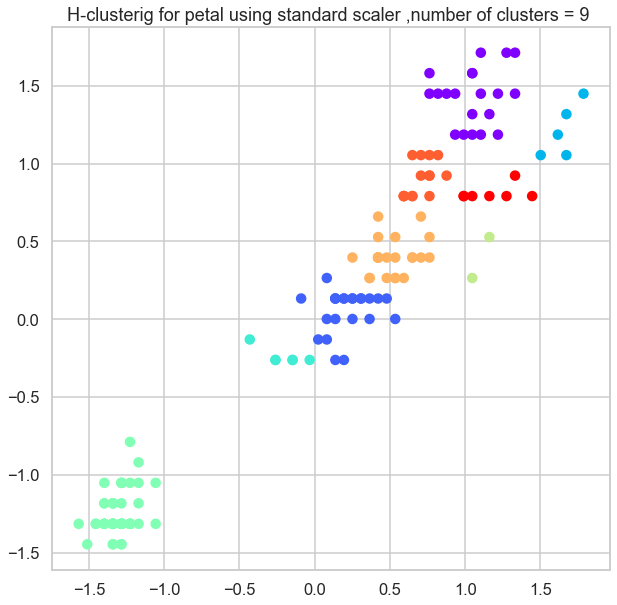

 Affinity = cosine , against linkage = single


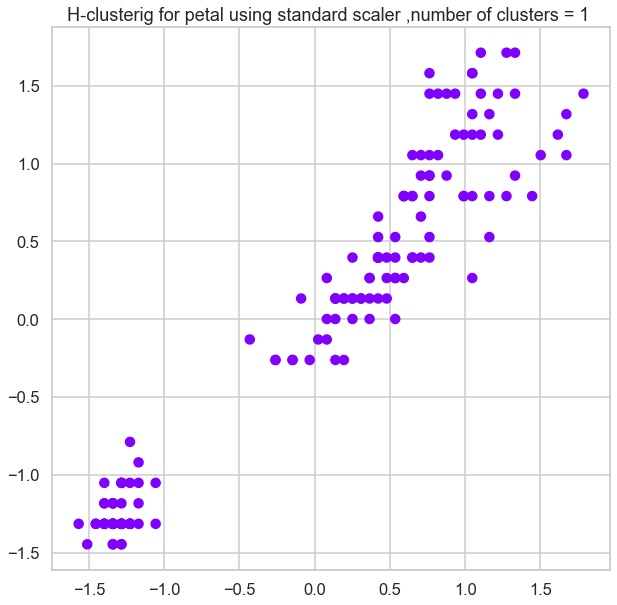

 Affinity = cosine , against linkage = average


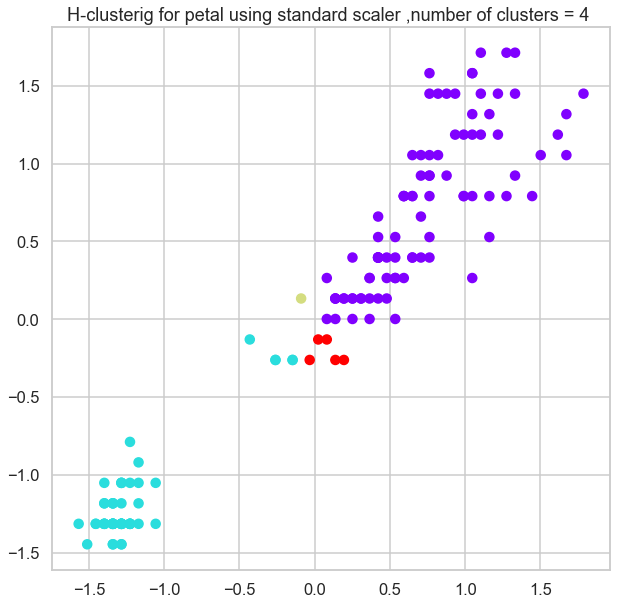

In [136]:
for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df_petal_ss, "H-clusterig for petal using standard scaler" )

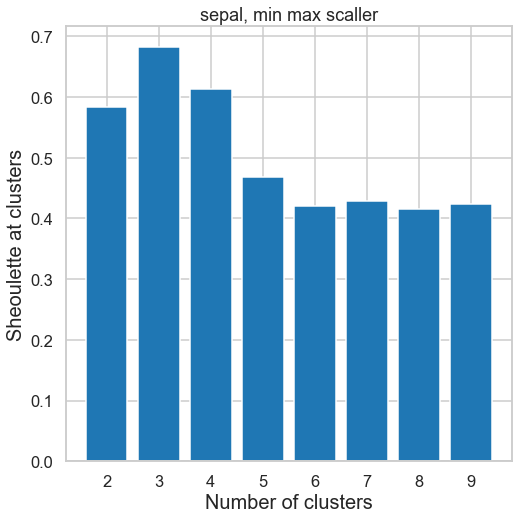

In [137]:
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df_sepal_mms)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("sepal, min max scaller")
plt.show()

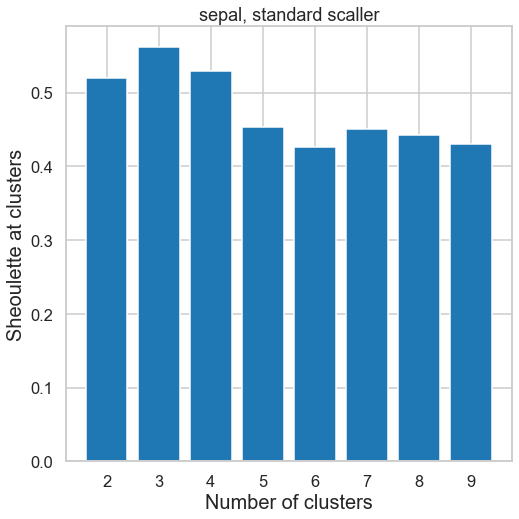

In [138]:
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df_sepal_ss)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("sepal, standard scaller")
plt.show()

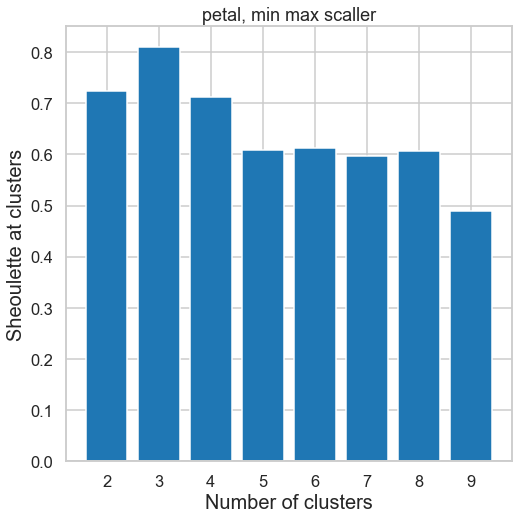

In [139]:
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df_petal_mms)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("petal, min max scaller")
plt.show()

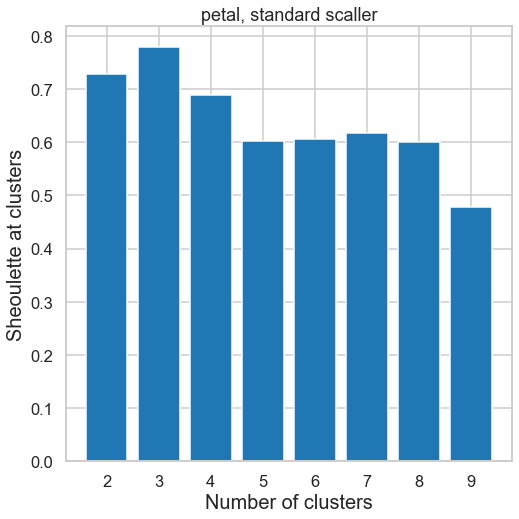

In [140]:
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df_petal_ss)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("petal, standard scaller")
plt.show()

# Gaussian mixture for normalized iris data

lower bound: 6.528860451995919
full


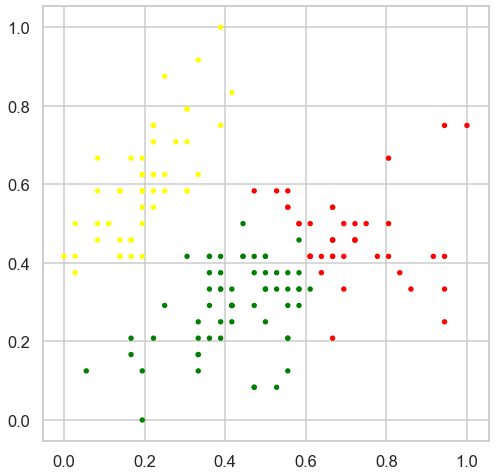

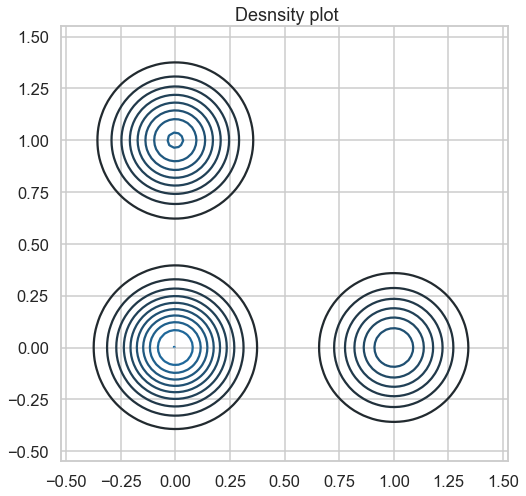

lower bound: 12.395327396611652
tied


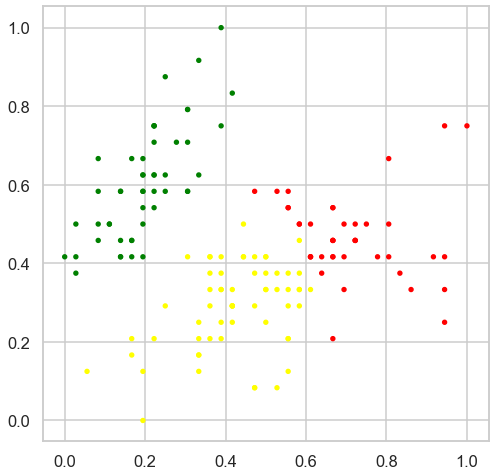

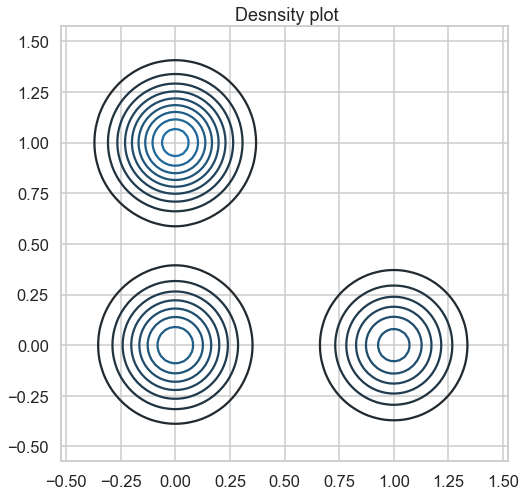

lower bound: 12.356459316964482
diag


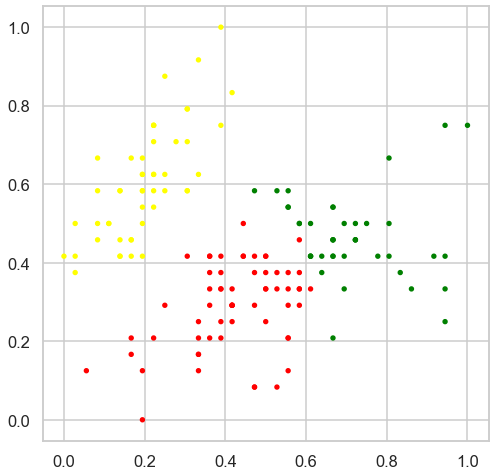

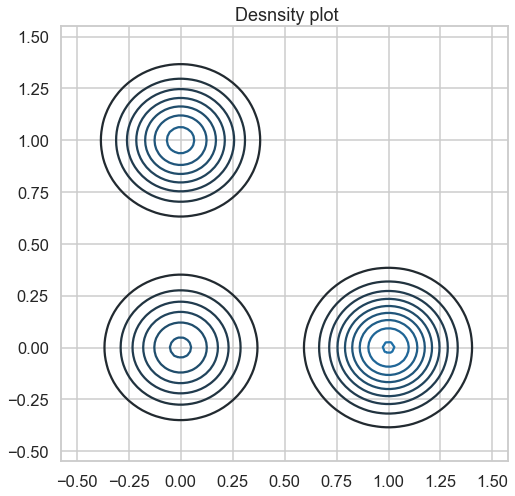

lower bound: 3.16770975179095
spherical


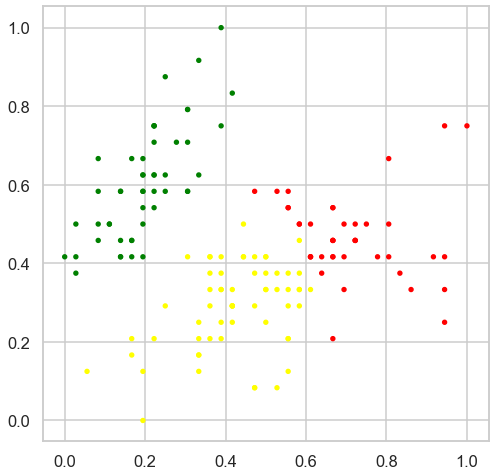

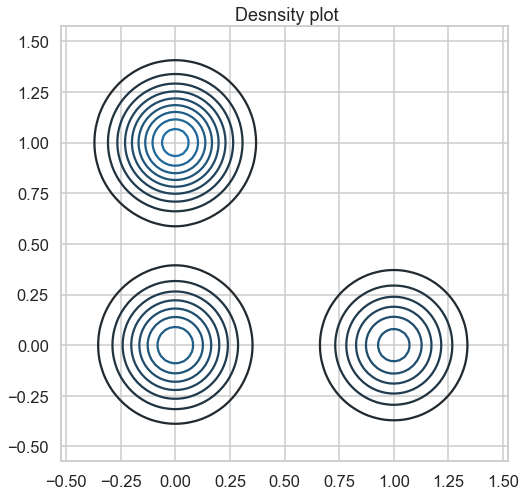

In [146]:
k = ["full", "tied", "diag", "spherical"]
for i in k:
    draw3(i, df_sepal_mms)

lower bound: 3.3466868599613386
full


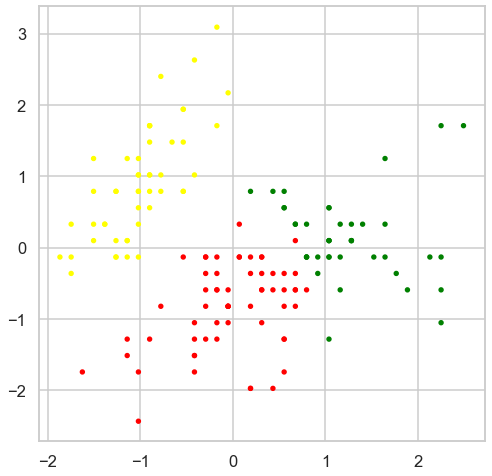

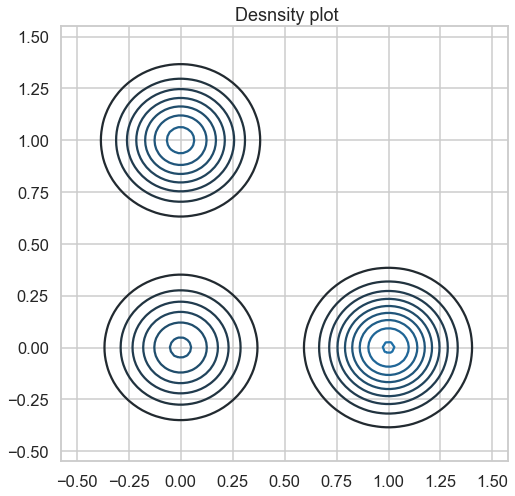

lower bound: 9.21315379697135
tied


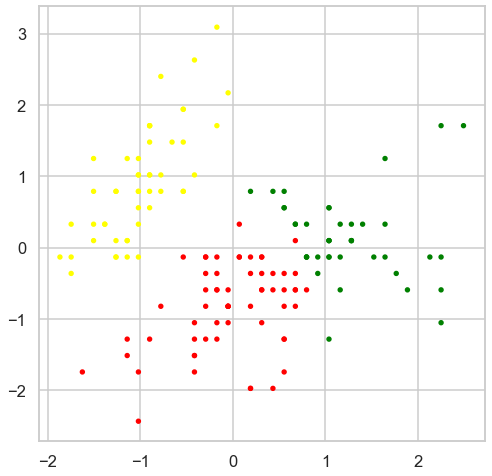

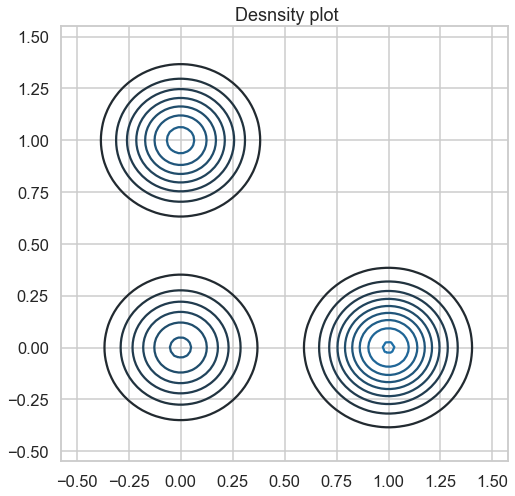

lower bound: 9.174285717118018
diag


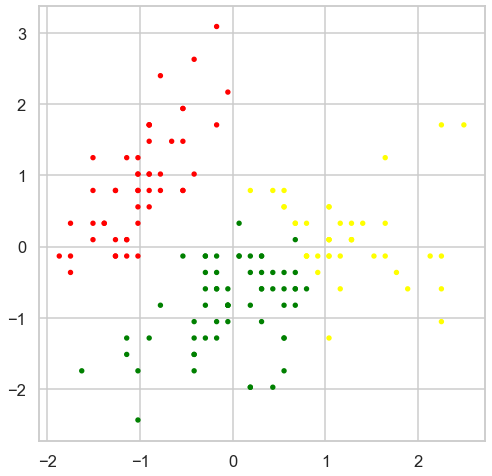

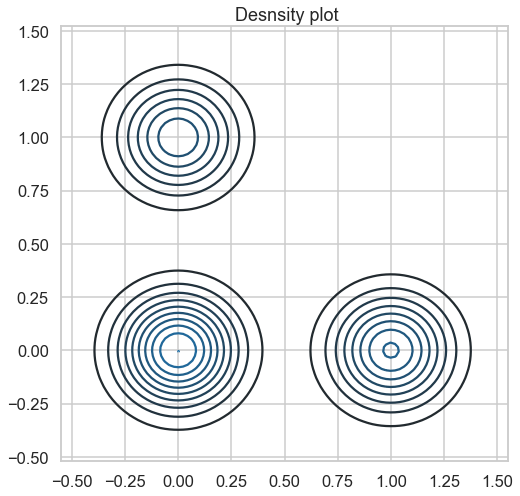

lower bound: -3.2652495023011467
spherical


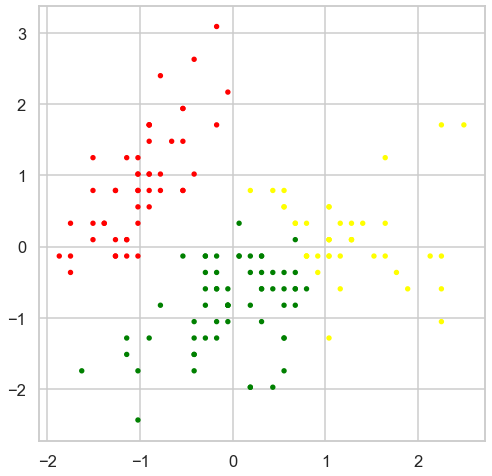

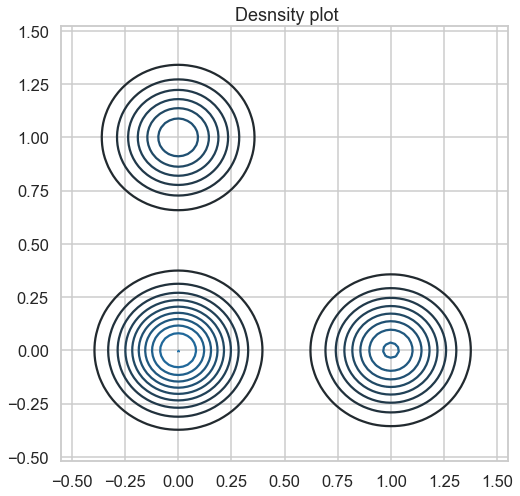

In [147]:
k = ["full", "tied", "diag", "spherical"]
for i in k:
    draw3(i, df_sepal_ss)

lower bound: 7.707035054339657
full


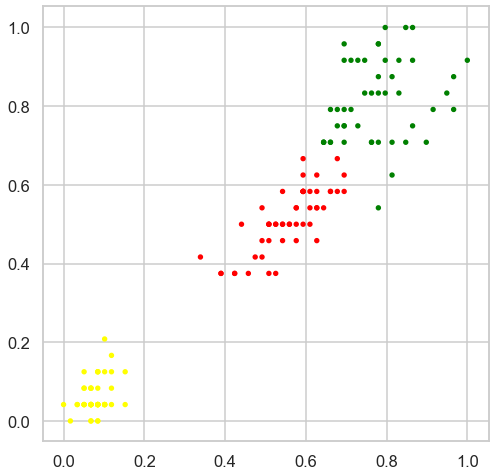

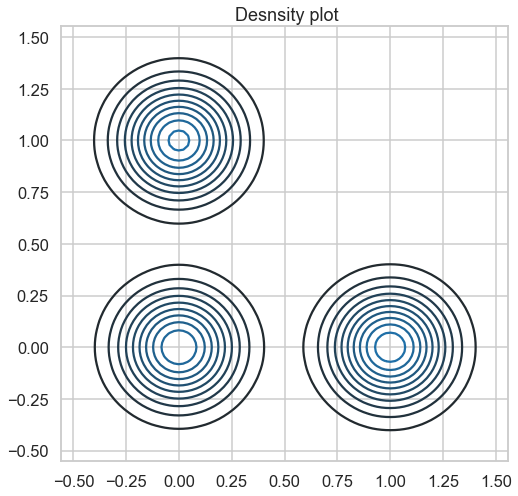

lower bound: 13.320721235408968
tied


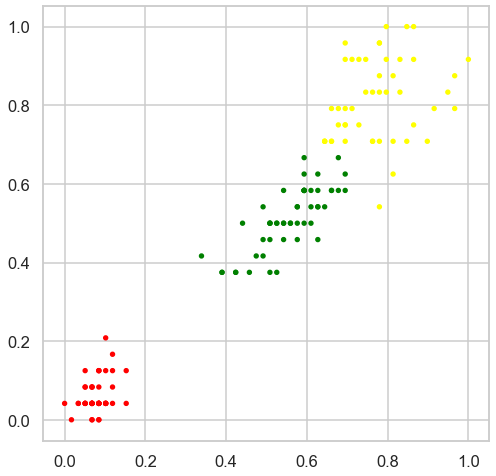

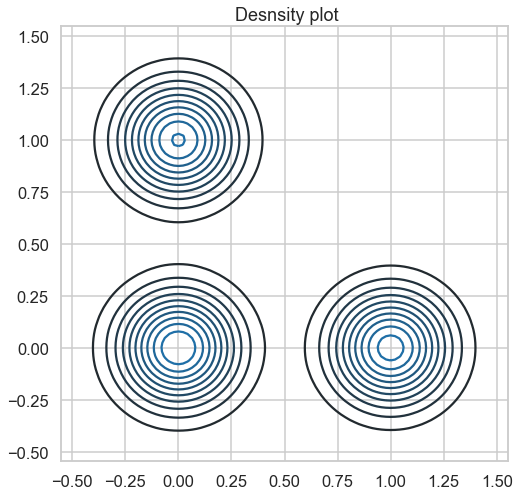

lower bound: 13.503294812778256
diag


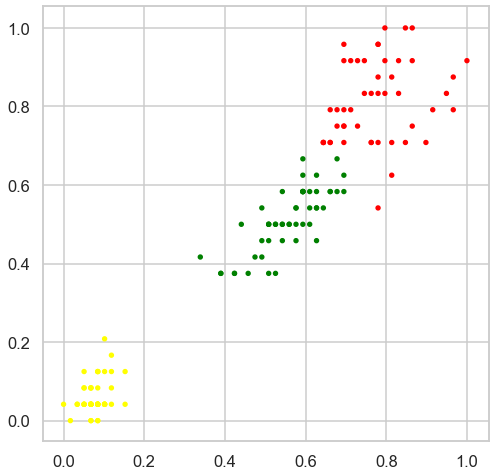

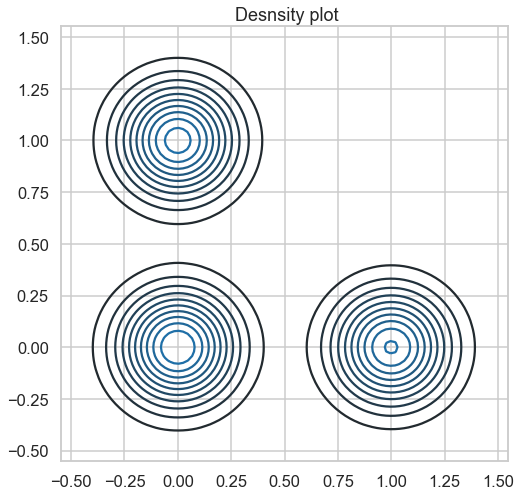

lower bound: 5.476937379886432
spherical


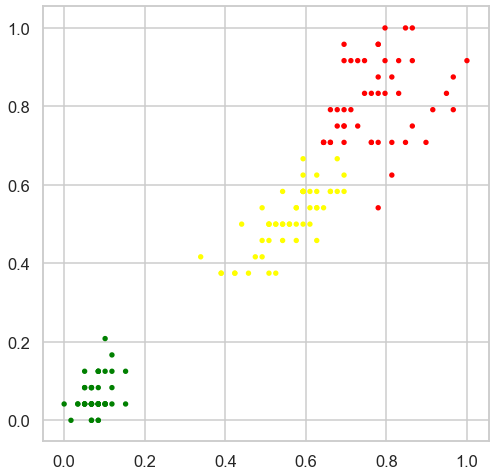

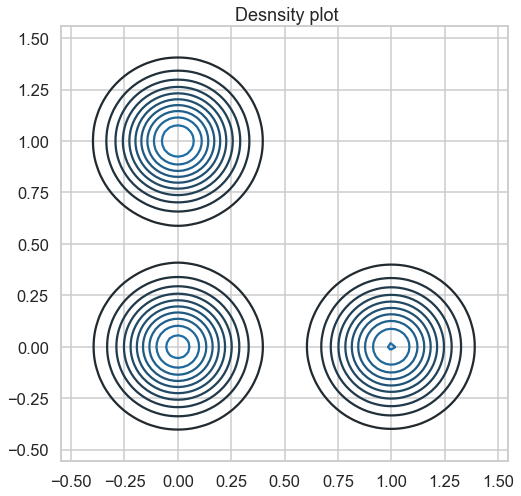

In [148]:
k = ["full", "tied", "diag", "spherical"]
for i in k:
    draw3(i, df_petal_mms)

lower bound: 5.346747988060317
full


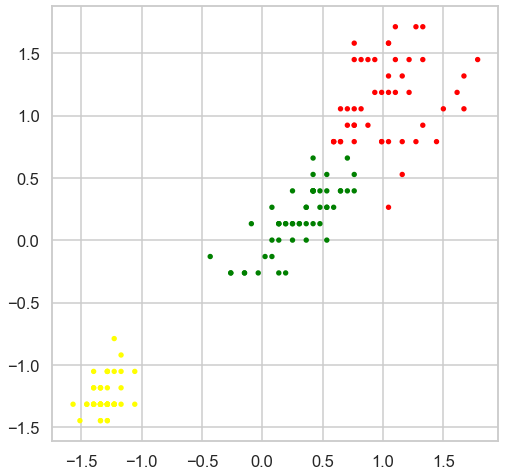

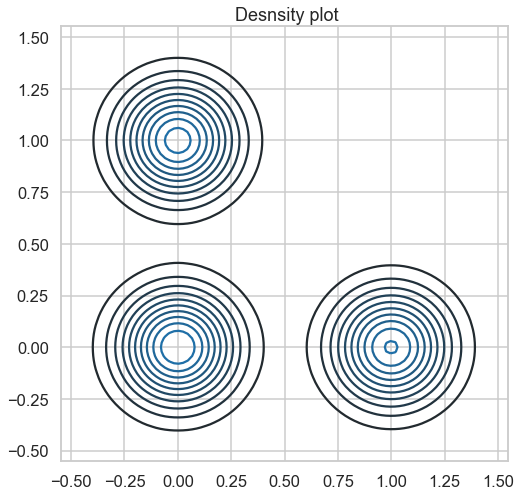

lower bound: 10.96043396577983
tied


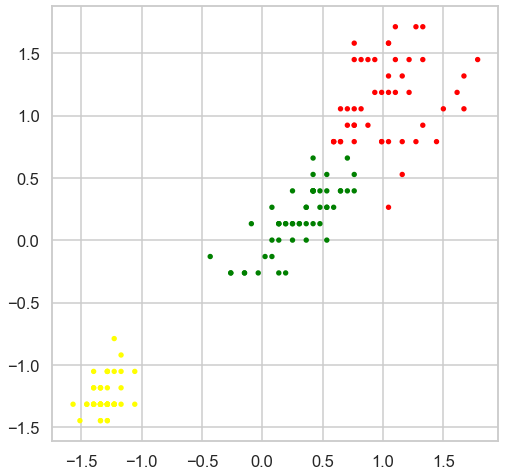

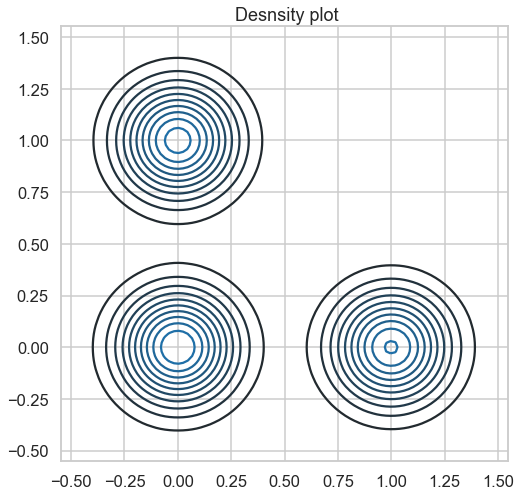

lower bound: 11.143007656554182
diag


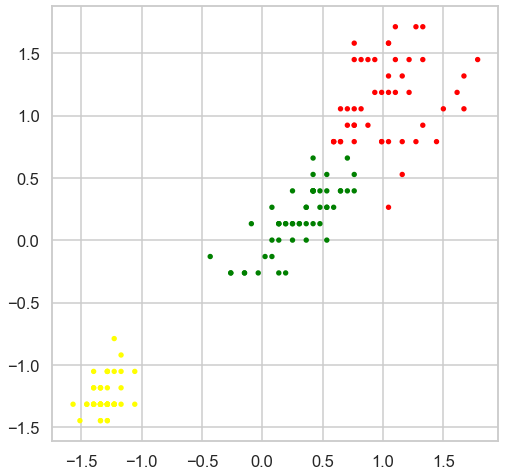

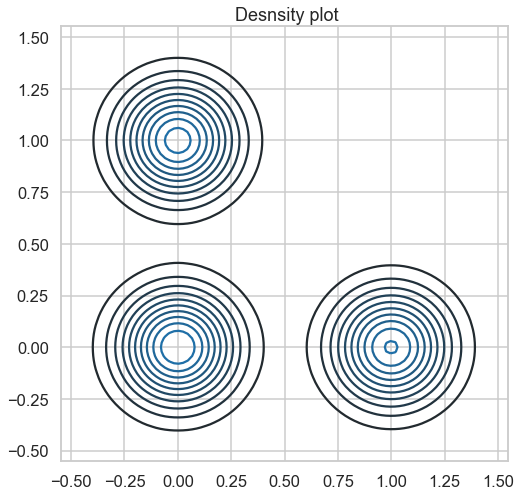

lower bound: 0.7729105633472481
spherical


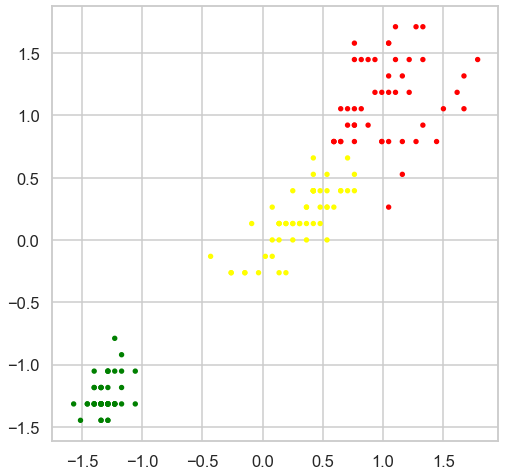

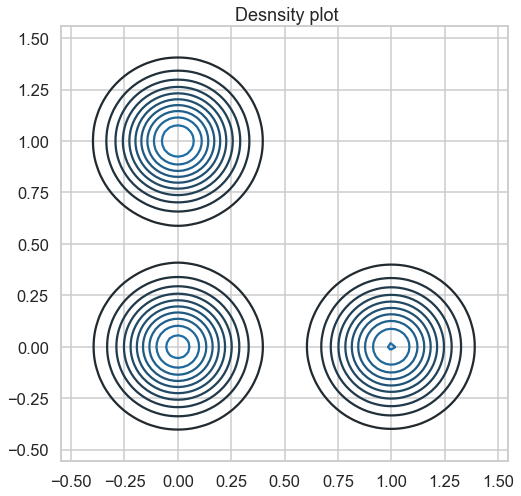

In [149]:
k = ["full", "tied", "diag", "spherical"]
for i in k:
    draw3(i, df_petal_ss)

# Customer data set

# Preparing customer data set

In [151]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.datasets import make_moons

In [152]:
data = pd.read_csv('Customer_data.csv')
data = pd.DataFrame(data)
data.head()

,ID,Sex,Marital status,Age,Education,Income,Occupation,Settlement size
0,100000001,0,0,67,2,124670,1,2
1,100000002,1,1,22,1,150773,1,2
2,100000003,0,0,49,1,89210,0,0
3,100000004,0,0,45,1,171565,1,1
4,100000005,0,0,53,1,149031,1,1


In [157]:
df = data.filter(['Income','Age'], axis=1)
df_array = np.array(df)
df.head()


,Income,Age
0,124670,67
1,150773,22
2,89210,49
3,171565,45
4,149031,53


# K means for customer data (non normaized)

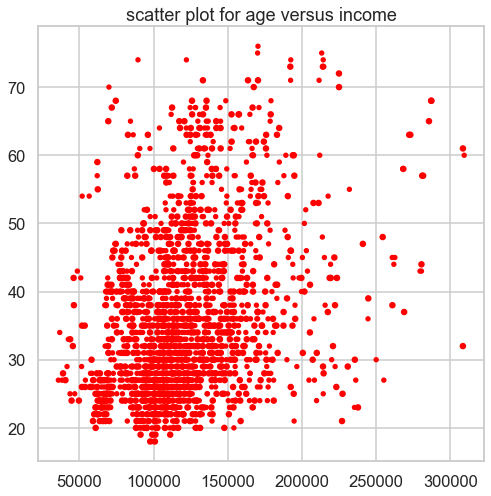

In [155]:
draw_scatter(df, "Income","Age", "scatter plot for age versus income")

Text(0.5, 1.0, 'customer data scatter plot for 6 clusters')

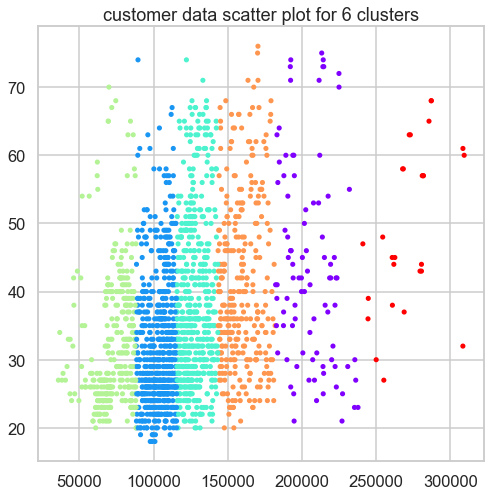

In [158]:
kmeans = KMeans(n_clusters= 6)
kmeans.fit(df_array)
plt.scatter(df_array[:,0],df_array[:,1], c=kmeans.labels_, cmap='rainbow', s= [13,13])
plt.title("customer data scatter plot for 6 clusters")

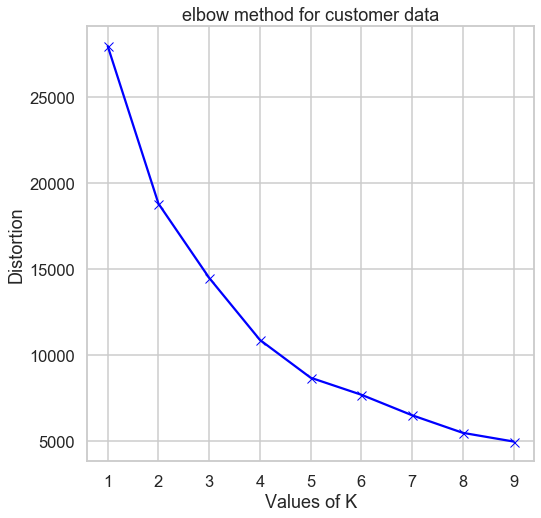

In [161]:
elbow_draw(df_array, "elbow method for customer data")

silhouette score with clusters = 4
0.5428479099705408


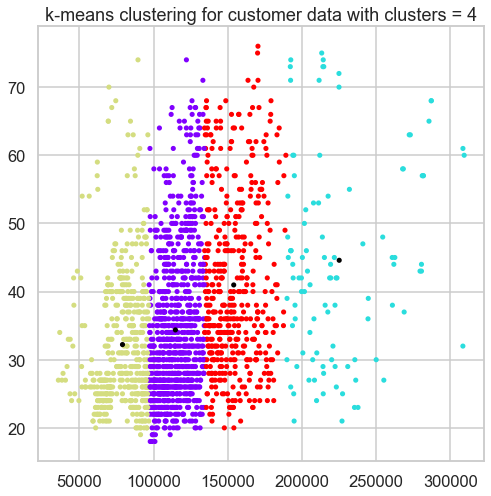

silhouette score with clusters = 5
0.5401520680025738


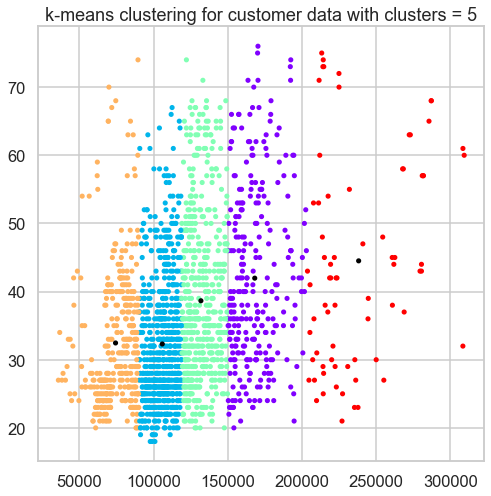

silhouette score with clusters = 6
0.5437793559150387


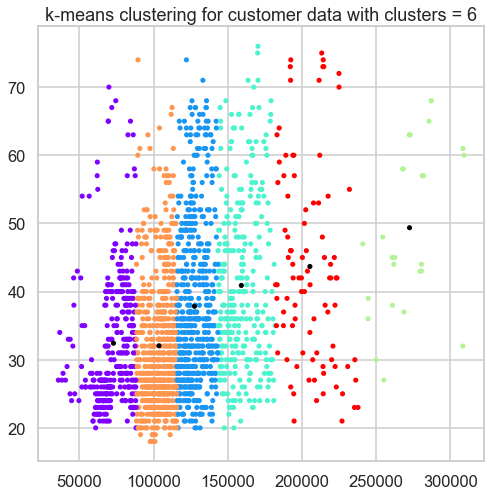

silhouette score with clusters = 7
0.5325741477090951


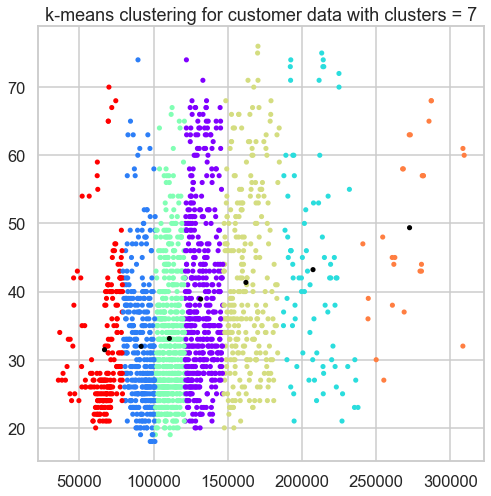

silhouette score with clusters = 8
0.5402053277830295


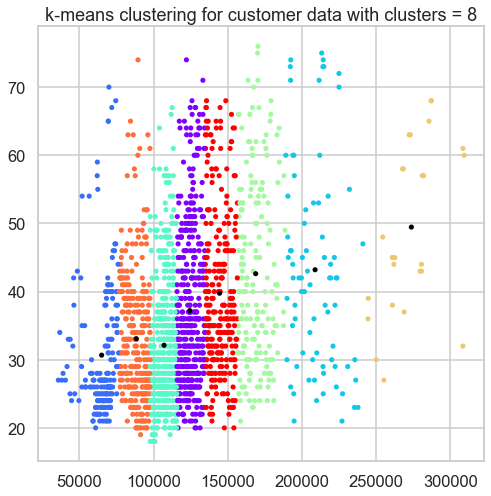

silhouette score with clusters = 9
0.5338224982057904


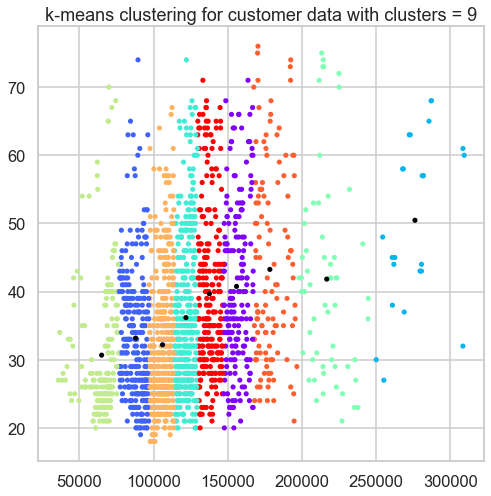

silhouette score with clusters = 10
0.534589411550381


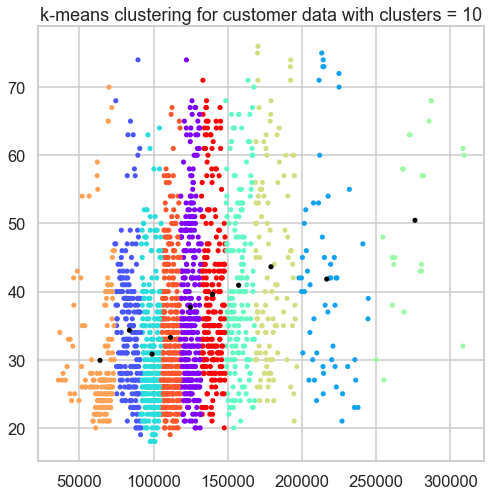

In [162]:
k_variants = [4,5,6,7,8,9,10]

for i in k_variants:
    
    draw_kmeans(i, df_array, "k-means clustering for customer data with clusters = {}".format(i),
                "silhouette score with clusters = {}".format(i))

# DB Scan for customer data (non normalized)

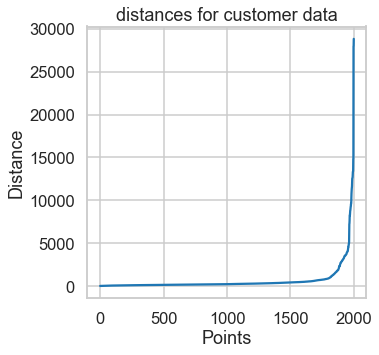

In [163]:

draw_dbscan_dist(df_array, "distances for customer data")
distances_df= distances

optimal eps: 873.2525407921811


<Figure size 360x360 with 0 Axes>

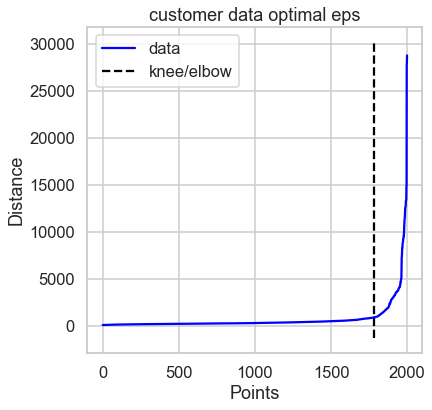

In [164]:
db_optimal_eps(distances_df, "customer data optimal eps")

Estimated no. of clusters 9: 
Estimated no. of noise points: 545
total number of points: 4000 
effeciency : 86.375


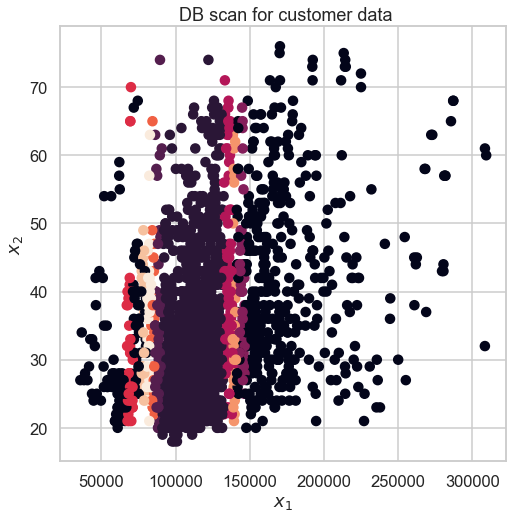

In [206]:
draw_dbscan(df_array, " DB scan for customer data", 873.2525407921811, 25)


# Hierarchal Clustering for customer data set

In [166]:

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from sklearn.preprocessing import StandardScaler, normalize
from sklearn.metrics import silhouette_score
import scipy.cluster.hierarchy as shc
from scipy.cluster import hierarchy

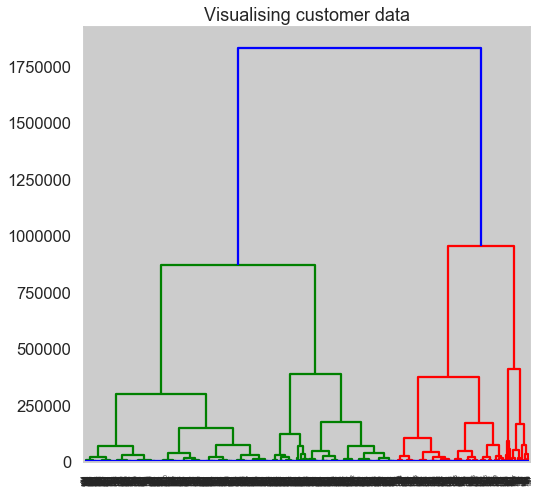

In [168]:

plt.figure(figsize =(8, 8))
plt.title('Visualising customer data')
Dendrogram = shc.dendrogram((shc.linkage(df, method ='ward')))
#Z = hierarchy.linkage(blob_array, method='single')
plt.axhline(y=2000, color='b', linestyle='-')
plt.show()


 Affinity = l1 , against linkage = single


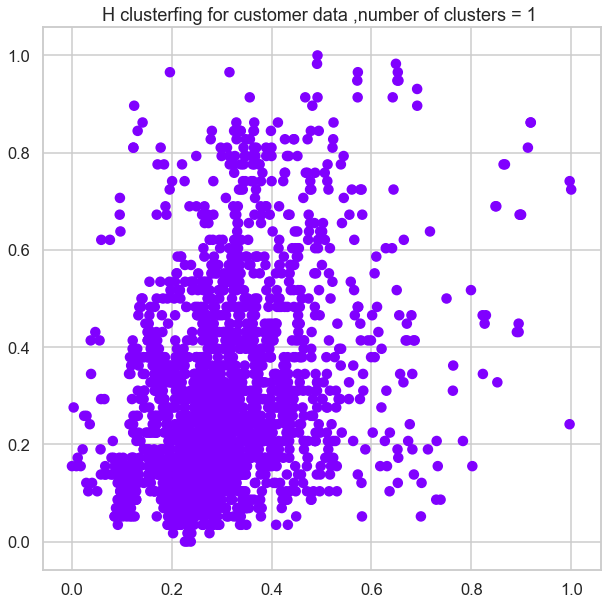

 Affinity = l1 , against linkage = average


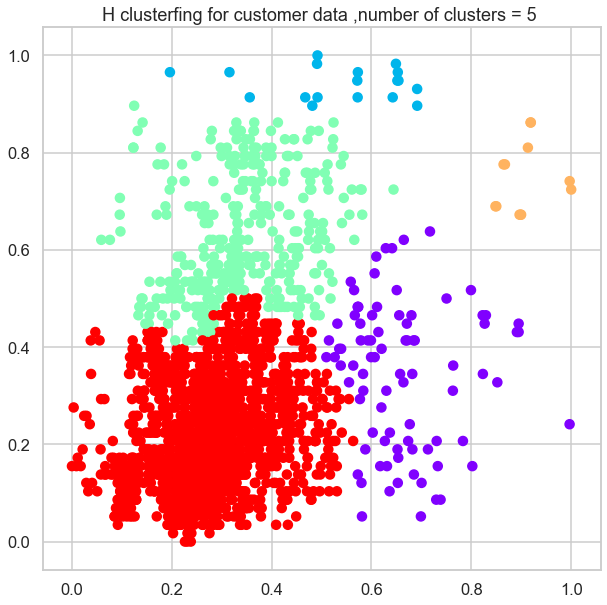

 Affinity = l2 , against linkage = single


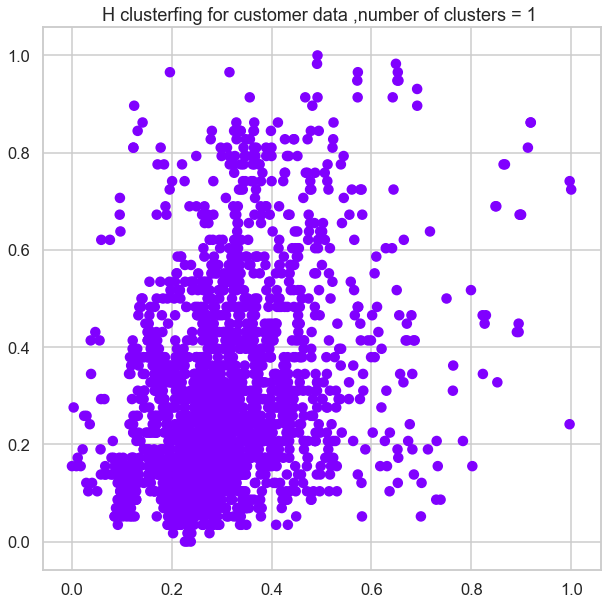

 Affinity = l2 , against linkage = average


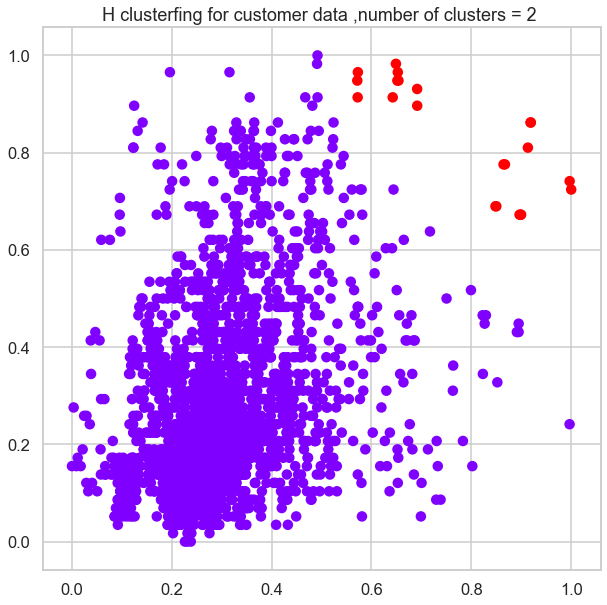

 Affinity = manhattan , against linkage = single


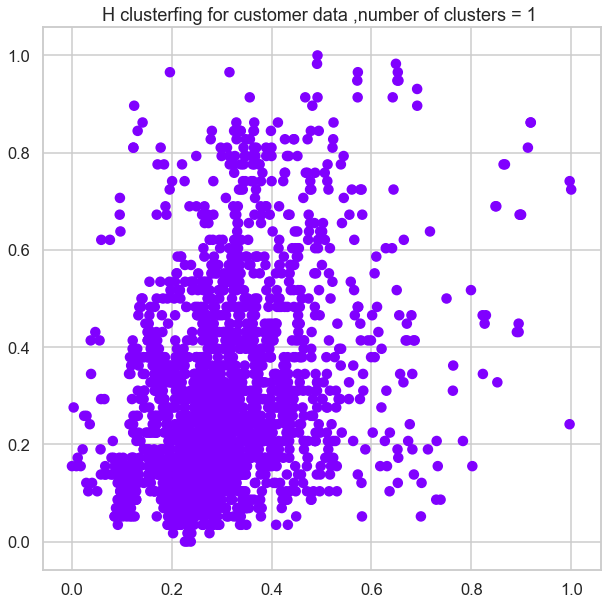

 Affinity = manhattan , against linkage = average


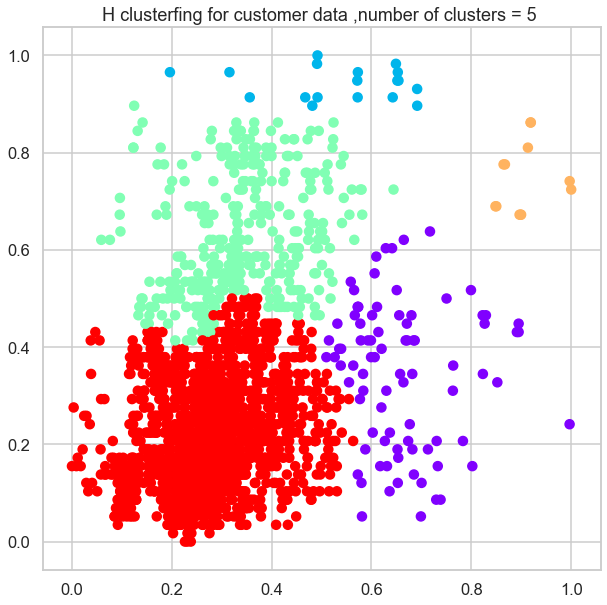

 Affinity = cosine , against linkage = single


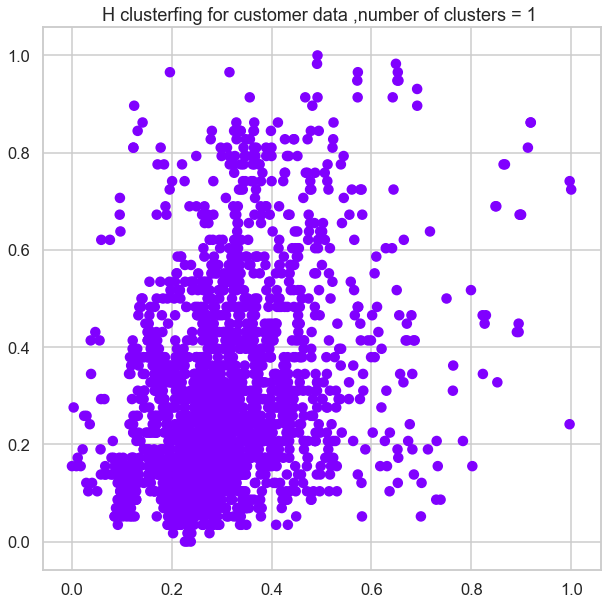

 Affinity = cosine , against linkage = average


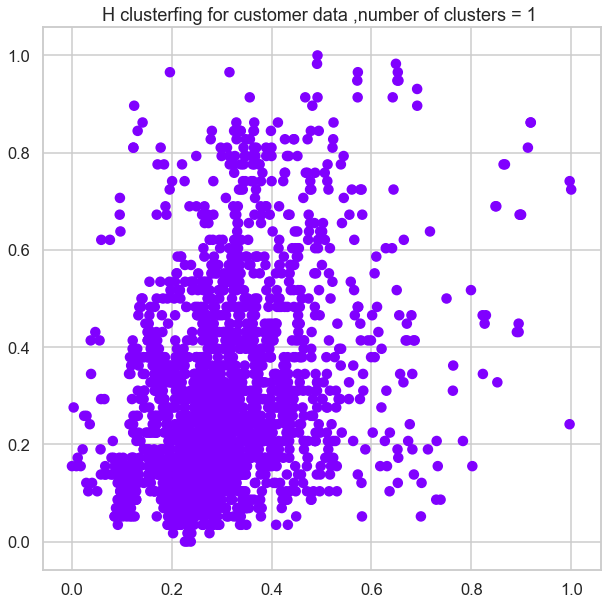

In [186]:
df = data.filter(['Income','Age'], axis=1)
df = scaler.fit_transform(df)
df = pd.DataFrame(df)



df = df.rename(columns={"Income":0, "Age":1})

for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df, "H clusterfing for customer data" )

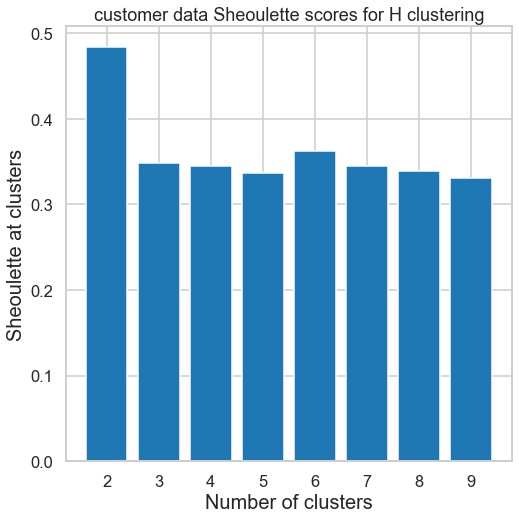

In [187]:

# calling
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("customer data Sheoulette scores for H clustering")
plt.show()

# Gaussian mixture for customer data set (non normalized)

lower bound: 1.027730513949242
full


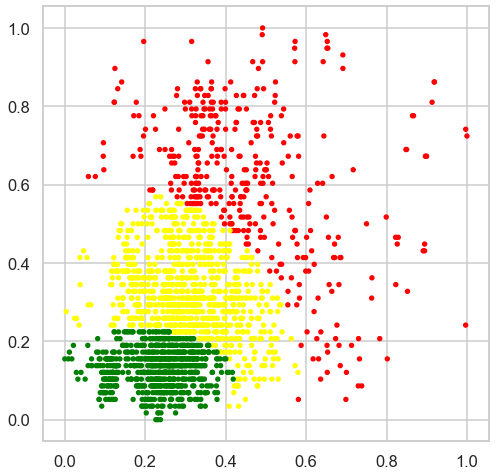

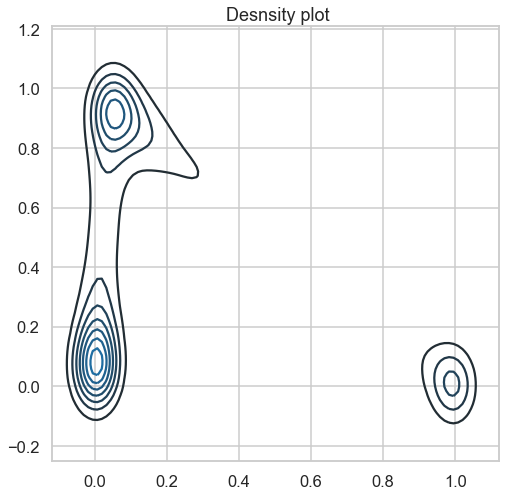

lower bound: 6.549502952146187
tied


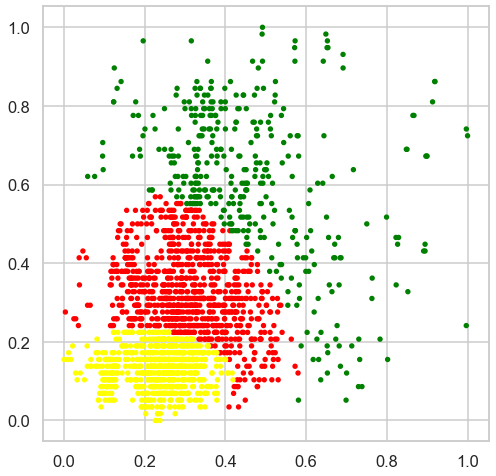

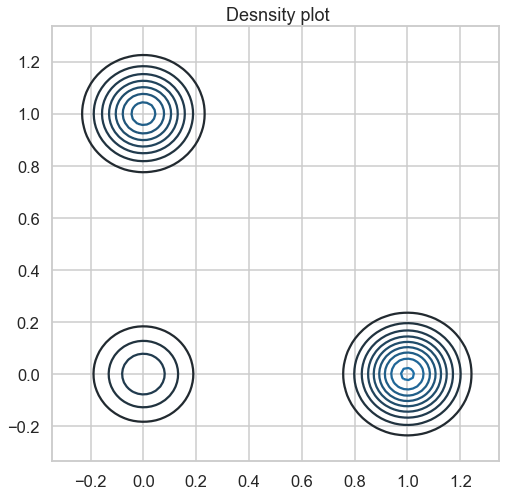

lower bound: 6.82945749946643
diag


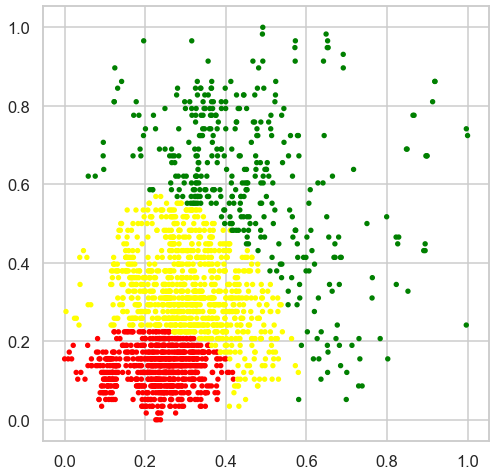

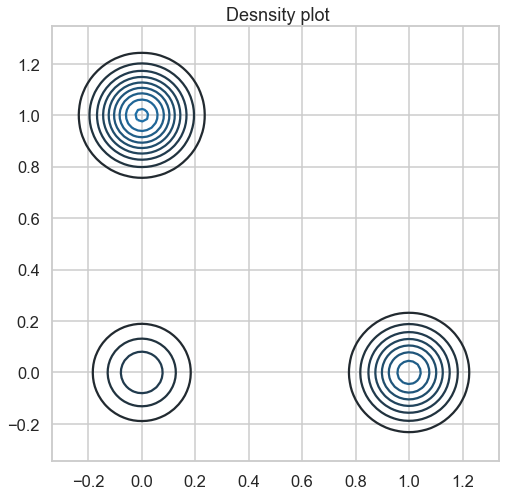

lower bound: 2.329312076567335
spherical


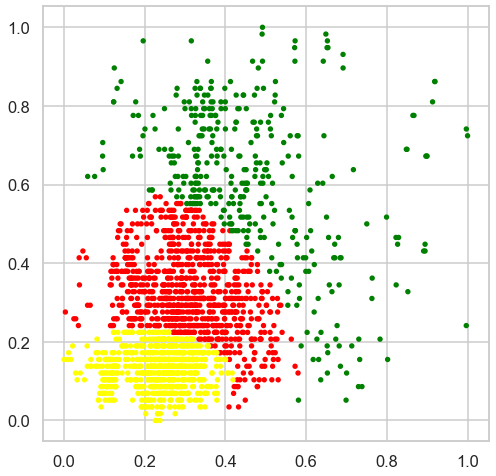

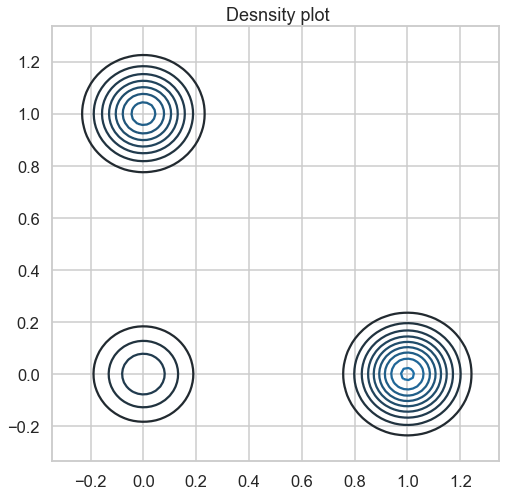

In [188]:
k = ["full", "tied", "diag", "spherical"]

for i in k:
    draw3(i, df)

# Normalizing customer data with min max scaler

In [194]:
df_mms = scaler.fit_transform(df)
df_mms = pd.DataFrame(df_mms)
df = data.filter(['Income','Age'], axis=1)



#df_mms = df_mms.rename(columns={"Income":0, "Age":1})


In [195]:
df_mms.head()

,0,1
0,0.324781,0.844828
1,0.420210,0.068966
2,0.195144,0.534483
3,0.496223,0.465517
4,0.413842,0.603448


In [201]:
df_mms_array = np.array(df_mms)
df_mms_array

array([[0.32478101, 0.84482759],
       [0.42021043, 0.06896552],
       [0.19514353, 0.53448276],
       ...,
       [0.18487051, 0.22413793],
       [0.22716172, 0.10344828],
       [0.11912317, 0.12068966]])

# K means after normalizing using min max scaler

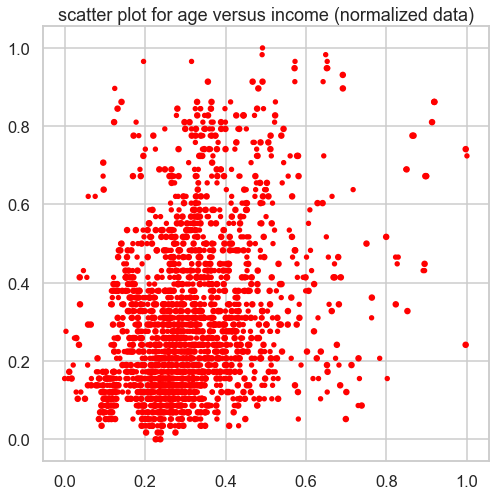

In [217]:
draw_scatter(df_mms, 0,1, "scatter plot for age versus income (normalized data)")

Text(0.5, 1.0, 'customer data (normalized )scatter plot for 6 clusters')

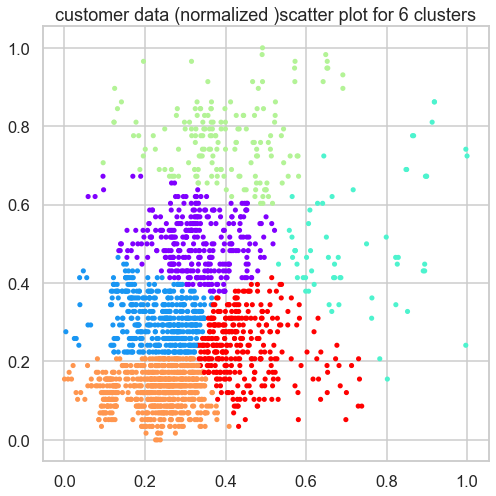

In [218]:
kmeans = KMeans(n_clusters= 6)
kmeans.fit(df_mms_array)
plt.scatter(df_mms_array[:,0],df_mms_array[:,1], c=kmeans.labels_, cmap='rainbow', s= [13,13])
plt.title("customer data (normalized )scatter plot for 6 clusters")

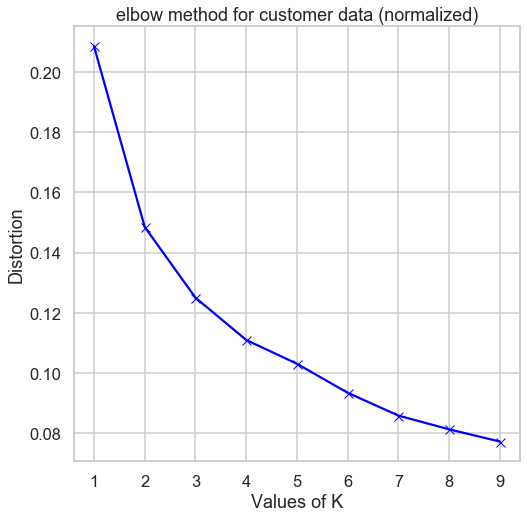

In [219]:
elbow_draw(df_mms_array, "elbow method for customer data (normalized)")

silhouette score (normalized) with clusters = 4
0.40229012381236295


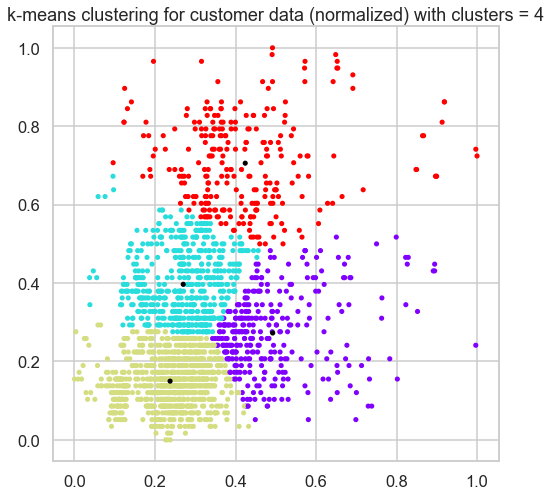

silhouette score (normalized) with clusters = 5
0.36002472700181465


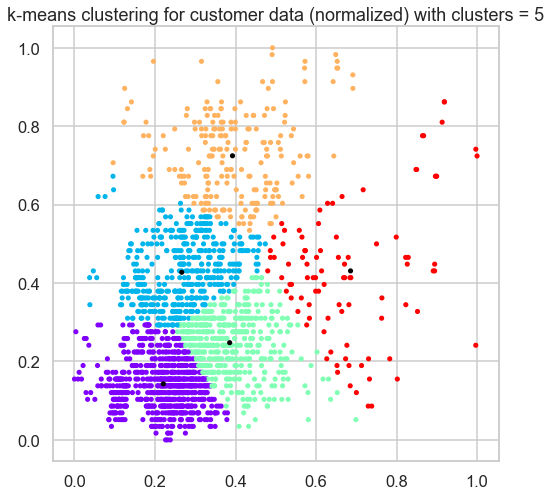

silhouette score (normalized) with clusters = 6
0.37528240675323854


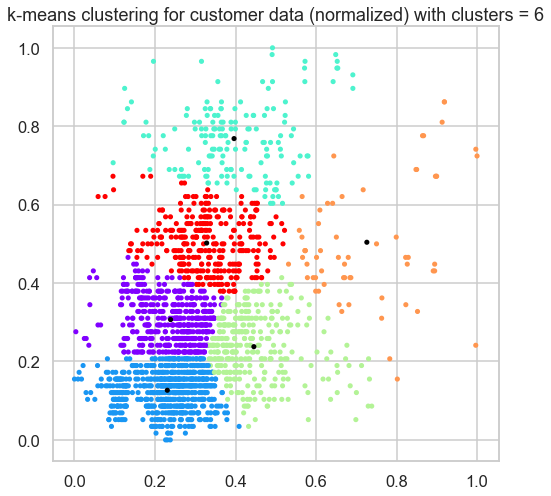

silhouette score (normalized) with clusters = 7
0.3547700932772775


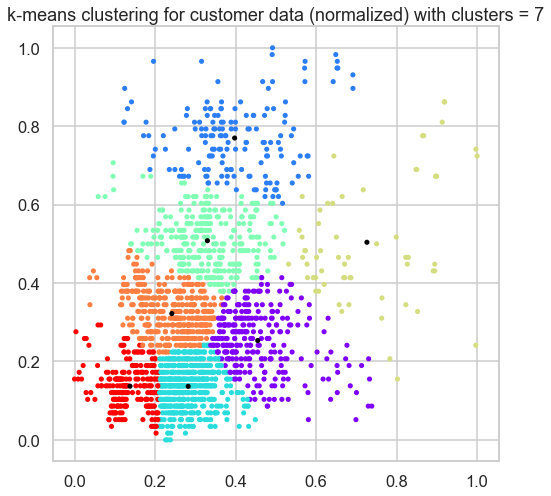

silhouette score (normalized) with clusters = 8
0.35260894987425445


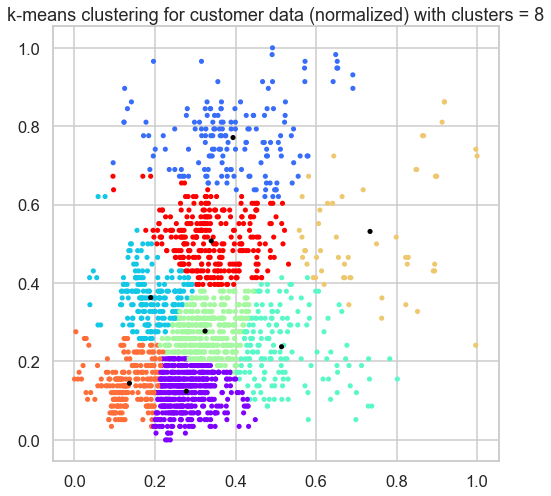

silhouette score (normalized) with clusters = 9
0.35009927360256404


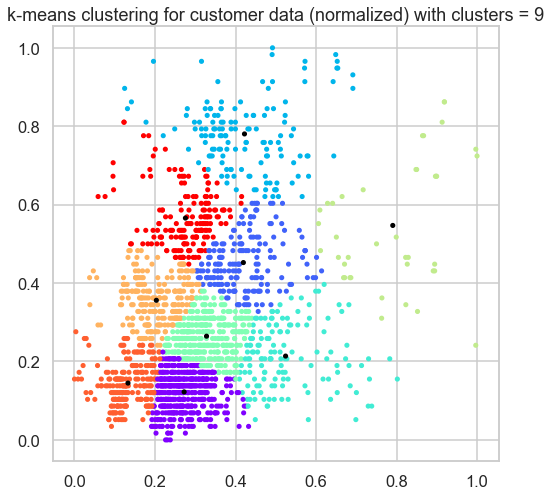

silhouette score (normalized) with clusters = 10
0.3518208756091251


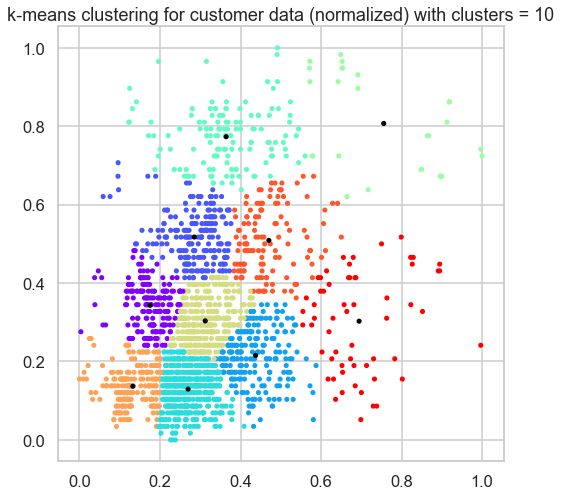

In [220]:
k_variants = [4,5,6,7,8,9,10]

for i in k_variants:
    
    draw_kmeans(i, df_mms_array, "k-means clustering for customer data (normalized) with clusters = {}".format(i),
                "silhouette score (normalized) with clusters = {}".format(i))


# DB Scan for customer data (normalized)

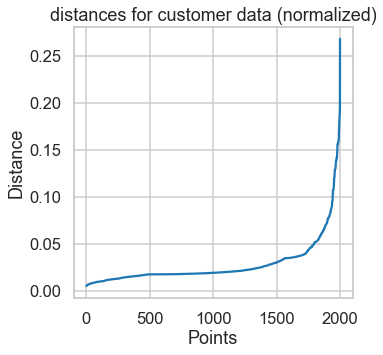

In [221]:
draw_dbscan_dist(df_mms_array, "distances for customer data (normalized)")
distances_df= distances

optimal eps: 0.04269007191496845


<Figure size 360x360 with 0 Axes>

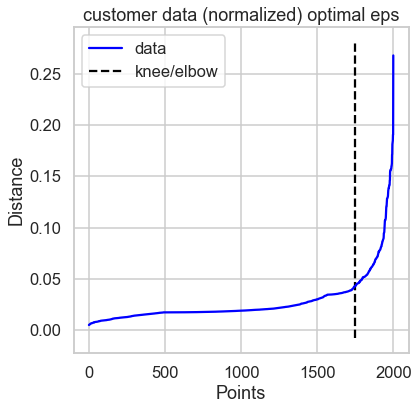

In [222]:
db_optimal_eps(distances_df, "customer data (normalized) optimal eps")

Estimated no. of clusters 1: 
Estimated no. of noise points: 409
total number of points: 4000 
effeciency : 89.775


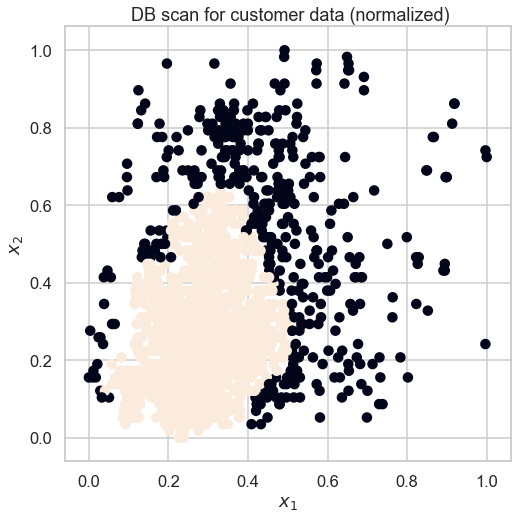

In [223]:
draw_dbscan(df_mms_array, " DB scan for customer data (normalized)", 0.04269007191496845, 25)

# Hierarchal Clustering for customer data set (normalized)

In [224]:



df = scaler.fit_transform(df_mms)
df = pd.DataFrame(df)



df = df.rename(columns={"Income":0, "Age":1})

 Affinity = l1 , against linkage = single


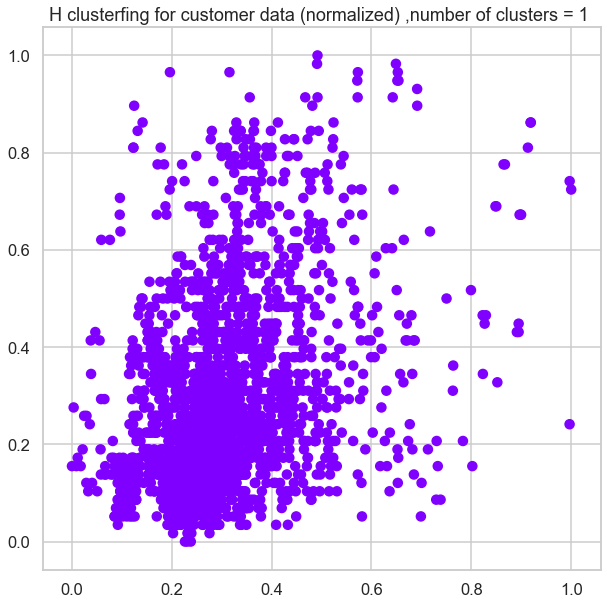

 Affinity = l1 , against linkage = average


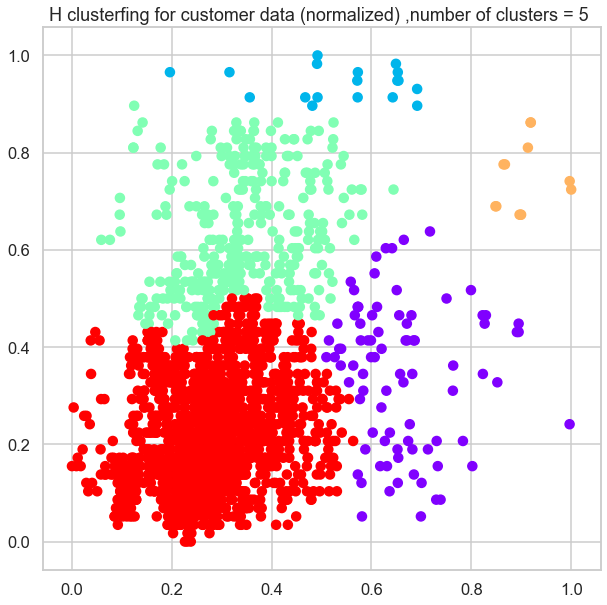

 Affinity = l2 , against linkage = single


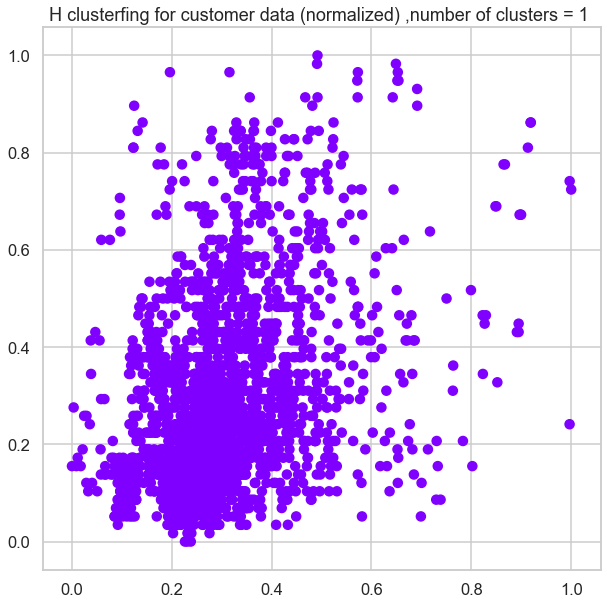

 Affinity = l2 , against linkage = average


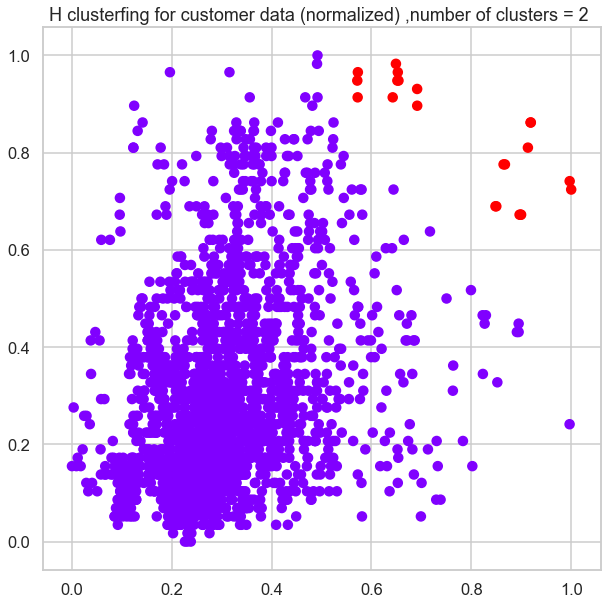

 Affinity = manhattan , against linkage = single


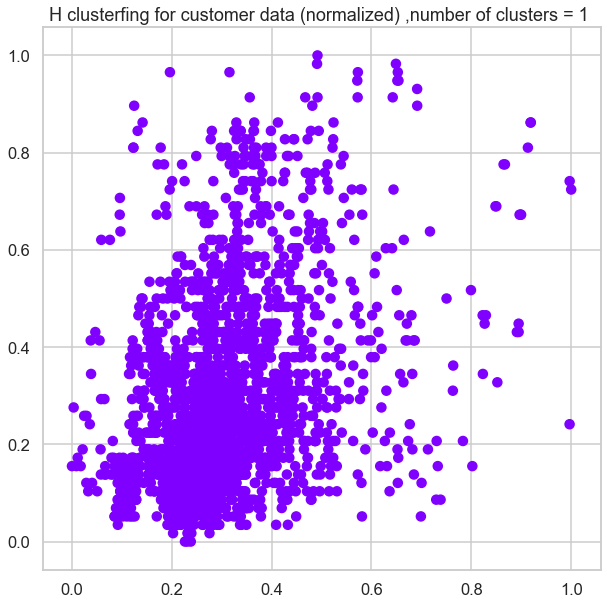

 Affinity = manhattan , against linkage = average


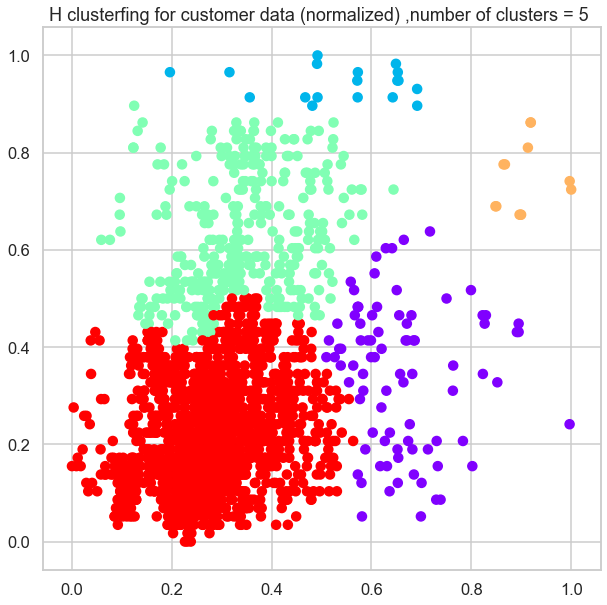

 Affinity = cosine , against linkage = single


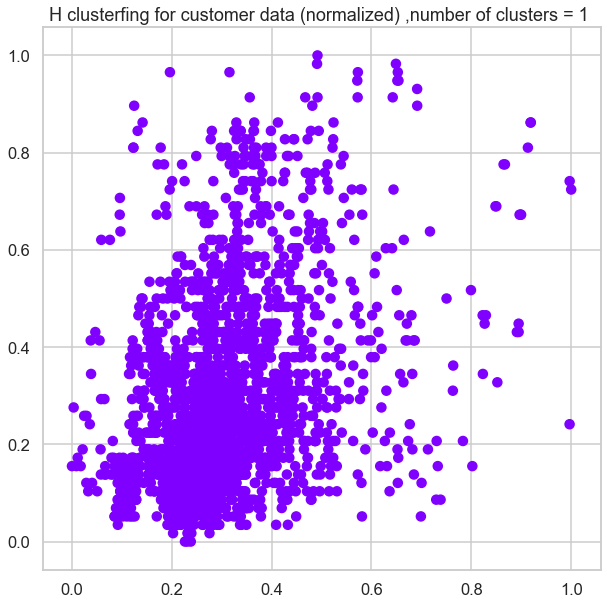

 Affinity = cosine , against linkage = average


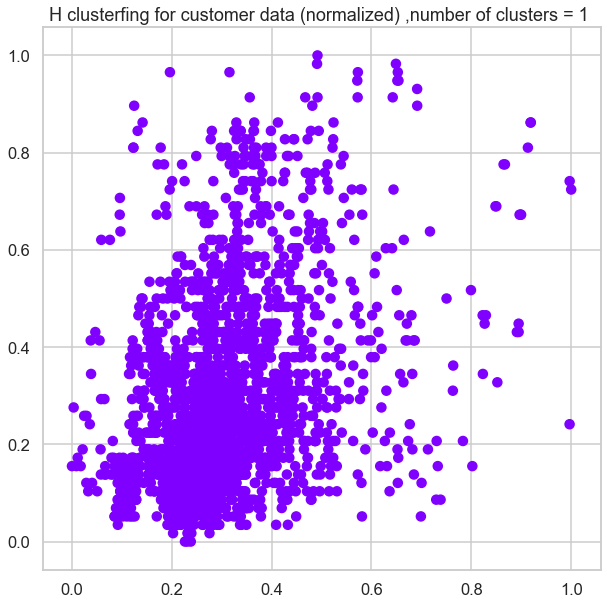

In [225]:

for i in arr_aff:
    for j in arr_link:
        draw_linkage_affinity(i,j, df, "H clusterfing for customer data (normalized)" )

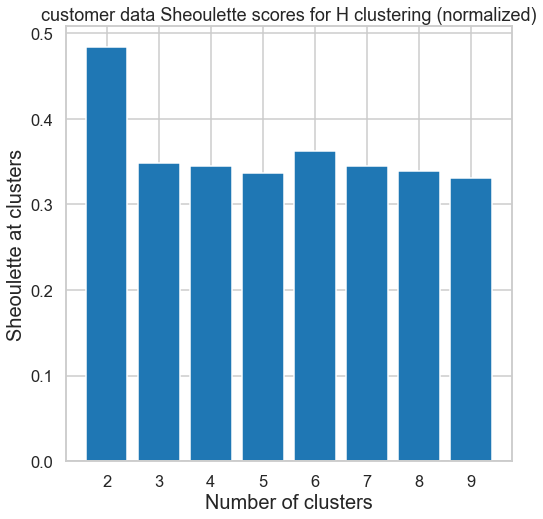

In [226]:
k = [2, 3, 4, 5, 6,7,8,9]
silhouette_scores = []

for i in k:
    draw_sh(i, df_mms)
plt.bar(k, silhouette_scores)
plt.xlabel('Number of clusters', fontsize = 20)
plt.ylabel('Sheoulette at clusters' , fontsize = 20)
plt.title("customer data Sheoulette scores for H clustering (normalized)")
plt.show()

# Gaussian mixture for customer data (normalized)

Text(0.5, 1.0, 'scatter, normalized')

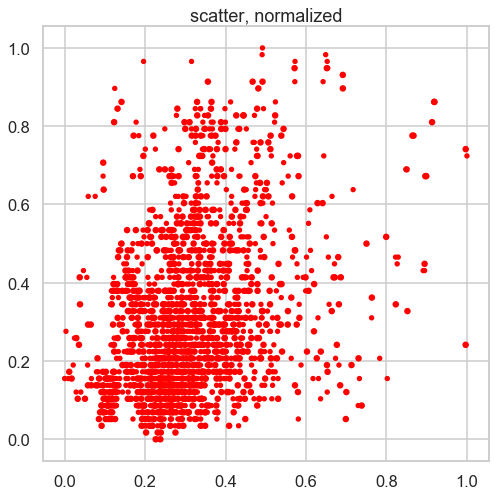

In [235]:
ax1 = plt.scatter(x=df_mms[0],y=df_mms[1], s= [15,25], c= 'red')
plt.title("scatter, normalized")

lower bound: 6.868502418083372
full


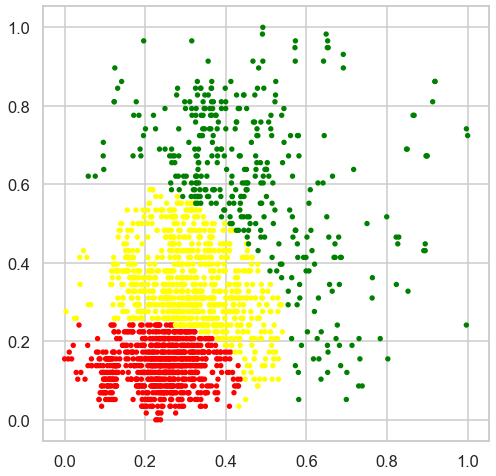

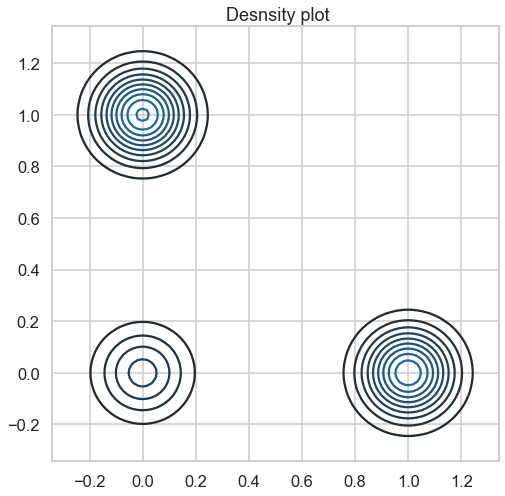

lower bound: 6.54960832899608
tied


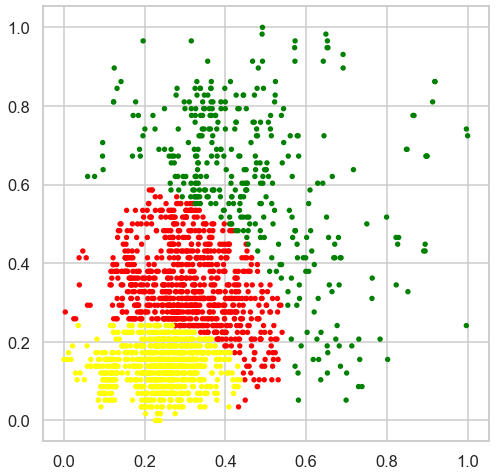

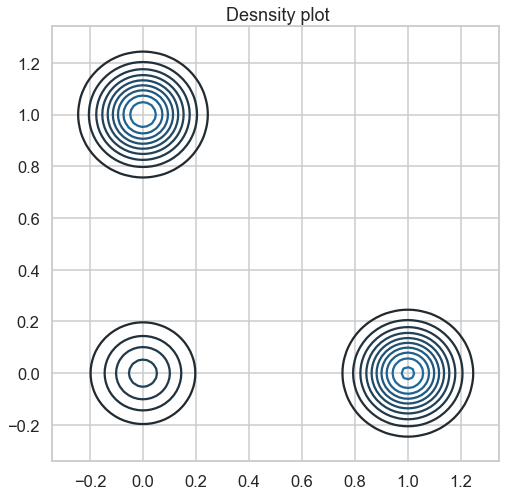

lower bound: 6.82487347606312
diag


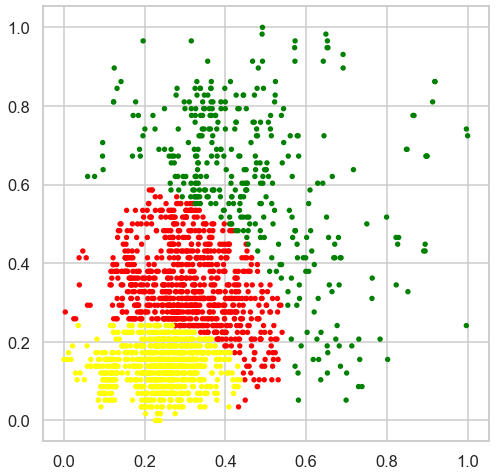

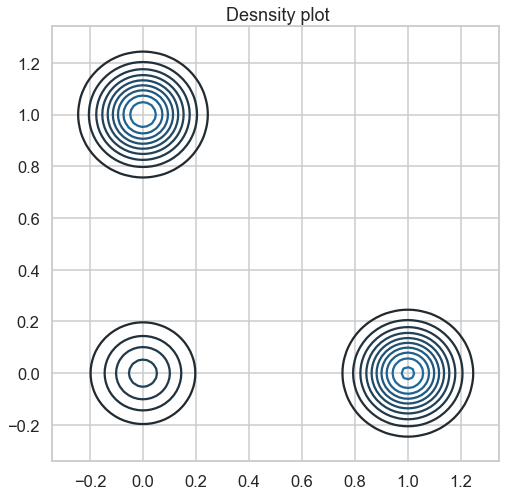

lower bound: 2.3270737816159373
spherical


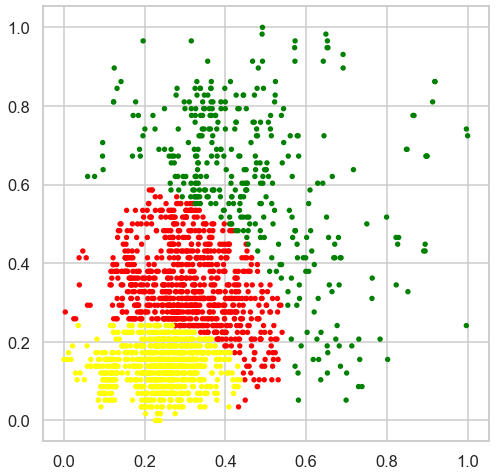

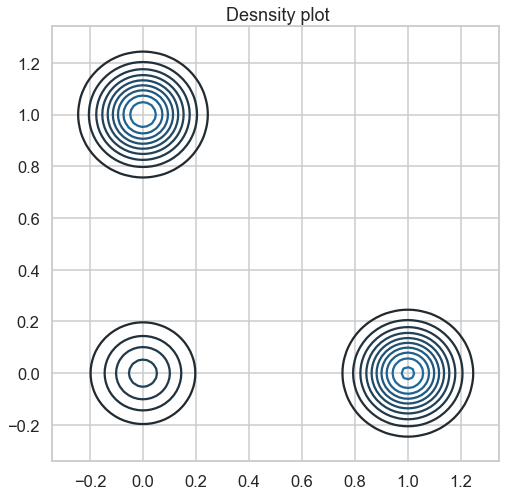

In [231]:
k = ["full", "tied", "diag", "spherical"]

for i in k:
    draw3(i, df_mms)